In [ ]:
# Carl et al. (in review): measurement script
# Copyright (C) 2025 Friedrich Carl
# This file is part of Carl et al. (in review).
#
# The code is free software: you can redistribute it and/or modify
# it under the terms of the GNU General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.
#
# The code is distributed in the hope that it will be useful,
# but WITHOUT ANY WARRANTY; without even the implied warranty of
# MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.  See the
# GNU General Public License for more details.
#
# You should have received a copy of the GNU General Public License
# along with MyProject.  If not, see  https://www.gnu.org/licenses/gpl-3.0.txt.


In [ ]:
"""This is the script to measure the lateral and vertical dimensions as well as gradient and curvature data of a regular 3D structure, as
described in Carl et al. (in review, 2025). For explanations on why certain steps in the code are being executed (that way), please refer to the paper.
Note that this is the code measuring regular 3D geometries. For the application to irregular structures, some adjustments are required (depending on the
input) that will be adressed in the follow-up study.
Please remember to change all paths/directories in this script according to your system"""

In [1]:
"""Loading data & creating initial cross sections parallel to longer horizontal axis of bounding box"""
import pyvista as pv
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import colormaps
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection
from shapely.geometry import LineString
import gempy as gp
import vtk

reader = vtk.vtkUnstructuredGridReader()
reader.SetFileName(r"C:\Users\carl\Desktop\Standardmodelle\sphere_model.vtk") #read .vtk input
reader.Update()

# Get the data from the VTK file
data = reader.GetOutput()

# Extract points and their associated data
points = data.GetPoints()
num_points = points.GetNumberOfPoints()
point_data = data.GetPointData()

# Create a list to store point coordinates and associated data
point_list = []

# Iterate through points and their data
for i in range(num_points):
    # Get point coordinates
    point = points.GetPoint(i)
    # Append point coordinates to the list
    point_list.append(list(point))

# Create a pandas DataFrame
columns = ['x', 'y', 'z']
df = pd.DataFrame(point_list, columns=columns)

# Save the DataFrame as a CSV file
df.to_csv(r"C:\Users\carl\Desktop\TUNB_as_csv\sphere_model.csv", index=False)
reader.Update()

mesh = pv.read(r"C:\Users\carl\Desktop\Standardmodelle\sphere_model.vtk")

# Create a regular bounding box around the irregular mesh
bounds = mesh.bounds
regular_box = pv.Box(bounds)
extents = mesh.bounds

# Print the extents
print("X Extent:", extents[0], "-", extents[1])
print("Y Extent:", extents[2], "-", extents[3])
print("Z Extent:", extents[4], "-", extents[5])

box_extents = regular_box.bounds

# Get the vertices of the bounding box
box_vertices = regular_box.points

# Calculate the minimum and maximum values of each axis (X, Y, and Z)
xmin = np.min(box_vertices[:, 0])
xmax = np.max(box_vertices[:, 0])
ymin = np.min(box_vertices[:, 1])
ymax = np.max(box_vertices[:, 1])
zmin = np.min(box_vertices[:, 2])
zmax = np.max(box_vertices[:, 2])

dx = xmax - xmin
dy = ymax - ymin
dz = zmax - zmin

#p0 at xmin, midy, midz; p1 at xmax, midy, midz
p0 = [xmin, ymin + dy/2, zmin + dz/2]
p1 = [xmax, ymin + dy/2, zmin + dz/2]


n_cuts = 22
# Automatically choose the plane normal of all cross sections and adjust the center_array calculation
if dx >= dy:
    plane_normal = [1, 0, 0]  # Perpendicular to the X-axis
    print("Plane normal is [1, 0, 0] (perpendicular to the X-axis).")
    # Distribute the centers along the Y axis
    center_array = np.ones((n_cuts, 3))
    center_array[:, 0] = np.linspace(xmin, xmax, n_cuts)  # Linearly spaced values for x-coordinates
    center_array[:, 1] = ymin + dy / 2  # Constant value for y-coordinates (midpoint of Y-axis)
    center_array[:, 2] = zmin + dz / 2  # Constant value for z-coordinates (midpoint of Z-axis)
else:
    plane_normal = [0, 1, 0]  # Perpendicular to the Y-axis
    print("Plane normal is [0, 1, 0] (perpendicular to the Y-axis).")
    # Distribute the centers along the X axis
    center_array = np.ones((n_cuts, 3))
    center_array[:, 0] = xmin + dx / 2  # Constant value for x-coordinates (midpoint of X-axis)
    center_array[:, 1] = np.linspace(ymin, ymax, n_cuts)  # Linearly spaced values for y-coordinates
    center_array[:, 2] = zmin + dz / 2  # Constant value for z-coordinates (midpoint of Z-axis)
center_array

"""-----------------------------------------------------initial parallel cross sections ---------------------------------------------------"""

sliced_meshes = []

# Initialize the plotter
plotter = pv.Plotter()

# Loop through each center in center_array
for i in range(len(center_array)):
    for g in np.arange(0,95,5):
        # Access the i-th entry in center_array
        cross_section_center = center_array[i]

        if dx >= dy:
            plane_normal = [1, 0, 0]  # Perpendicular to the X-axis
        else:
            plane_normal = [0, 1, 0]  # Perpendicular to the Y-axis
    
        # Calculate the origin of the slicing plane
        origin = cross_section_center
    
        # Define the slicing plane for the irregular mesh
        Section_dir1 = mesh.slice(normal=plane_normal, origin=cross_section_center)
        
    
    # Define the slicing plane for the regular bounding box
    bounds = mesh.bounds
    regular_box = pv.Box(bounds)
    boundbox = regular_box.slice(normal=plane_normal, origin=cross_section_center)
    
    # Check if the sliced mesh for the irregular mesh is not empty
    if Section_dir1.n_points > 0:
        # Add the sliced mesh to the plotter
        plotter.add_mesh(Section_dir1, color='red', opacity=0.5, name=f'Irregular Mesh {i}')  # Add the sections for the irregular input mesh
            
        # Append the sliced mesh to the list
        sliced_meshes.append(Section_dir1)
    
    """ in case you want to visualize the bounding box of the input mesh as well: uncomment below"""
    #if boundbox.n_points > 0:
        # Add the sliced mesh to the plotter
        #plotter.add_mesh(boundbox, color='blue', opacity=0.5, name=f'Regular Bounding Box {i}')  # Add the slice for the regular bounding box
        
# Show the plotter
plotter.show()

Setting Backend To: AvailableBackends.numpy
X Extent: -9.998740196228027 - 9.998740196228027
Y Extent: -9.998740196228027 - 9.998740196228027
Z Extent: -10.0 - 10.0
Plane normal is [1, 0, 0] (perpendicular to the X-axis).


Widget(value='<iframe src="http://localhost:55385/index.html?ui=P_0x1b0d1230b80_0&reconnect=auto" class="pyvis…

In [2]:
"""compute all rotation steps for all cross sections created before (5° intervals), to find the orientation of every 
cross section perpendicular to the longitudinal horizontal main axis (1st direction)"""
import pyvista as pv
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation as R
from sklearn.preprocessing import MinMaxScaler

#compute the centroid of a cross section
def centroid(points):
    x = [p[0] for p in points]
    y = [p[1] for p in points]
    centroid = (sum(x) / len(points), sum(y) / len(points))
    return centroid

#sort the points of a section by angle
def sort_points_by_angle(points, centroid):
    def angle(p):
        return np.arctan2(p[1] - centroid[1], p[0] - centroid[0])
    return sorted(points, key=angle)


# Normalize the vertices
def normalize_values(vertices):
    scaler = MinMaxScaler()
    normalized_vertices = scaler.fit_transform(vertices)
    return normalized_vertices


# Function to compute the area using the shoelace formula
def shoelace_area(vertices):
    n = len(vertices)
    area = 0.5 * abs(sum(vertices[i][0]*vertices[(i+1) % n][1] - vertices[i][1]*vertices[(i+1) % n][0] for i in range(n)))
    return area

#function to rotate & project a section parallel to the XY plane / rotate the normal parallel to the x axis
def rotate_to_x_axis(vertices, normal):
    normal = normal / np.linalg.norm(normal)  # Normalize the normal vector
    target = np.array([1, 0, 0])  # Target vector along the x-axis

    # Ensure normal is not aligned with the target vector to avoid zero rotation
    if np.allclose(normal, target) or np.allclose(normal, -target):
        return vertices, np.eye(3)  # No rotation needed if already aligned

    # Calculate the rotation needed to align the normal with the x-axis
    rotation_vector = np.cross(normal, target)
    rotation_vector /= np.linalg.norm(rotation_vector)  # Normalize the rotation vector
    angle = np.arccos(np.clip(np.dot(normal, target), -1.0, 1.0))
    
    K = np.array([
        [0, -rotation_vector[2], rotation_vector[1]],
        [rotation_vector[2], 0, -rotation_vector[0]],
        [-rotation_vector[1], rotation_vector[0], 0]
    ])
    rotation_matrix = np.eye(3) + np.sin(angle) * K + (1 - np.cos(angle)) * np.dot(K, K)

    if np.linalg.det(rotation_matrix) < 0:
        rotation_matrix[:, 1] = -rotation_matrix[:, 1]
        
    # Apply the rotation to the vertices
    rotated_vertices = vertices @ rotation_matrix.T 
    return rotated_vertices, rotation_matrix
    
#compute the center point of a cross section
def compute_center_point(vertices, plane_normal):
    if np.array_equal(plane_normal, [1, 0, 0]):
        # Compute mean in YZ plane, but return full 3D center (x remains the same)
        center = np.mean(vertices[:, 1:], axis=0)  # Mean of Y and Z coordinates
        return np.array([np.mean(vertices[:, 0]), center[0], center[1]])  # Add X back
    elif np.array_equal(plane_normal, [0, 1, 0]):
      #Compute mean in XZ plane, but return full 3D center (y remains the same)
        center = np.mean(vertices[:, [0, 2]], axis=0)  # Mean of X and Z coordinates
        return np.array([center[0], np.mean(vertices[:, 1]), center[1]])  # Add Y back
    else:
        raise ValueError("Unsupported plane normal")

# Initialize the plotter
plotter = pv.Plotter()

# Initialize a dictionary to store area values for each section
area_values = {i: [] for i in range(len(center_array))}

"""---------------------------------------------------compute rotation steps---------------------------------------------------"""
# Loop through each center in center_array
for i in range(len(center_array)):
    
    # Access the i-th entry in center_array
    cross_section_center = center_array[i]
    
    if dx >= dy:
        plane_normal = [1, 0, 0]  # Perpendicular to the X-axis
    else:
        plane_normal = [0, 1, 0]  # Perpendicular to the Y-axis

    # Define the initial slicing plane
    Section_dir1 = mesh.slice(normal=plane_normal, origin=cross_section_center)
    
    if Section_dir1.n_points > 0:
        # Add the initial sliced mesh to the plotter
        plotter.add_mesh(Section_dir1, color='red', opacity=0.5, name=f'Initial Section {i}')
        
        # Extract vertices of the slice mesh
        vertices = Section_dir1.points

        
        center_point = compute_center_point(vertices, plane_normal)
        
        # Initialize list to store rotated normal vectors
        rotated_normals = []

        # Loop to rotate the normal vector stepwise by 5°
        for g in range(38):  # 38 steps will give 0° to 180° rotation
            # Rotation angle in radians
            theta = np.radians(g * 5)
    
            # Rotation matrix about z-axis
            rotation_matrix = np.array([
                [np.cos(theta), np.sin(theta), 0],
                [-np.sin(theta), np.cos(theta), 0],
                [0, 0, 1]
                ])
           
    
            # Compute rotated normal vector
            rotated_n = np.dot(rotation_matrix, plane_normal)
 
            
            # Append rotated normal to list
            rotated_normals.append(rotated_n)
    
        # Loop through rotated normals
        for rotated_n in rotated_normals:

            rotated_section = mesh.slice(normal=rotated_n, origin=center_point)
            
            # Check if the sliced mesh for the irregular mesh is not empty
            if rotated_section.n_points > 0:
                # Add the rotated sliced mesh to the plotter
                plotter.add_mesh(rotated_section, color='blue', opacity=0.5, name=f'Irregular Mesh {i} - Rotation {int(np.degrees(np.arccos(rotated_n[0])))}°')
                
                # Extract vertices of the rotated slice mesh
                rotated_vertices = rotated_section.points

                #project the cross section into the YZ plane for area calculation
                vertices_centered = rotated_vertices - center_point
                rotated_vertices, rotation_matrix = rotate_to_x_axis(vertices_centered, rotated_n)
                rotated_vertices += center_point
                
                # Convert vertices to the required format for area calculation (YZ-plane)
                yz_projection = rotated_vertices[:, 1:3]
                
                
                points = yz_projection

                # Find centroid
                cnt = centroid(points)
                
                # Sort points by angle
                sorted_points = sort_points_by_angle(points, cnt)
                
                # Calculate area
                area = shoelace_area(sorted_points)
                
                # Store the area value
                area_values[i].append(area)

# Show the plotter
plotter.show()

# Access and print the area values for each center
for center_index, areas in area_values.items():
    print(f"Center {center_index}: {areas}")
    print()  # blank line after each center's areas


Widget(value='<iframe src="http://localhost:55385/index.html?ui=P_0x1b0f7d23e50_1&reconnect=auto" class="pyvis…

Center 0: []

Center 1: [56.82975822687149, 58.75415185501147, 64.56669902261417, 74.04645994281724, 86.90424347090314, 102.73559246715496, 121.11772240381286, 141.42877146288998, 163.07305866541535, 185.40447122079166, 207.750638702081, 229.39203334261416, 249.7113177361733, 268.05483754981003, 283.9081693971634, 296.78366061800386, 306.2435620007551, 312.06401680689925, 314.1065505527027, 312.0640190484302, 306.243567546202, 296.783670240847, 283.9081832934449, 268.0548547915417, 249.71133134970873, 229.392048200156, 207.7506501035925, 185.40448416421546, 163.07307175593388, 141.4287834866153, 121.11773508470226, 102.73560396001288, 86.90425816846745, 74.04647227303674, 64.56670776609873, 58.75415733165168, 56.82975822687149, 58.754151855011465]

Center 2: [108.12235337495804, 109.66338289295679, 114.32149257739495, 121.89347726137831, 132.18223621406892, 144.8850062554241, 159.5882916647367, 175.84877593405795, 193.18086652434482, 211.04664128597656, 228.9369217580751, 246.267700539

In [3]:
"""determining & saving the orientation of 1st direction for every cross section"""
import json

min_area_steps = {}

#rotation showing the minimum area for every cross section = 0° rotation in regular structures
def calculate_min_steps():
    # Loop through each center in area_values dictionary
    for center_index, areas in area_values.items():
        
        # Find the area value for 0° rotation (index 0 in the areas list)
        if areas:  # Ensure that there are areas recorded for this center
            min_area_value = areas[0]  # This is the area at 0° rotation
            min_area_steps[center_index] = 0  # Step is 0° since we are not rotating
        else:
            min_area_steps[center_index] = None  # No area recorded for this center

def get_min_steps():
    # Ensure the calculate_min_steps function is called before returning the results
    calculate_min_steps()
    return min_area_steps

# Now call the get_min_steps to populate and retrieve the min_area_steps
min_steps = get_min_steps()

# Save min_steps to a JSON file
with open('min_steps.json', 'w') as f:
    json.dump(min_steps, f)

# Print the rotation step with the smallest area value for each center
for center_index, min_step in min_steps.items():
    if min_step is not None:
        print(f"Smallest area for center {center_index} at rotation step {min_step}°: {area_values[center_index][min_step//5]}")
    else:
        print(f"No area value greater than 0 found for center {center_index}")


No area value greater than 0 found for center 0
Smallest area for center 1 at rotation step 0°: 56.82975822687149
Smallest area for center 2 at rotation step 0°: 108.12235337495804
Smallest area for center 3 at rotation step 0°: 153.70742197334766
Smallest area for center 4 at rotation step 0°: 193.60127570480108
Smallest area for center 5 at rotation step 0°: 227.80766546726227
Smallest area for center 6 at rotation step 0°: 256.3045769408345
Smallest area for center 7 at rotation step 0°: 279.0791765451431
Smallest area for center 8 at rotation step 0°: 296.21051251888275
Smallest area for center 9 at rotation step 0°: 307.57012712955475
Smallest area for center 10 at rotation step 0°: 313.305945456028
Smallest area for center 11 at rotation step 0°: 313.305945456028
Smallest area for center 12 at rotation step 0°: 307.57012712955475
Smallest area for center 13 at rotation step 0°: 296.21051251888275
Smallest area for center 14 at rotation step 0°: 279.0791765451431
Smallest area for

In [4]:
"""convert cross sections of 1st direction prior to artifact correction into shapely.linestring objects"""
import pyvista as pv
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation as R
from sklearn.preprocessing import MinMaxScaler
import matplotlib.cm as cm
from shapely.geometry import LineString
import json

# Load min_steps from the JSON file
with open('min_steps.json', 'r') as f:
    min_steps = json.load(f)
min_steps = {int(k): v for k, v in min_steps.items()}
if 0 not in min_steps:
    min_steps[0] = 0 


def centroid(points):
    if len(points) <= 1:
        raise ValueError("Cannot compute centroid with 1 or fewer points.")
    
    x = [p[0] for p in points]
    y = [p[1] for p in points]
    centroid = (sum(x) / len(points), sum(y) / len(points))
    return centroid

            
def sort_points_by_angle(points, centroid):
    def angle(p):
        return np.arctan2(p[1] - centroid[1], p[0] - centroid[0])
    return sorted(points, key=angle)

# Function to compute the area using the shoelace formula
def shoelace_area(vertices):
    n = len(vertices)
    area = 0.5 * abs(sum(vertices[i][0]*vertices[(i+1) % n][1] - vertices[i][1]*vertices[(i+1) % n][0] for i in range(n)))
    return area

# Normalize the vertices
def normalize_values(vertices):
    scaler = MinMaxScaler()
    normalized_vertices = scaler.fit_transform(vertices)
    return normalized_vertices


# Initialize the plotter
plotter = pv.Plotter()

# Create a colormap for different centers
num_centers = len(center_array)
colormap = cm.get_cmap('viridis', num_centers)

center_points = []
linestrings = {}


# First pass: compute unique center points for each cross section
for idx, cross_section_center in enumerate(center_array):
    if dx >= dy:
        plane_normal = [1, 0, 0]  # Perpendicular to the X-axis
    else:
        plane_normal = [0, 1, 0]  # Perpendicular to the Y-axis

    rotated_section = mesh.slice(normal=plane_normal, origin=cross_section_center)
    
    # Extract vertices of the rotated slice mesh
    initial_vertices = rotated_section.points
    
    # Calculate the center point (geometric center) of the vertices
    center_point_i = compute_center_point(initial_vertices, plane_normal)
    center_points.append(center_point_i)

center_points = np.array(center_points)

# Initialize a dictionary to store area values and minimal steps for each section
min_areas = {i: float('inf') for i in range(len(center_array))}
area_values = {i: [] for i in range(len(center_array))}


# Initialize dictionaries to store the results
min_area_dict = {}
rotated_normals_dict = {}
rotated_norms = []
rotated_norms_dict = {} 

# Populate dictionary after computing areas for each min step
for i in range(len(center_points)):

    if i == 21:
        print(f"Skipping computation for index {i}.")
        continue
    
    if min_area_steps[i] is not None:
        min_area_dict[i] = min_areas[i]  # Store in the min_area_dict

with open('min_area_dict.json', 'w') as f:
    json.dump(min_area_dict, f)

#computing and saving rotated normals for later use    
for i in range(len(center_points)):
    
    # Access the i-th entry in center_points
    center_point = center_points[i]
    
    if dx >= dy:
        plane_normal = [1, 0, 0]  # Perpendicular to the X-axis
    else:
        plane_normal = [0, 1, 0]  # Perpendicular to the Y-axis
    
    # Define the initial slicing plane
    Section_dir1 = mesh.slice(normal=plane_normal, origin=center_point)
    
    if Section_dir1.n_points > 0:
        
        # Extract vertices of the sliced mesh
        vertices = Section_dir1.points
        
        # Initialize list to store rotated normal vectors
        rotated_normals = []

        # Loop to rotate the normal vector stepwise by 5° (up to 180°)
        for g in range(38):  # 38 steps will give 0° to 180° rotation
            # Rotation angle in radians
            theta = np.radians(g * 5)
    
            # Rotation matrix about z-axis
            rotation_matrix = np.array([
                [np.cos(theta), np.sin(theta), 0],
                [-np.sin(theta), np.cos(theta), 0],
                [0, 0, 1]
            ])
           
            # Compute rotated normal vector
            rotated_n = np.dot(rotation_matrix, plane_normal)
            
            # Append rotated normal to list
            rotated_normals.append(rotated_n.tolist())

        rotated_normals_dict[f'rotated_n_{i}'] = rotated_normals

# Save the rotated normals dictionary to a JSON file
with open('rotated_normals.json', 'w') as f:
    json.dump(rotated_normals_dict, f)

#once again computing cross sections to then convert them into shapely.linestring objects
for i in range(len(center_points)):
    if min_area_steps[i] is not None:
        # Get the minimal rotation step and area
        min_step = min_area_steps[i]
        min_area = min_areas[i]
        
        if dx >= dy:
            plane_normal = [1, 0, 0]  # Perpendicular to the X-axis
        else:
            plane_normal = [0, 1, 0]  # Perpendicular to the Y-axis
        
        # Rotation matrix for the minimal step
        theta = np.radians(min_step)
        rotation_matrix = np.array([
            [np.cos(theta), np.sin(theta), 0],
            [-np.sin(theta), np.cos(theta), 0],
            [0, 0, 1]
        ])
        
        # Compute the rotated normal vector
        rotated_norm = np.dot(rotation_matrix, plane_normal)

        rotated_norms.append(rotated_norm.tolist())
        rotated_norms_dict[f'rotated_n_{i}'] = rotated_norm.tolist() 

        
        # Define the slicing plane for the rotated normal using the center point
        rotated_section = mesh.slice(normal=rotated_norm, origin=center_points[i])
        
        # Extract vertices of the rotated sliced mesh
        initial_vertices = rotated_section.points

        

        """Implementation of special case where min_step == 0 / 90; these following special cases are for visualization purposes later on,  if 
        a section is orthogonal to one of the horizontal axes of the initial bounding box"""
        if dx < dy:
            if min_step == 0:
                if len(initial_vertices) > 1:
                    try:
                        # Use the first and third columns (X and Z) when min_step is 0
                        cnt = centroid(initial_vertices[:, [0, 2]])
                        sorted_points = sort_points_by_angle(initial_vertices[:, [0, 2]], cnt)
                        area = shoelace_area(sorted_points)
                    except ValueError as e:
                        print(f"Skipping computation due to error: {e}")
                else:
                    print("Skipping centroid and area calculation due to insufficient points.")
                
                if len(initial_vertices) > 1:
                    line_string = LineString(initial_vertices)
                    linestrings[i] = LineString(initial_vertices)
                else:
                    print(f"Skipping LineString for section {i} due to insufficient points.")
    
                # Append the area and update min_area and min_step
                area_values[i].append(area)
                if area < min_areas[i]:
                    min_areas[i] = area
                    min_steps[i] = min_step

    
            # For min_step != 0, proceeding with the default YZ plane 
            else:
                if len(initial_vertices) > 1:
                    try:
                        cnt = centroid(initial_vertices[:, 1:3])
                        sorted_points = sort_points_by_angle(initial_vertices[:, 1:3], cnt)
                        area = shoelace_area(sorted_points)
                    except ValueError as e:
                        print(f"Skipping computation due to error: {e}")
                else:
                    print("Skipping centroid and area calculation due to insufficient points.")
                
                if len(initial_vertices) > 1:
                    line_string = LineString(initial_vertices)
                    linestrings[i] = LineString(initial_vertices)
                else:
                    print(f"Skipping LineString for section {i} due to insufficient points.")
    
                # Append the area and update min_area and min_step
                area_values[i].append(area)
                if area < min_areas[i]:
                    min_areas[i] = area
                    min_steps[i] = min_step
           
                
        # for dx >= dy, the exception is if the section is rotated by 90°
        elif dx >= dy:
            if min_step == 90:
                if len(initial_vertices) > 1:
                    try:
                        # Use the first and third columns (X and Z) when min_step is 0
                        cnt = centroid(initial_vertices[:, [0, 2]])
                        sorted_points = sort_points_by_angle(initial_vertices[:, [0, 2]], cnt)
                        area = shoelace_area(sorted_points)
                    except ValueError as e:
                        print(f"Skipping computation due to error: {e}")
                else:
                    print("Skipping centroid and area calculation due to insufficient points.")
        
                if len(initial_vertices) > 1:
                    line_string = LineString(initial_vertices)
                    linestrings[i] = LineString(initial_vertices)
                else:
                    print(f"Skipping LineString for section {i} due to insufficient points.")
        
                # Append the area and update min_area and min_step
                area_values[i].append(area)
                if area < min_areas[i]:
                    min_areas[i] = area
                    min_steps[i] = min_step

            # For min_step != 0, proceed with the default YZ plane 
            else:
                if len(initial_vertices) > 1:
                    try:
                        cnt = centroid(initial_vertices[:, 1:3])
                        sorted_points = sort_points_by_angle(initial_vertices[:, 1:3], cnt)
                        area = shoelace_area(sorted_points)
                    except ValueError as e:
                        print(f"Skipping computation due to error: {e}")
                else:
                    print("Skipping centroid and area calculation due to insufficient points.")
                
                if len(initial_vertices) > 1:
                    line_string = LineString(initial_vertices)
                    linestrings[i] = LineString(initial_vertices)
                else:
                    print(f"Skipping LineString for section {i} due to insufficient points.")
    
                # Append the area and update min_area and min_step
                area_values[i].append(area)
                if area < min_areas[i]:
                    min_areas[i] = area
                    min_steps[i] = min_step


# Save the rotated normals dictionary to a JSON file
with open('rotated_norms.json', 'w') as f:
    json.dump(rotated_norms_dict, f)

            

Skipping computation for index 21.


C:\Users\carl\AppData\Local\Temp\ipykernel_19040\1244508579.py:52: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = cm.get_cmap('viridis', num_centers)
C:\Users\carl\AppData\Local\anaconda3\envs\gempy3_new\lib\site-packages\numpy\core\fromnumeric.py:3502: RuntimeWarning: Mean of empty slice.
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
C:\Users\carl\AppData\Local\anaconda3\envs\gempy3_new\lib\site-packages\numpy\core\_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
C:\Users\carl\AppData\Local\anaconda3\envs\gempy3_new\lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


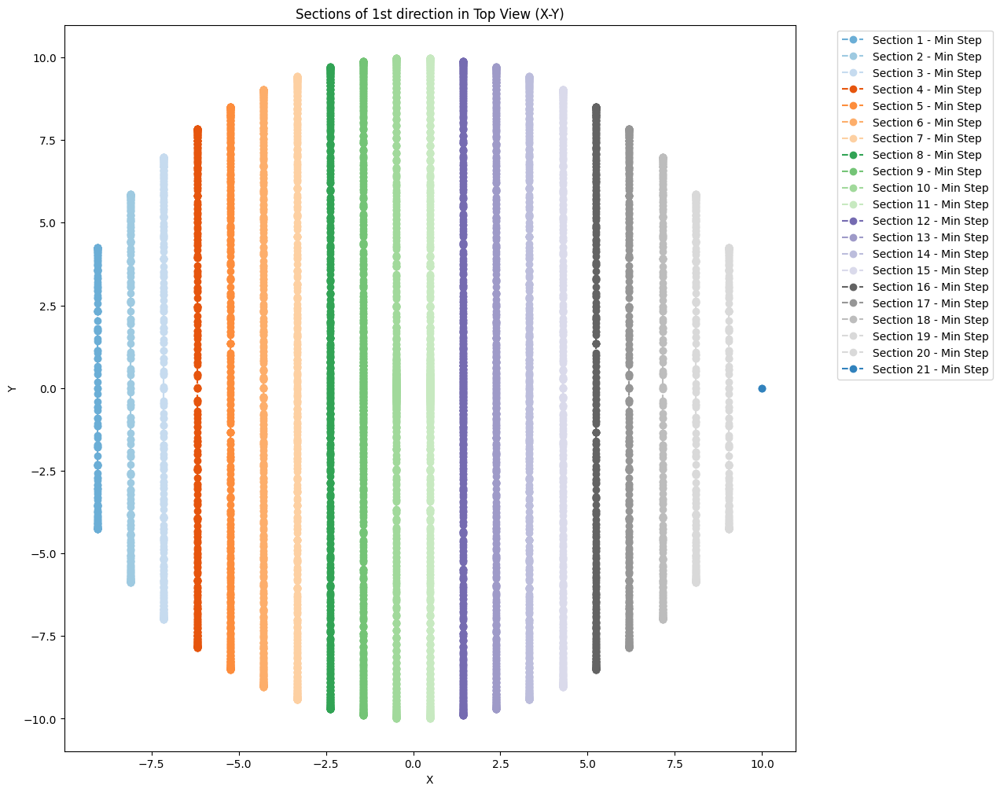

In [5]:
""" Optional: 2D visualization of cross sections (1st direction) in top view)"""
import matplotlib.pyplot as plt
import numpy as np
import pyvista as pv

# Initialize the plot
plt.figure(figsize=(12, 12))

# Create a colormap with 21 distinct colors
colors = plt.cm.tab20c(np.linspace(0, 1, 21))

# Plot all minimal steps (sections of 1st direction) in X-Y plane
for i in range(len(center_points)):
    if min_area_steps[i] is not None:
        # Get the minimal rotation step and area
        min_step = min_area_steps[i]

        if dx >= dy:
            plane_normal = [1, 0, 0]  # Perpendicular to the X-axis
        else:
            plane_normal = [0, 1, 0]  # Perpendicular to the Y-axis

        # Rotation matrix for the minimal step
        theta = np.radians(min_step)
        rotation_matrix = np.array([
            [np.cos(theta), np.sin(theta), 0],
            [-np.sin(theta), np.cos(theta), 0],
            [0, 0, 1]
        ])

        # Compute the rotated normal vector
        rotated_n = np.dot(rotation_matrix, plane_normal)

        # Define the slicing plane for the rotated normal using the center point
        rotated_section = mesh.slice(normal=rotated_n, origin=center_points[i])

        # Extract vertices of the rotated slice mesh
        rotated_vertices = rotated_section.points


        x_rotated = rotated_vertices[:, 0]
        y_rotated = rotated_vertices[:, 1]


        # Plot the 2D projection in X-Y plane (Section_dir1)
        
        plt.plot(x_rotated, y_rotated, 'o', color=colors[i % len(colors)], linestyle='--', label=f'Section {i} - Min Step')


# Set labels and title
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Sections of 1st direction in Top View (X-Y)')

# Add legend
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.show()


Center 1: min_step = 0


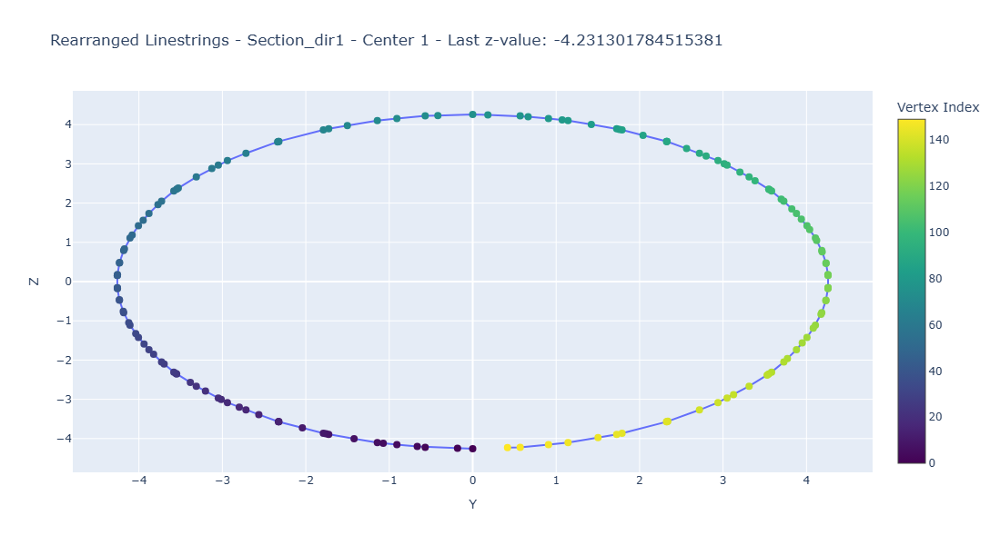

Center 2: min_step = 0


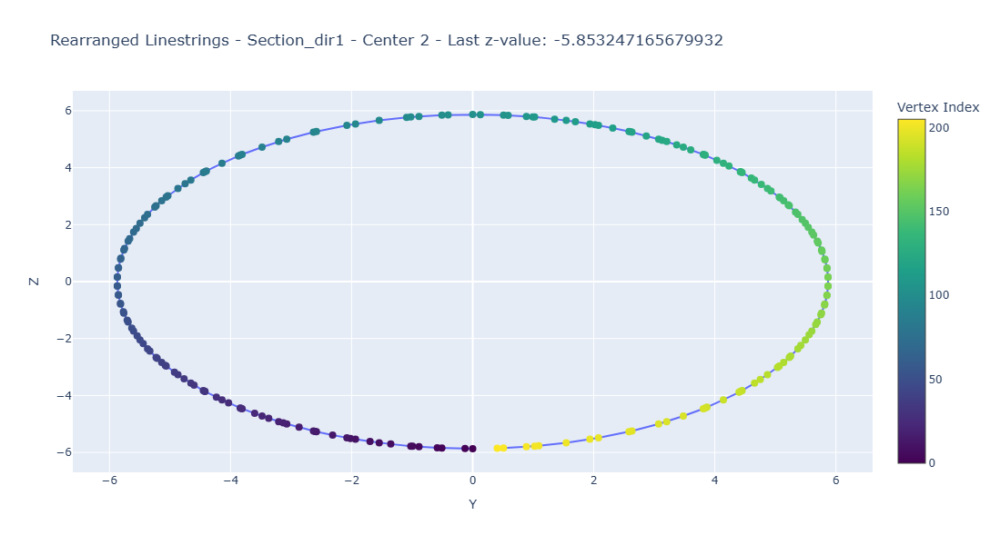

Center 3: min_step = 0


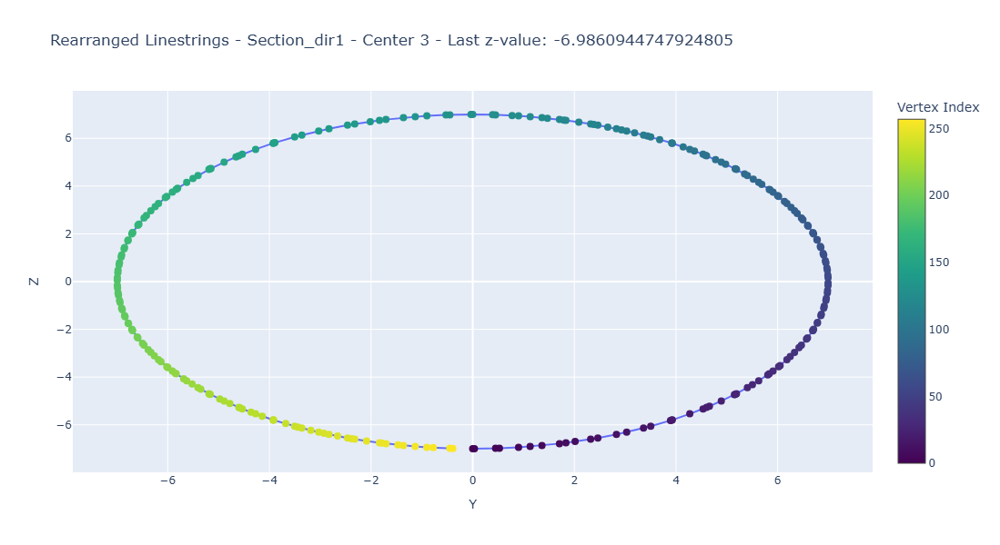

Center 4: min_step = 0


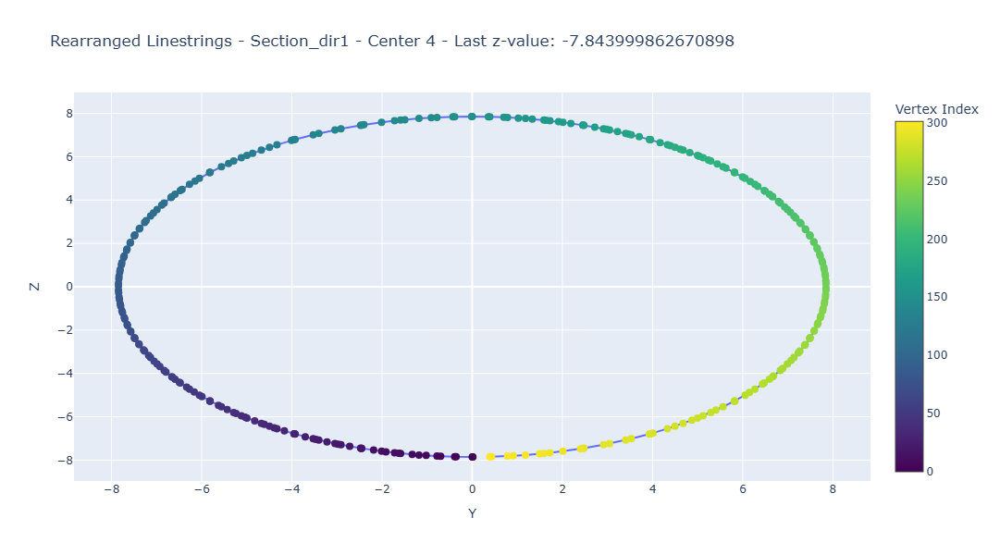

Center 5: min_step = 0


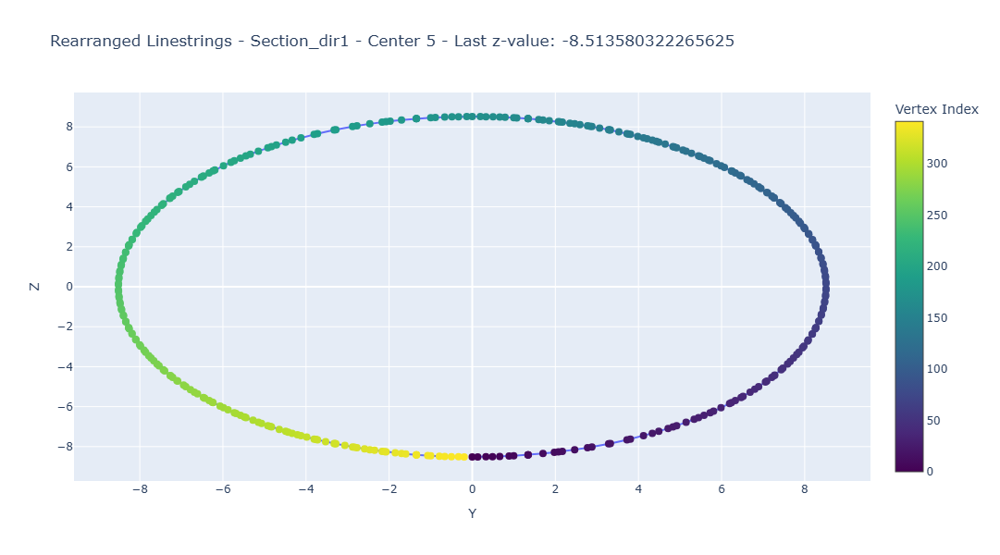

Center 6: min_step = 0


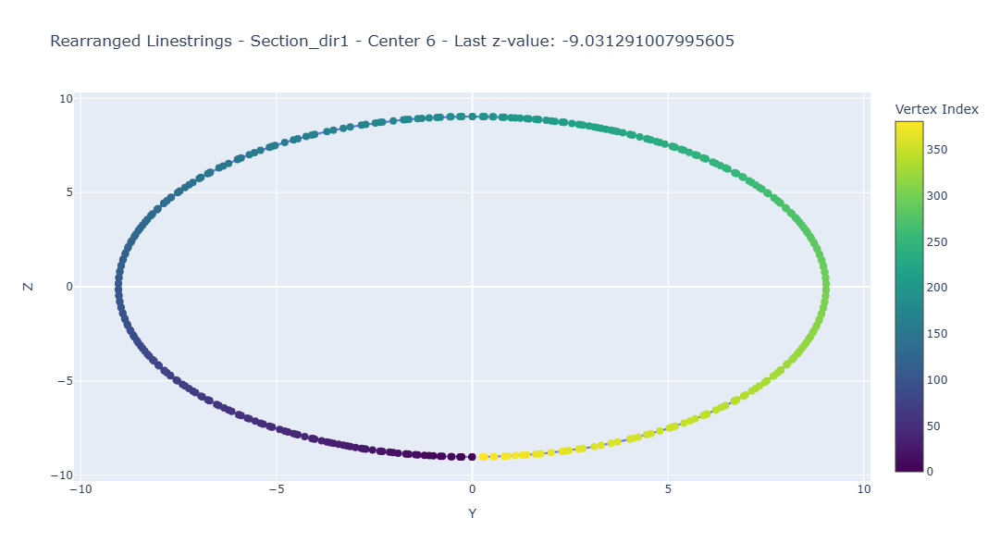

Center 7: min_step = 0


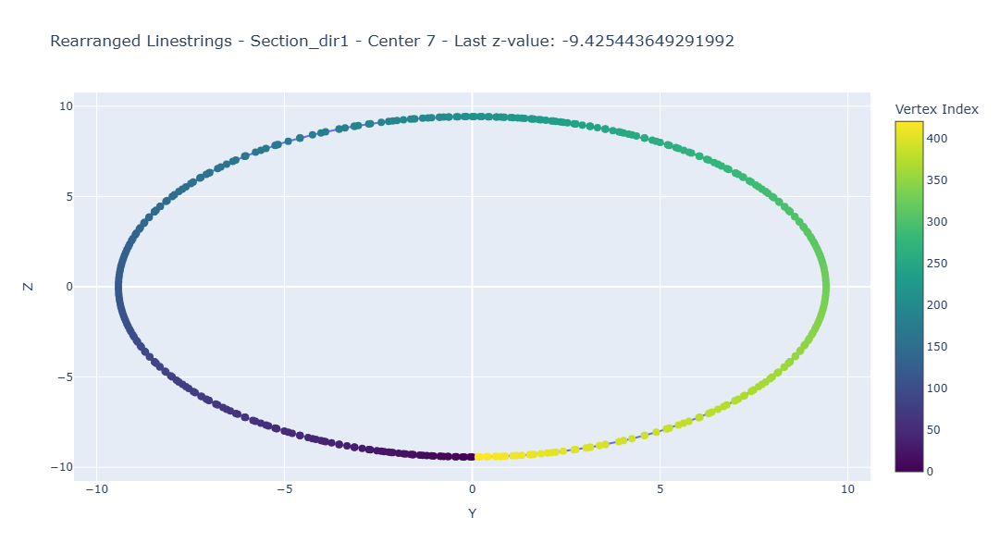

Center 8: min_step = 0


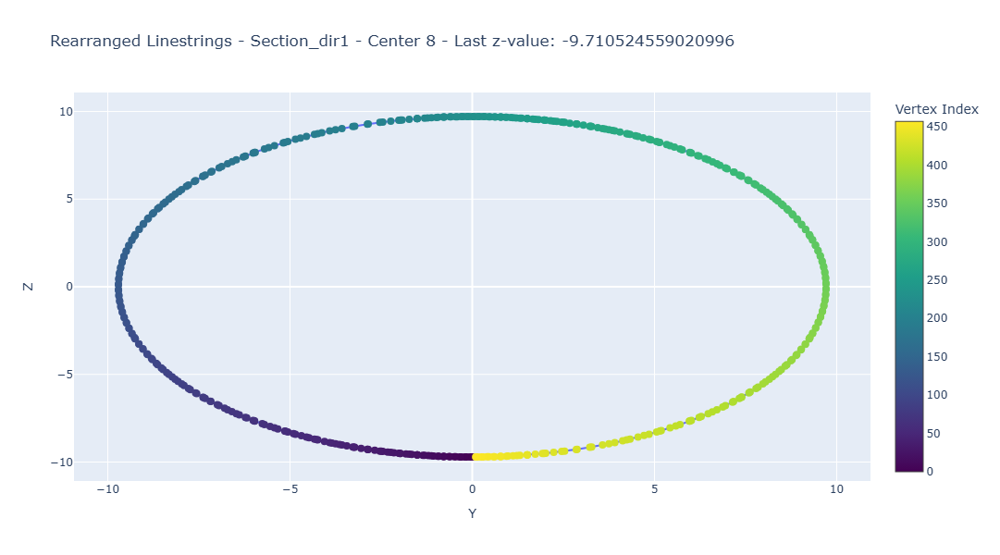

Center 9: min_step = 0


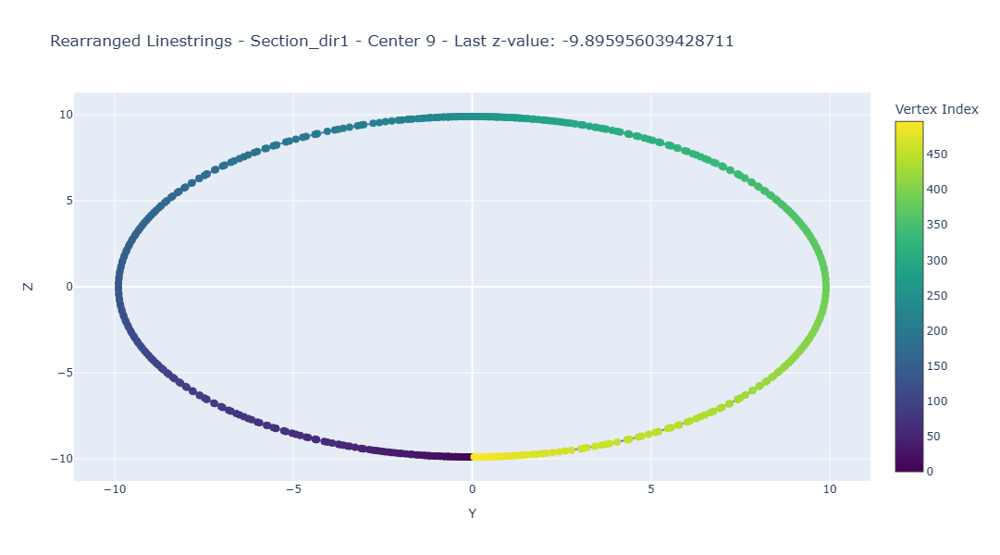

Center 10: min_step = 0


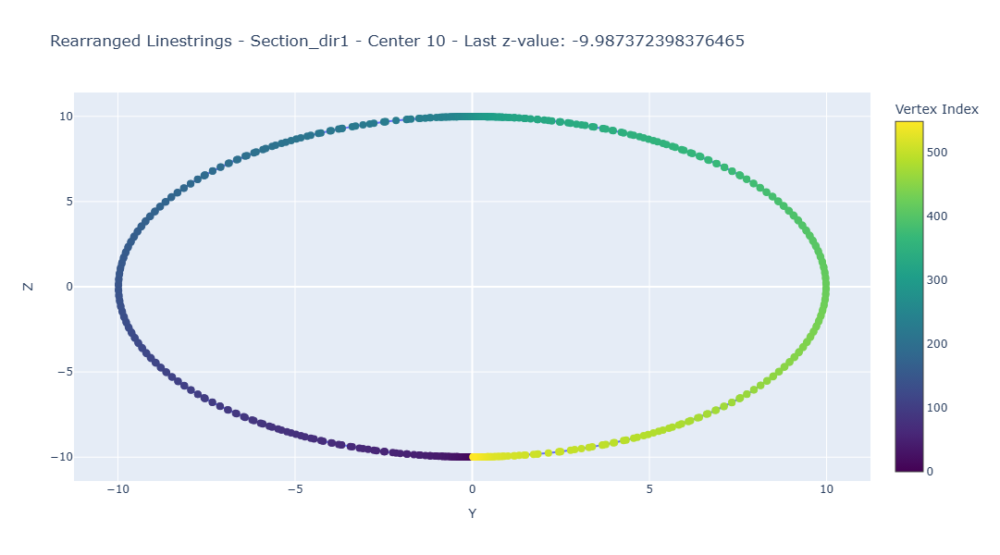

Center 11: min_step = 0


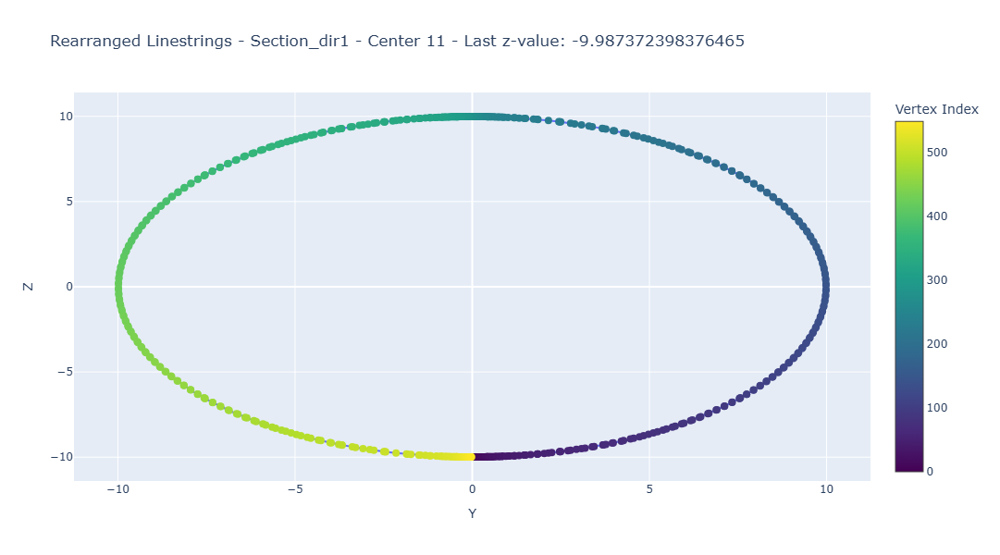

Center 12: min_step = 0


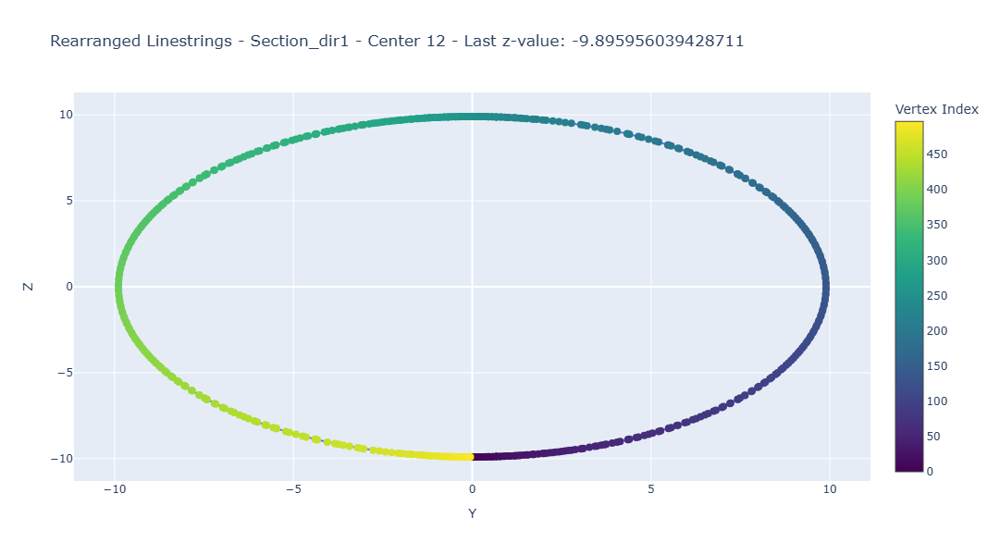

Center 13: min_step = 0


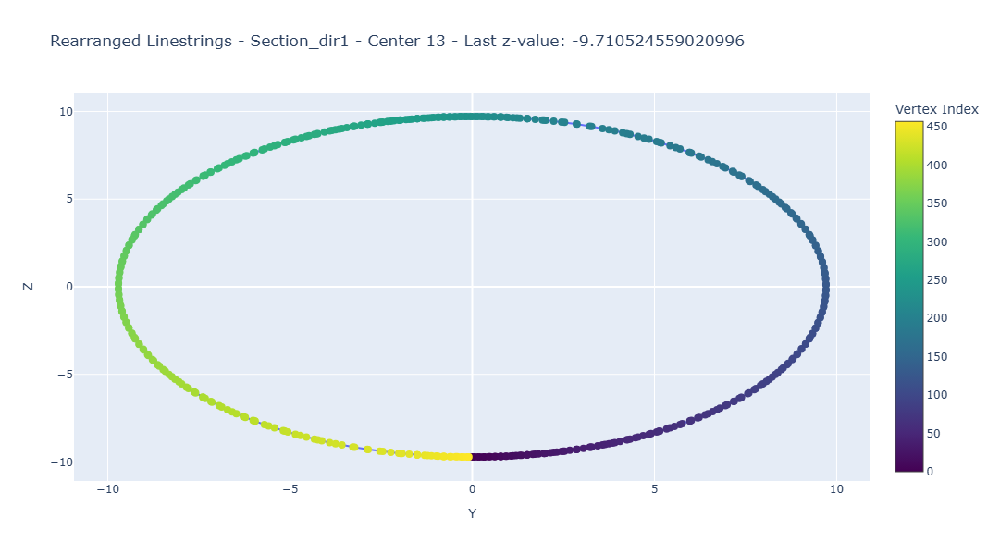

Center 14: min_step = 0


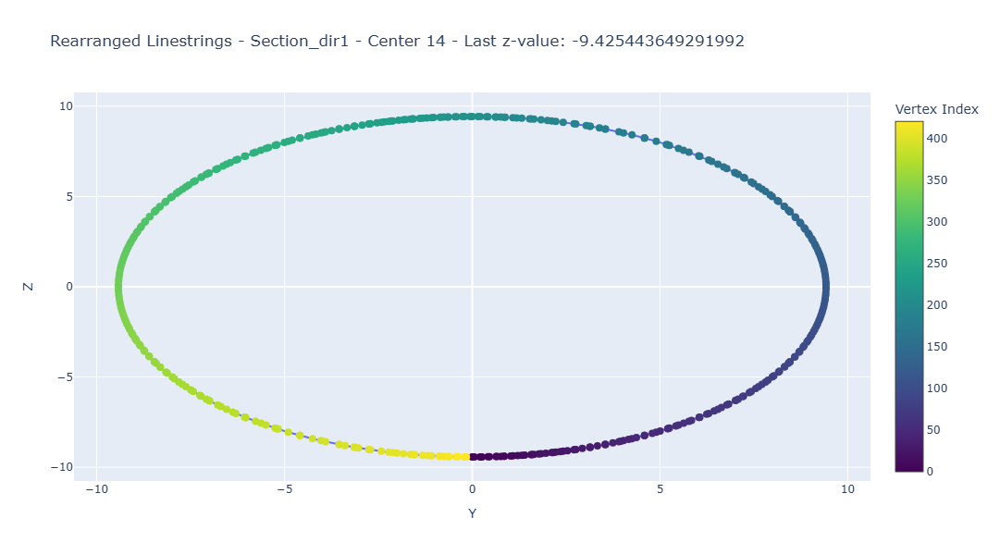

Center 15: min_step = 0


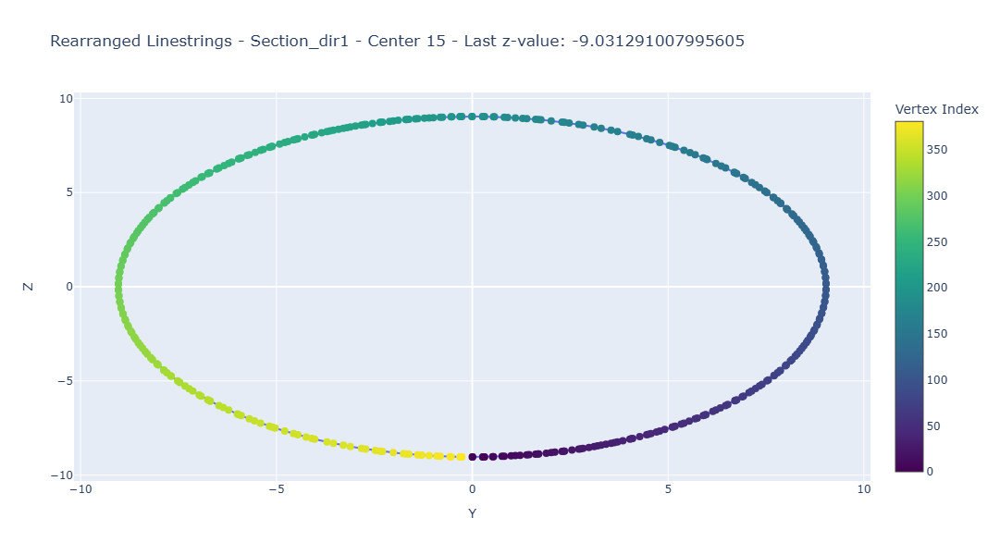

Center 16: min_step = 0


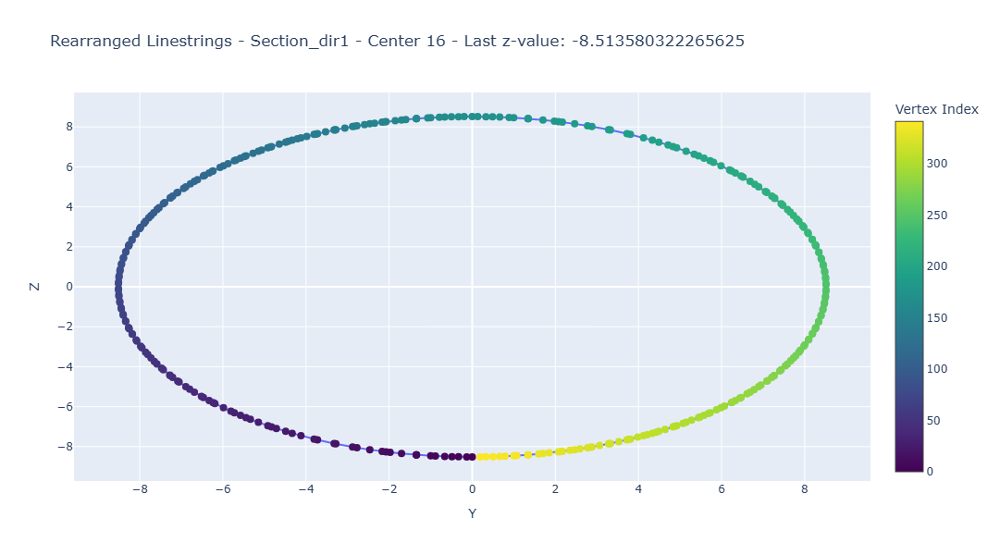

Center 17: min_step = 0


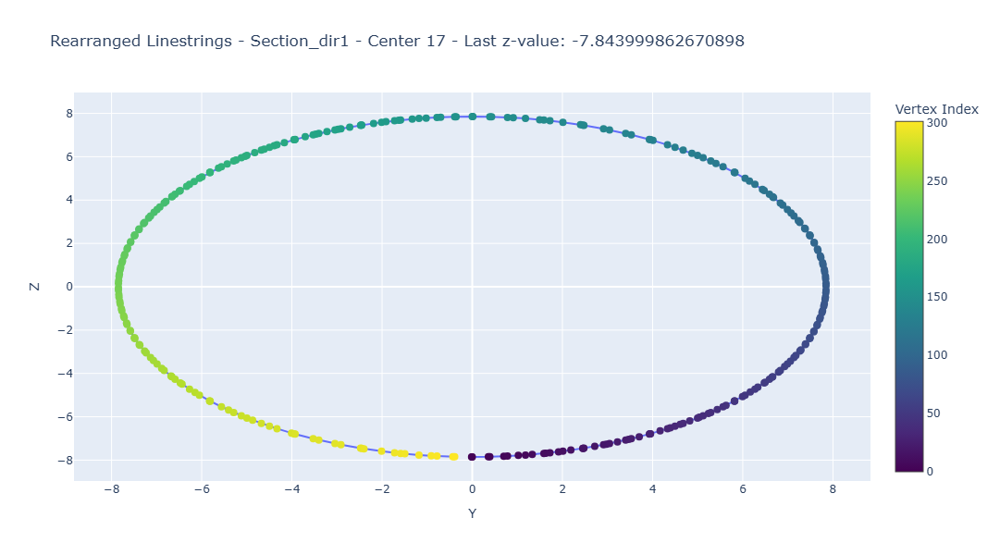

Center 18: min_step = 0


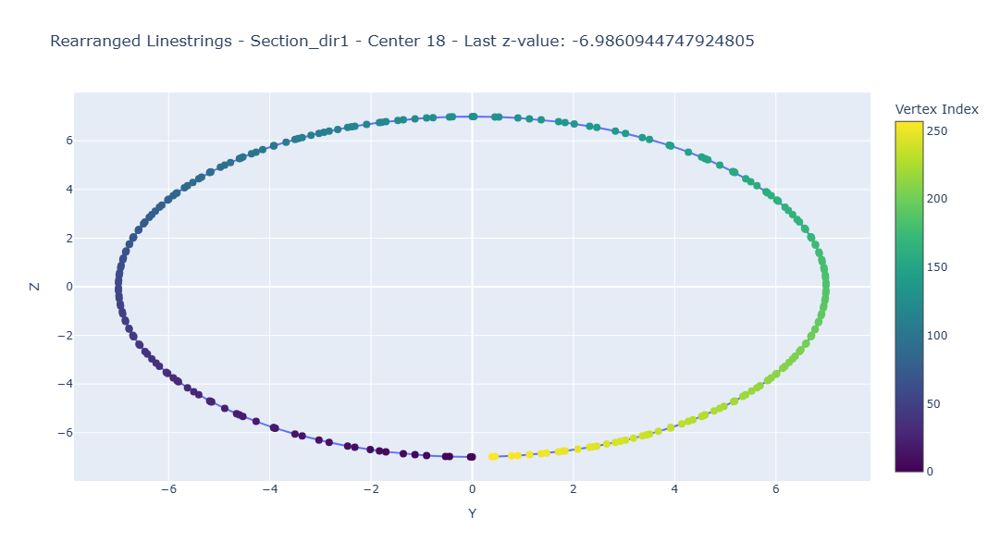

Center 19: min_step = 0


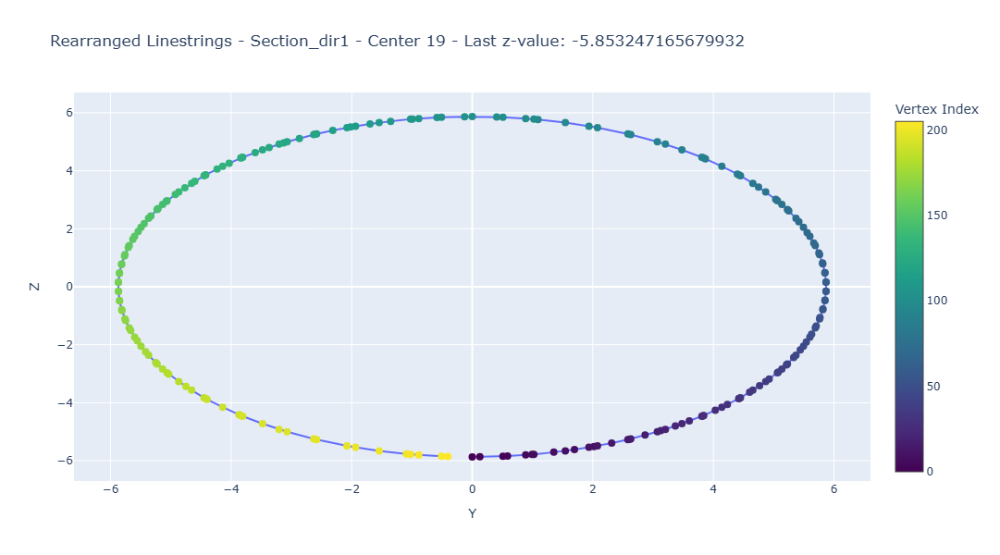

Center 20: min_step = 0


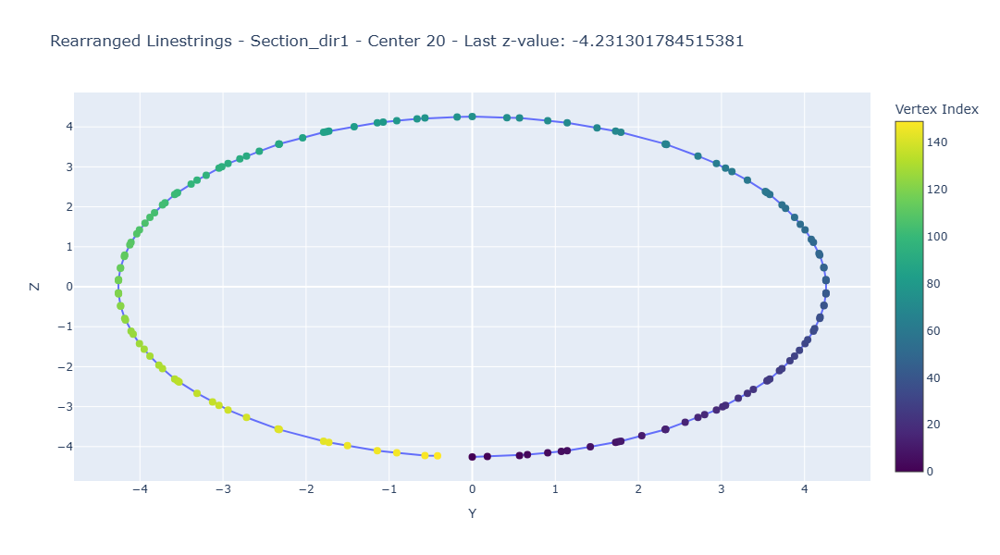

Center 21: min_step = 0


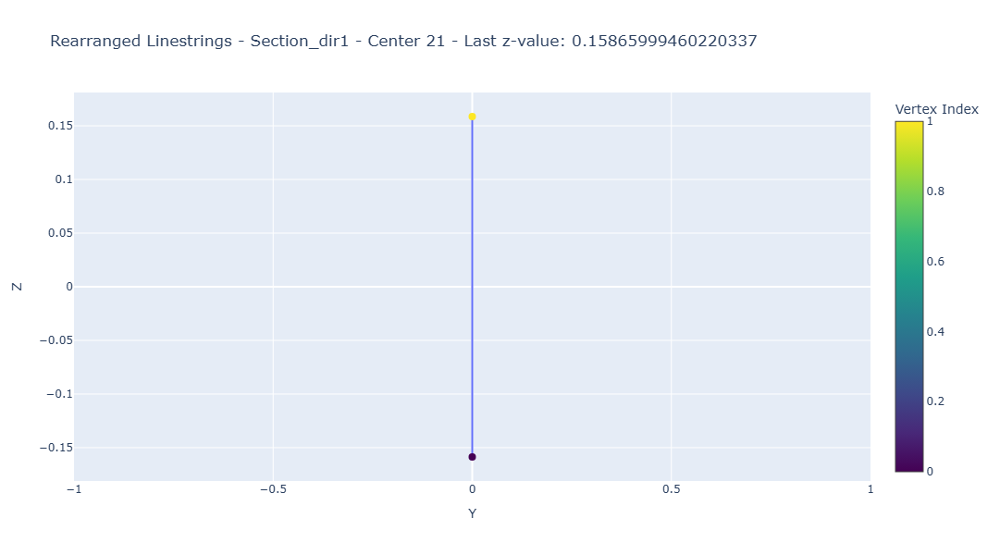

In [6]:
"""first step of artifact correction: automatic normalized nearest neighbor approach to get rid of most artifacts of vertex order"""
import numpy as np
from shapely.geometry import LineString
from sklearn.preprocessing import MinMaxScaler
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import json

# Load min_steps from the JSON file
with open('min_steps.json', 'r') as f:
    min_steps = json.load(f)
min_steps = {int(k): v for k, v in min_steps.items()}

def get_last_z_value(line_string):
    coords = np.array(line_string.coords)
    return coords[-1, 2]  

def get_z_value(vertices, index):
    return vertices[index][2]  

def normalize_values(vertices):
    scaler = MinMaxScaler()
    normalized_vertices = scaler.fit_transform(vertices)
    return normalized_vertices

#function of nearest neighbour approach
def rearrange_vertices_normalized_nearest_neighbor(vertices):
    # Normalize the vertices
    normalized_vertices = normalize_values(vertices)
    
    # Find the vertex with the smallest z-value to start
    start_idx = np.argmin(normalized_vertices[:, 2])
    new_order = [start_idx]

    remaining_indices = set(range(len(normalized_vertices))) - {start_idx}

    while remaining_indices:
        last_idx = new_order[-1]
        last_vertex = normalized_vertices[last_idx]
        
        nearest_idx = min(remaining_indices, key=lambda idx: np.linalg.norm(normalized_vertices[idx] - last_vertex))
        new_order.append(nearest_idx)
        remaining_indices.remove(nearest_idx)
    
    rearranged_vertices = vertices[new_order]  # Return the original vertices in the new order
    return rearranged_vertices, new_order

#executing function of nearest neighbour on the linestrings
def rearrange_all_linestrings(linestrings):
    rearranged_linestrings = {}
    last_z_values = []  # To collect last z-values
    selected_z_values = []
    all_rearranged_vertices = {}  # To store all rearranged vertices for each line string
    for idx, line_string in linestrings.items():
        vertices = np.array(line_string.coords)
        try:
            rearranged_vertices, new_order = rearrange_vertices_normalized_nearest_neighbor(vertices)
            rearranged_linestrings[idx] = LineString(rearranged_vertices)
            last_z = get_z_value(rearranged_vertices, -1)
            first_z = get_z_value(rearranged_vertices, 0)
            last_z_values.append(last_z)
            
            if last_z > 0.75 * first_z:
                selected_z = last_z
                
            else:
                selected_z = first_z
                           
            selected_z_values.append(selected_z)
            all_rearranged_vertices[idx] = (rearranged_vertices, new_order)
                
        except Exception as e:
            print(f"Center {idx}: Rearrangement failed with error: {e}")
            rearranged_linestrings[idx] = line_string
            
    return rearranged_linestrings, last_z_values, selected_z_values, all_rearranged_vertices

#execute algorithm
linestrings_rearranged, last_z_values_Section_dir1, selected_z_values_Section_dir1, all_rearranged_vertices_Section_dir1 = rearrange_all_linestrings(linestrings)

selected_z_values = selected_z_values_Section_dir1 

#plotting of rearranged linestrings
def plot_rearranged_linestrings_plotly(linestrings, title, min_step):
    for idx, line_string in linestrings.items():
        coords = np.array(line_string.coords)
        vertex_indices = np.arange(len(coords))
        
        # Get the last z-value
        last_z_value = get_last_z_value(line_string)

        min_step = min_steps.get(idx)
        print(f"Center {idx}: min_step = {min_step}")
        
        # Check if min_step is 0, then use x and z, otherwise y and z
        if dx < dy:
            if min_step == 0:
                x_vals = coords[:, 0]  # Use x for min_step=0
                axis_title = 'X'
            else:
                x_vals = coords[:, 1]  # Use y for min_step != 0
                axis_title = 'Y'

        elif dx >= dy:
            if min_step == 90:
                x_vals = coords[:, 0]  # Use x for min_step=0
                axis_title = 'X'
            else:
                x_vals = coords[:, 1]  # Use y for min_step != 0
                axis_title = 'Y'
        
        
        fig = go.Figure()
        fig.add_trace(go.Scatter(
            x=x_vals, y=coords[:, 2], mode='markers+lines', 
            marker=dict(color=vertex_indices, colorscale='Viridis', size=8, colorbar=dict(title='Vertex Index'))
        ))
        fig.update_layout(
            title=f'{title} - Center {idx} - Last z-value: {last_z_value}', 
            xaxis_title=axis_title, 
            yaxis_title='Z',
            height=600
        )
        fig.show()


# Plot the rearranged linestrings
plot_rearranged_linestrings_plotly(linestrings_rearranged, 'Rearranged Linestrings - Section_dir1', min_step)


In [7]:
"""second step to correct remaining potential artifacts in cross sections of 1st direction: interactive approach for manual correction"""
import os
import json
import numpy as np
from shapely.geometry import LineString
from sklearn.preprocessing import MinMaxScaler
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output, State, callback_context
import dash.exceptions
import matplotlib.pyplot as plt

# Load min_steps from the JSON file
with open('min_steps.json', 'r') as f:
    min_steps = json.load(f)
# Ensure min_steps is a dictionary with integer keys
min_steps = {int(k): v for k, v in min_steps.items()}

section_type = None
center_idx = None

# Normalization and rearrangement functions
def normalize_values(vertices):
    scaler = MinMaxScaler()
    normalized_vertices = scaler.fit_transform(vertices)
    return normalized_vertices

def rearrange_vertices_normalized_nearest_neighbor(vertices):
    normalized_vertices = normalize_values(vertices)
    start_idx = np.argmin(normalized_vertices[:, 2])
    new_order = [start_idx]
    remaining_indices = set(range(len(normalized_vertices))) - {start_idx}
    while remaining_indices:
        last_idx = new_order[-1]
        last_vertex = normalized_vertices[last_idx]
        nearest_idx = min(remaining_indices, key=lambda idx: np.linalg.norm(normalized_vertices[idx] - last_vertex))
        new_order.append(nearest_idx)
        remaining_indices.remove(nearest_idx)
    rearranged_vertices = vertices[new_order]
    return rearranged_vertices, new_order

def get_z_value(vertices, index):
    return vertices[index][2]  

def rearrange_all_linestrings(linestrings):
    rearranged_linestrings = {}
    all_rearranged_vertices = {}

    for idx, line_string in linestrings.items():
        vertices = np.array(line_string.coords)
        try:
            rearranged_vertices, new_order = rearrange_vertices_normalized_nearest_neighbor(vertices)
            rearranged_linestrings[idx] = LineString(rearranged_vertices)
            all_rearranged_vertices[idx] = (rearranged_vertices, new_order)
        except Exception as e:
            print(f"Center {idx}: Rearrangement failed with error: {e}")
            rearranged_linestrings[idx] = line_string

    return rearranged_linestrings, all_rearranged_vertices

#function for figure within the interactive application
def create_figure(linestring, title, vertex_order, center_idx):
    fig = go.Figure()

    # Get coordinates from LineString
    x, y = linestring.xy
    x = list(x)  # Convert to list
    y = list(y)  # Convert to list
    coords = np.array(linestring.coords)

    # Check min_step for the current center
    min_step = min_steps.get(center_idx, 1)  

    if dx < dy:
        if min_step == 0:
            z = coords[:, 2] 
            x_vals = coords[:, 0]  # Use x for min_step=0
            axis_title = 'X'
        else:
            z = coords[:, 2] 
            x_vals = coords[:, 1]  # Use y for min_step != 0
            axis_title = 'Y'

    elif dx >= dy:
        if min_step == 90:
            z = coords[:, 2]
            x_vals = coords[:, 0]  # Use x for min_step=0
            axis_title = 'X'
        else:
            z = coords[:, 2]
            x_vals = coords[:, 1]  # Use y for min_step != 0
            axis_title = 'Y'

    # Add line trace
    fig.add_trace(go.Scatter(x=x_vals, y=z, mode='lines+markers', name='LineString'))

    # Apply viridis colormap
    cmap = plt.get_cmap('viridis')
    norm = plt.Normalize(vmin=0, vmax=(len(x) - 1))
    colors = [cmap(norm(i)) for i in range(len(x))]
    colors = [f'rgba({r*255},{g*255},{b*255},{a})' for r, g, b, a in colors]

    # Scatter plot with colormap
    fig.add_trace(go.Scatter(
        x=x_vals, y=z,
        mode='markers',
        marker=dict(color=colors, size=10),
        name='Vertices'
    ))

    fig.update_layout(title=title)
    return fig


"""Step 1: Process Linestrings"""
linestrings_rearranged, all_rearranged_vertices_Section_dir1 = rearrange_all_linestrings(linestrings)

"""this function determines, which cross sections might need manual correction --> if last_z is larger than 0.9 * first_z for a section, this section
is available in the drop-down menu in the application. 0.9 is an empirically determined value to save some time potentially needed to click through 
all sections. If you would like to check all sections for the need of manual correction, set that number to > 1"""
def check_correction_needed(linestrings_rearranged, all_rearranged_vertices, section_type):
    last_z_values = []
    selected_z_values = []
    correction_flag = False
    correction_indices = []

    for idx, (rearranged_vertices, new_order) in all_rearranged_vertices.items():
        last_z = get_z_value(rearranged_vertices, -1)
        first_z = get_z_value(rearranged_vertices, 0)
        last_z_values.append(last_z)

        if last_z > 0.9 * first_z:
            correction_flag = True
            correction_indices.append(idx)
        else:
            selected_z = last_z
            selected_z_values.append(selected_z)

    if correction_flag:
        print(f"Manual correction required for {section_type}, centers: {correction_indices} before proceeding.")

    return last_z_values, selected_z_values, correction_flag, correction_indices

"""Step 2: raise correction flag and implement manual correction if needed"""
last_z_values_Section_dir1, selected_z_values_Section_dir1, flag_Section_dir1, indices_Section_dir1 = check_correction_needed(linestrings_rearranged, all_rearranged_vertices_Section_dir1, "Section_dir1")

selected_z_values = selected_z_values_Section_dir1 

if not (flag_Section_dir1):         
    print("No manual correction required. Continue processing...")

# Initialize Dash app for interactive corrections
app = Dash(__name__)

# Generate dropdown options based on correction flag
dropdown_options = []
for idx in indices_Section_dir1:
    dropdown_options.append({'label': f'Section_dir1 - Center {idx}', 'value': f'Section_dir1-{idx}'})
    
# Definition of App layout
app.layout = html.Div([
    dcc.Dropdown(
        id='direction-center-selector',
        options=dropdown_options,
        placeholder='Select a direction-center combination'
    ),
    html.Div(id='plots-container', children=[]),
    dcc.Store(id='vertex-order', data=[]),
    dcc.Store(id='vertex-order-history', data=[]),
    dcc.Store(id='current-figure-index', data=0),
    dcc.Store(id='selected-vertices', data=[]),
    dcc.Store(id='correction-info', data={'section_type': None, 'center_idx': None}),
    html.Div(id='debug', style={'display': 'none'}),
    dcc.Store(id='save-message', data=''),
    dcc.Graph(id='plot'),
    html.Button('Save', id='save-btn', n_clicks=0),
    html.Button('Undo', id='undo-btn', n_clicks=0),
    html.Div(id='save-status')
])

@app.callback(
    [Output('plot', 'figure'),
     Output('vertex-order', 'data'),
     Output('selected-vertices', 'data'),
     Output('current-figure-index', 'data'),
     Output('vertex-order-history', 'data'),
     Output('save-message', 'data')],
    [Input('save-btn', 'n_clicks'),
     Input('plot', 'clickData'),
     Input('direction-center-selector', 'value'),
     Input('undo-btn', 'n_clicks')],
    [State('vertex-order', 'data'),
     State('vertex-order-history', 'data'),
     State('current-figure-index', 'data'),
     State('selected-vertices', 'data'),
     State('correction-info', 'data')]
)

#Definition of App functionality
def update_figure(n_clicks_save, clickData, selected_direction_center, n_clicks_undo, vertex_order, vertex_order_history, current_figure_index, selected_vertices, correction_info):
    ctx = callback_context
    if not ctx.triggered:
        raise dash.exceptions.PreventUpdate

    trigger = ctx.triggered[0]['prop_id'].split('.')[0]
    save_message = ''
    section_type, center_idx = None, None

    if selected_direction_center:
        section_type, center_idx = selected_direction_center.split('-')
        center_idx = int(center_idx)

    if trigger == 'direction-center-selector' and selected_direction_center:
        if section_type == 'Section_dir1':
            linestring = list(linestrings_rearranged.values())[center_idx - 1]
        else:
            linestring = list(perpendicular_linestrings_rearranged.values())[center_idx - 1]

        vertex_order = list(range(len(linestring.coords)))
        vertex_order_history = []
        selected_vertices = []
        return create_figure(linestring, f'Linestrings 1st direction - Center {center_idx}', vertex_order, center_idx), vertex_order, selected_vertices, None, vertex_order_history, ''

    if trigger == 'plot' and clickData:
        point_index = clickData['points'][0]['pointIndex']
        if point_index >= len(vertex_order):
            raise dash.exceptions.PreventUpdate  # Prevent out-of-range index
        if len(selected_vertices) == 0:
            selected_vertices = [point_index]
        elif len(selected_vertices) == 1:
            selected_vertices.append(point_index)
            first, second = selected_vertices
            if first != second:
                vertex_order_history.append(vertex_order.copy())
                try:
                    first_idx = vertex_order[first]
                    second_idx = vertex_order[second]
                    vertex_order.remove(second_idx)
                    insert_index = vertex_order.index(first_idx) + 1
                    vertex_order.insert(insert_index, second_idx)
                except IndexError as e:
                    print(f"IndexError: {e}")
            selected_vertices = []

        if section_type == 'Section_dir1':
            coords = np.array(list(linestrings_rearranged.values())[center_idx - 1].coords)
        else:
            coords = np.array(list(perpendicular_linestrings_rearranged.values())[center_idx - 1].coords)

        rearranged_coords = coords[vertex_order]
        new_fig = create_figure(LineString(rearranged_coords), f'Linestrings 1st direction - Center {center_idx}', vertex_order, center_idx)
        return new_fig, vertex_order, selected_vertices, current_figure_index, vertex_order_history, ''

    if trigger == 'save-btn':
        if selected_vertices and len(selected_vertices) == 2:
            idx1, idx2 = selected_vertices
            try:
                vertex_order[idx1], vertex_order[idx2] = vertex_order[idx2], vertex_order[idx1]
                vertex_order_history.append(vertex_order.copy())
                selected_vertices = []
            except IndexError as e:
                print(f"IndexError: {e}")

        if section_type == 'Section_dir1':
            coords = np.array(list(linestrings_rearranged.values())[center_idx - 1].coords)
        else:
            coords = np.array(list(perpendicular_linestrings_rearranged.values())[center_idx - 1].coords)

        rearranged_coords = coords[vertex_order]
        new_fig = create_figure(LineString(rearranged_coords), f'Linestrings 1st direction - Center {center_idx}', vertex_order, center_idx)

        save_message = f"Corrected vertex order saved to corrected_vertices_direction_{section_type}_center_{center_idx}.npy"
        try:
            base_save_dir = r"C:\Users\carl\Desktop\Zwischenschritte" #newly set vertex order is saved to directory
            dataset_name = "sphere_model"
            dataset_save_dir = os.path.join(base_save_dir, dataset_name)
            if not os.path.exists(dataset_save_dir):
                os.makedirs(dataset_save_dir)
            
            save_path = os.path.join(dataset_save_dir, f"corrected_vertices_direction_{section_type}_center_{center_idx}.npy")
            np.save(save_path, vertex_order)
            save_message = f"Corrected vertex order saved to {save_path}"
        except Exception as e:
            save_message = f"Error occurred while saving: {str(e)}"
        
        print(save_message)

        return new_fig, vertex_order, selected_vertices, current_figure_index, vertex_order_history, save_message

    if trigger == 'undo-btn' and vertex_order_history:
        vertex_order = vertex_order_history.pop()
        if section_type == 'Section_dir1':
            coords = np.array(list(linestrings_rearranged.values())[center_idx - 1].coords)
        else:
            coords = np.array(list(perpendicular_linestrings_rearranged.values())[center_idx - 1].coords)

        rearranged_coords = coords[vertex_order]
        new_fig = create_figure(LineString(rearranged_coords), f'Rearranged Linestrings - Center {center_idx}', vertex_order, center_idx)
        return new_fig, vertex_order, selected_vertices, current_figure_index, vertex_order_history, ''

    raise dash.exceptions.PreventUpdate

if __name__ == '__main__':
    app.run_server(debug=True)


Manual correction required for Section_dir1, centers: [21] before proceeding.


peak memory: 679.47 MiB, increment: 0.02 MiB


C:\Users\carl\AppData\Local\Temp\ipykernel_19040\2983454196.py:236: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\2983454196.py:194: RuntimeWarning:

invalid value encountered in scalar divide



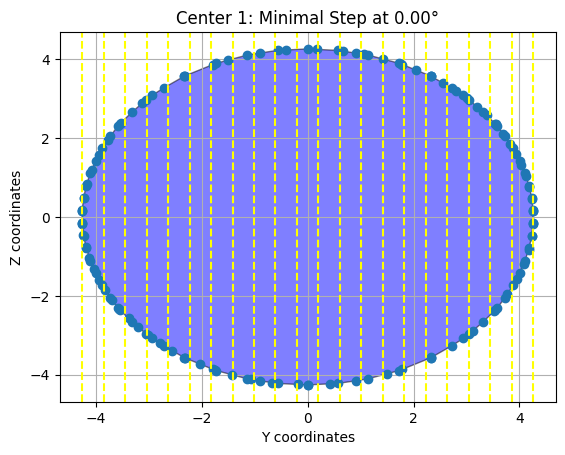

Center 1:
Y lines: [-4.25853443 -3.85295972 -3.44738502 -3.04181031 -2.6362356  -2.23066089
 -1.82508618 -1.41951148 -1.01393677 -0.60836206 -0.20278735  0.20278735
  0.60836206  1.01393677  1.41951148  1.82508618  2.23066089  2.6362356
  3.04181031  3.44738502  3.85295972  4.25853443]


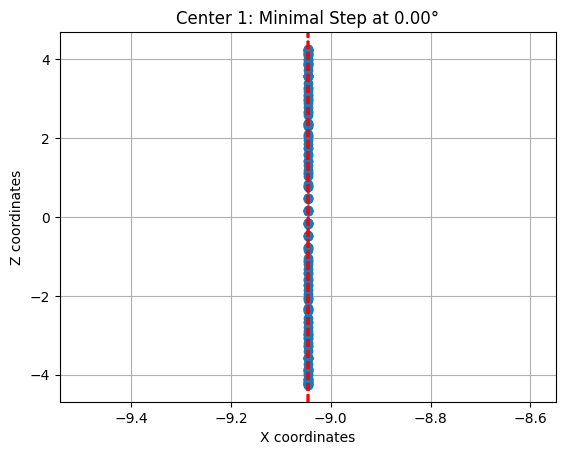

Center 1:
X lines: [-9.04648018 -9.04648018 -9.04648018 -9.04648018 -9.04648018 -9.04648018
 -9.04648018 -9.04648018 -9.04648018 -9.04648018 -9.04648018 -9.04648018
 -9.04648018 -9.04648018 -9.04648018 -9.04648018 -9.04648018 -9.04648018
 -9.04648018 -9.04648018 -9.04648018 -9.04648018]
  Line -4.2585344314575195: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -3.8529597236996604: Zmin = -1.7913780209878052, Zmax = 1.7913755944221075
  Line -3.4473850159418014: Zmin = -2.4883262293464394, Zmax = 2.488325436783042
  Line -3.0418103081839427: Zmin = -2.9761318079718895, Zmax = 2.9761315430106956
  Line -2.6362356004260836: Zmin = -3.3327478925653087, Zmax = 3.332748089376211
  Line -2.2306608926682245: Zmin = -3.6229764486207015, Zmax = 3.6229787689905653
  Line -1.825086184910366: Zmin = -3.844084263167491, Zmax = 3.844085266361975
  Line -1.4195114771525068: Zmin = -4.004793533329604, Zmax = 4.004792685260518
  Line -1.0139367693946477: Zmin = -4.131465771153985, Zmax =

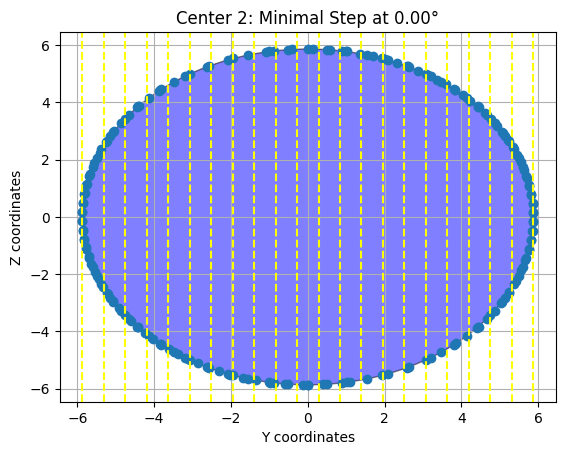

Center 2:
Y lines: [-5.86965322 -5.31063863 -4.75162404 -4.19260945 -3.63359485 -3.07458026
 -2.51556567 -1.95655107 -1.39753648 -0.83852189 -0.2795073   0.2795073
  0.83852189  1.39753648  1.95655107  2.51556567  3.07458026  3.63359485
  4.19260945  4.75162404  5.31063863  5.86965322]


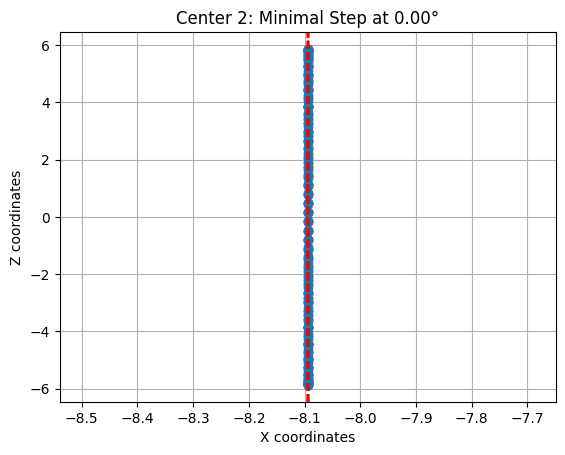

Center 2:
X lines: [-8.09421825 -8.09421825 -8.09421825 -8.09421825 -8.09421825 -8.09421825
 -8.09421825 -8.09421825 -8.09421825 -8.09421825 -8.09421825 -8.09421825
 -8.09421825 -8.09421825 -8.09421825 -8.09421825 -8.09421825 -8.09421825
 -8.09421825 -8.09421825 -8.09421825 -8.09421825]
  Line -5.869653224945068: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -5.310638632093157: Zmin = -2.487657272773972, Zmax = 2.4876466140419575
  Line -4.751624039241246: Zmin = -3.4343411642416504, Zmax = 3.434342451165662
  Line -4.192609446389334: Zmin = -4.100263410659245, Zmax = 4.100262917123015
  Line -3.6335948535374234: Zmin = -4.603562765922728, Zmax = 4.603563287906292
  Line -3.0745802606855124: Zmin = -4.997857992686006, Zmax = 4.997858085517082
  Line -2.515565667833601: Zmin = -5.300920923547586, Zmax = 5.300920995467927
  Line -1.9565510749816895: Zmin = -5.5321916352498945, Zmax = 5.532191990182339
  Line -1.3975364821297784: Zmin = -5.696742349669561, Zmax = 5.696741

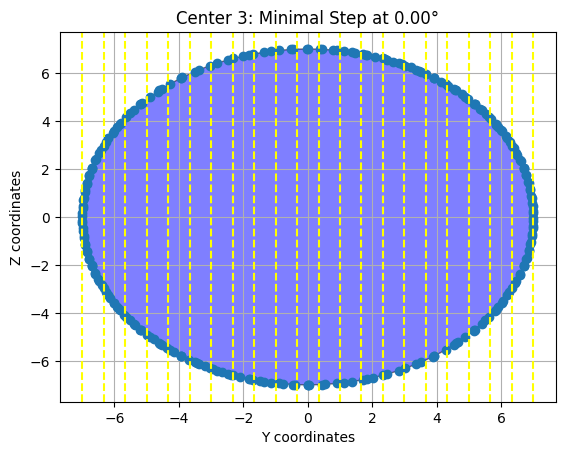

Center 3:
Y lines: [-6.99142313 -6.32557331 -5.65972349 -4.99387366 -4.32802384 -3.66217402
 -2.9963242  -2.33047438 -1.66462455 -0.99877473 -0.33292491  0.33292491
  0.99877473  1.66462455  2.33047438  2.9963242   3.66217402  4.32802384
  4.99387366  5.65972349  6.32557331  6.99142313]


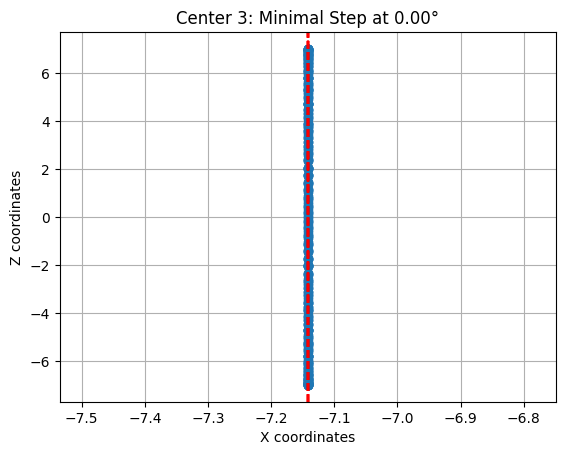

Center 3:
X lines: [-7.14195728 -7.14195728 -7.14195728 -7.14195728 -7.14195728 -7.14195728
 -7.14195728 -7.14195728 -7.14195728 -7.14195728 -7.14195728 -7.14195728
 -7.14195728 -7.14195728 -7.14195728 -7.14195728 -7.14195728 -7.14195728
 -7.14195728 -7.14195728 -7.14195728 -7.14195728]
  Line -6.9914231300354: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -6.325573308127267: Zmin = -2.9810098735989303, Zmax = 2.9810097304826226
  Line -5.659723486219134: Zmin = -4.107718415703745, Zmax = 4.107721749288696
  Line -4.993873664311: Zmin = -4.895761907036829, Zmax = 4.895762316501515
  Line -4.328023842402867: Zmin = -5.49415188741189, Zmax = 5.49415497737425
  Line -3.6621740204947337: Zmin = -5.957673326821799, Zmax = 5.957675670919531
  Line -2.9963241985866: Zmin = -6.321136635299476, Zmax = 6.32113558464409
  Line -2.330474376678467: Zmin = -6.598503763838258, Zmax = 6.59850364424414
  Line -1.6646245547703336: Zmin = -6.79475371419505, Zmax = 6.794753362490104
  Lin

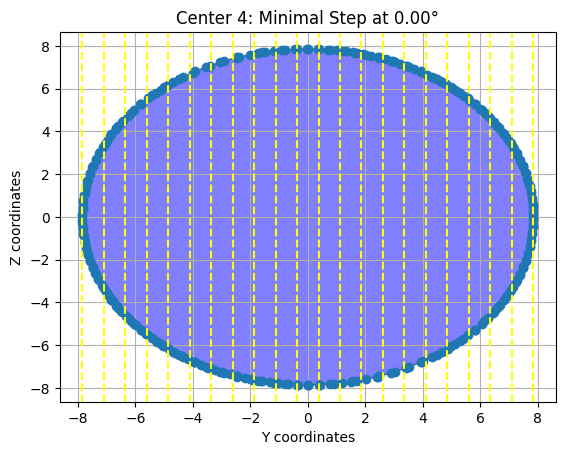

Center 4:
Y lines: [-7.84668541 -7.09938204 -6.35207866 -5.60477529 -4.85747192 -4.11016855
 -3.36286518 -2.6155618  -1.86825843 -1.12095506 -0.37365169  0.37365169
  1.12095506  1.86825843  2.6155618   3.36286518  4.11016855  4.85747192
  5.60477529  6.35207866  7.09938204  7.84668541]


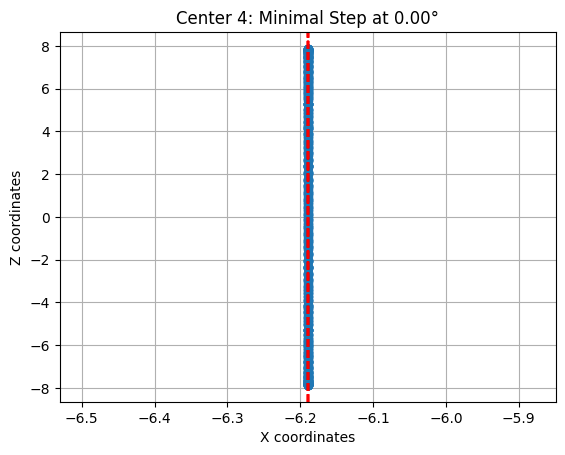

Center 4:
X lines: [-6.18969631 -6.18969631 -6.18969631 -6.18969631 -6.18969631 -6.18969631
 -6.18969631 -6.18969631 -6.18969631 -6.18969631 -6.18969631 -6.18969631
 -6.18969631 -6.18969631 -6.18969631 -6.18969631 -6.18969631 -6.18969631
 -6.18969631 -6.18969631 -6.18969631 -6.18969631]
  Line -7.846685409545898: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -7.099382037208194: Zmin = -3.3440771502672515, Zmax = 3.344074773912582
  Line -6.352078664870489: Zmin = -4.609780462060744, Zmax = 4.609779915011685
  Line -5.604775292532785: Zmin = -5.495800454811917, Zmax = 5.4958010467467995
  Line -4.85747192019508: Zmin = -6.165120764447319, Zmax = 6.165122922167839
  Line -4.110168547857375: Zmin = -6.687416552508064, Zmax = 6.687416672079556
  Line -3.362865175519671: Zmin = -7.095161723733745, Zmax = 7.095161745910766
  Line -2.615561803181966: Zmin = -7.401826201085934, Zmax = 7.401825216718101
  Line -1.8682584308442616: Zmin = -7.625370159748543, Zmax = 7.62537083846

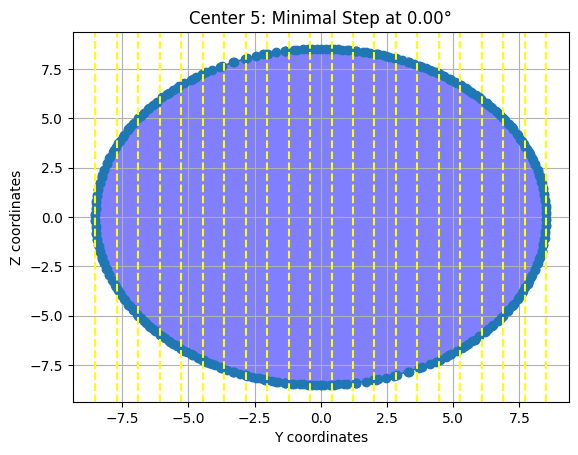

Center 5:
Y lines: [-8.51327896 -7.70249049 -6.89170202 -6.08091354 -5.27012507 -4.4593366
 -3.64854813 -2.83775965 -2.02697118 -1.21618271 -0.40539424  0.40539424
  1.21618271  2.02697118  2.83775965  3.64854813  4.4593366   5.27012507
  6.08091354  6.89170202  7.70249049  8.51327896]


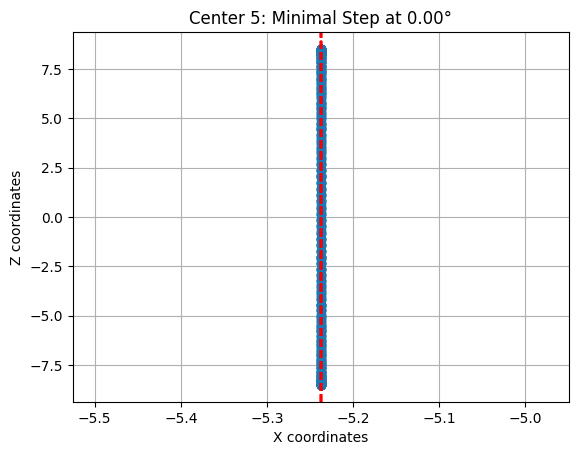

Center 5:
X lines: [-5.23743439 -5.23743439 -5.23743439 -5.23743439 -5.23743439 -5.23743439
 -5.23743439 -5.23743439 -5.23743439 -5.23743439 -5.23743439 -5.23743439
 -5.23743439 -5.23743439 -5.23743439 -5.23743439 -5.23743439 -5.23743439
 -5.23743439 -5.23743439 -5.23743439 -5.23743439]
  Line -8.51327896118164: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -7.702490488688151: Zmin = -3.624873021305878, Zmax = 3.624870798705506
  Line -6.891702016194661: Zmin = -5.000677047606452, Zmax = 5.000677060745399
  Line -6.080913543701172: Zmin = -5.959288794853263, Zmax = 5.959285680161421
  Line -5.270125071207682: Zmin = -6.687049337250477, Zmax = 6.687049226628573
  Line -4.459336598714192: Zmin = -7.255559825680094, Zmax = 7.255559544032732
  Line -3.648548126220703: Zmin = -7.694690077217902, Zmax = 7.694689090806666
  Line -2.837759653727213: Zmin = -8.030809395572037, Zmax = 8.030809084964627
  Line -2.0269711812337237: Zmin = -8.272307358557319, Zmax = 8.2723077478107

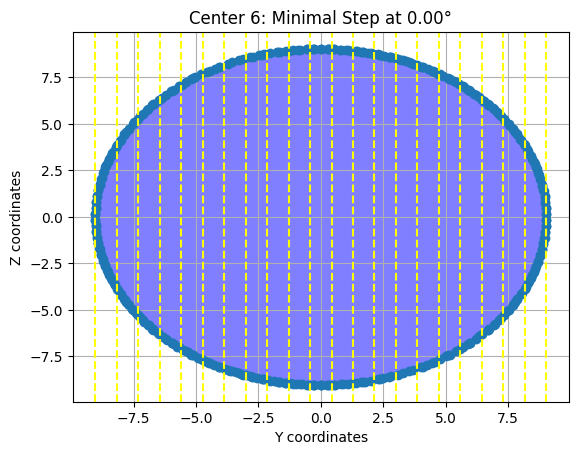

Center 6:
Y lines: [-9.03290558 -8.17262886 -7.31235214 -6.45207541 -5.59179869 -4.73152197
 -3.87124525 -3.01096853 -2.1506918  -1.29041508 -0.43013836  0.43013836
  1.29041508  2.1506918   3.01096853  3.87124525  4.73152197  5.59179869
  6.45207541  7.31235214  8.17262886  9.03290558]


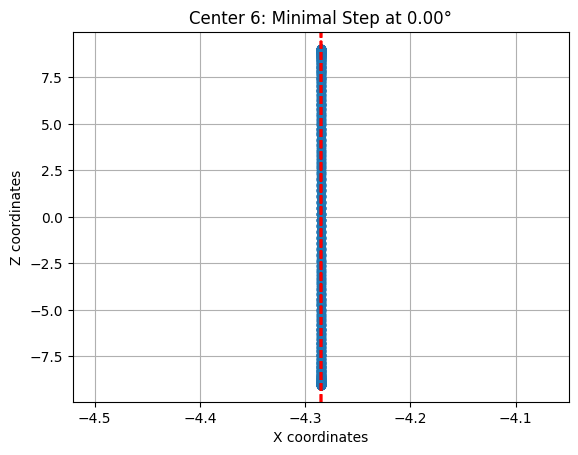

Center 6:
X lines: [-4.28517532 -4.28517532 -4.28517532 -4.28517532 -4.28517532 -4.28517532
 -4.28517532 -4.28517532 -4.28517532 -4.28517532 -4.28517532 -4.28517532
 -4.28517532 -4.28517532 -4.28517532 -4.28517532 -4.28517532 -4.28517532
 -4.28517532 -4.28517532 -4.28517532 -4.28517532]
  Line -9.032905578613281: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -8.172628856840587: Zmin = -3.8426973906141595, Zmax = 3.842698059014375
  Line -7.312352135067894: Zmin = -5.299776829299967, Zmax = 5.29977489907937
  Line -6.452075413295201: Zmin = -6.320579567618103, Zmax = 6.320579333997009
  Line -5.5917986915225075: Zmin = -7.092171781233789, Zmax = 7.0921735784576745
  Line -4.731521969749814: Zmin = -7.694332907618623, Zmax = 7.694333268985112
  Line -3.8712452479771207: Zmin = -8.16077832379694, Zmax = 8.16077830499769
  Line -3.0109685262044277: Zmin = -8.516291729831414, Zmax = 8.516291657639314
  Line -2.150691804431734: Zmin = -8.773363089697455, Zmax = 8.77336278836

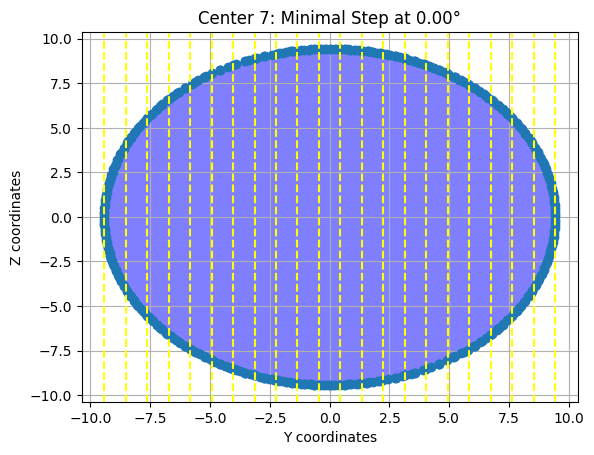

Center 7:
Y lines: [-9.42183399 -8.52451647 -7.62719895 -6.72988142 -5.8325639  -4.93524638
 -4.03792885 -3.14061133 -2.24329381 -1.34597628 -0.44865876  0.44865876
  1.34597628  2.24329381  3.14061133  4.03792885  4.93524638  5.8325639
  6.72988142  7.62719895  8.52451647  9.42183399]


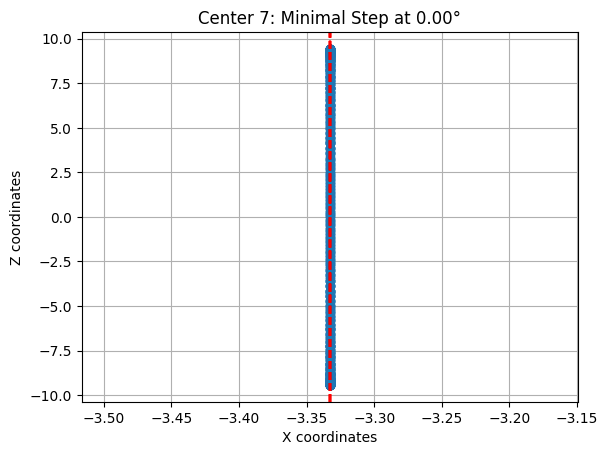

Center 7:
X lines: [-3.33291292 -3.33291292 -3.33291292 -3.33291292 -3.33291292 -3.33291292
 -3.33291292 -3.33291292 -3.33291292 -3.33291292 -3.33291292 -3.33291292
 -3.33291292 -3.33291292 -3.33291292 -3.33291292 -3.33291292 -3.33291292
 -3.33291292 -3.33291292 -3.33291292 -3.33291292]
  Line -9.421833992004395: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -8.524516468956357: Zmin = -4.022218868077442, Zmax = 4.02222047889106
  Line -7.62719894590832: Zmin = -5.536141113420001, Zmax = 5.5361411908192215
  Line -6.729881422860282: Zmin = -6.598135070017334, Zmax = 6.59813843823784
  Line -5.832563899812245: Zmin = -7.4041011001093, Zmax = 7.404103011559976
  Line -4.935246376764207: Zmin = -8.03057029200716, Zmax = 8.03057056240004
  Line -4.037928853716169: Zmin = -8.518303231743934, Zmax = 8.518303218769141
  Line -3.140611330668132: Zmin = -8.889606608356557, Zmax = 8.889606848918541
  Line -2.243293807620094: Zmin = -9.156430327580239, Zmax = 9.156430191778346
  L

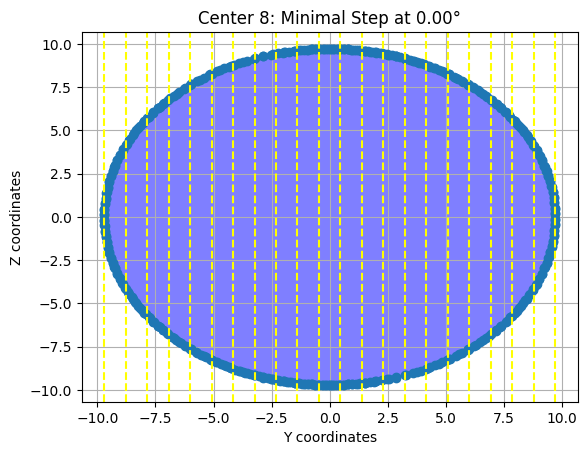

Center 8:
Y lines: [-9.70829105 -8.78369191 -7.85909276 -6.93449361 -6.00989446 -5.08529531
 -4.16069617 -3.23609702 -2.31149787 -1.38689872 -0.46229957  0.46229957
  1.38689872  2.31149787  3.23609702  4.16069617  5.08529531  6.00989446
  6.93449361  7.85909276  8.78369191  9.70829105]


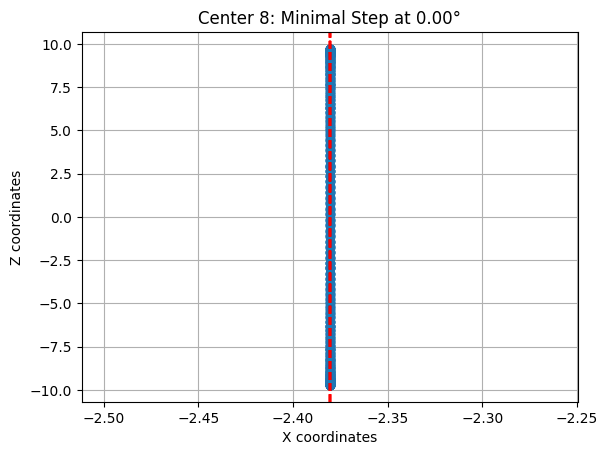

Center 8:
X lines: [-2.3806529 -2.3806529 -2.3806529 -2.3806529 -2.3806529 -2.3806529
 -2.3806529 -2.3806529 -2.3806529 -2.3806529 -2.3806529 -2.3806529
 -2.3806529 -2.3806529 -2.3806529 -2.3806529 -2.3806529 -2.3806529
 -2.3806529 -2.3806529 -2.3806529 -2.3806529]
  Line -9.708291053771973: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -8.78369190579369: Zmin = -4.13751541418231, Zmax = 4.1375157125003605
  Line -7.859092757815406: Zmin = -5.699603275315717, Zmax = 5.6996014680017
  Line -6.934493609837123: Zmin = -6.796989625567474, Zmax = 6.796989500902589
  Line -6.00989446185884: Zmin = -7.628906479001377, Zmax = 7.628906483996428
  Line -5.085295313880557: Zmin = -8.273562232575856, Zmax = 8.27356202967133
  Line -4.160696165902274: Zmin = -8.774098246116745, Zmax = 8.774098477078928
  Line -3.2360970179239903: Zmin = -9.15705635508553, Zmax = 9.157056202216562
  Line -2.3114978699457076: Zmin = -9.431785931498943, Zmax = 9.431785312738034
  Line -1.3868987219674

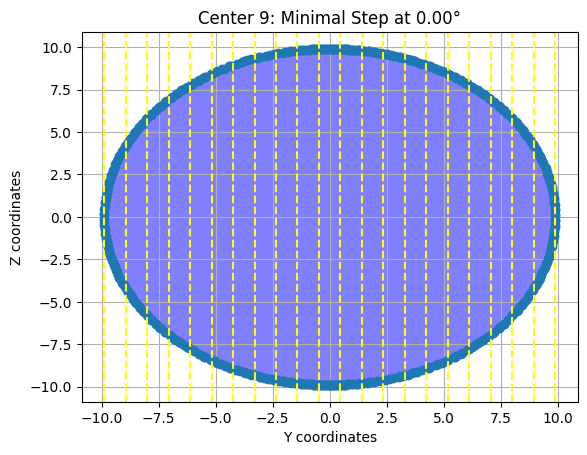

Center 9:
Y lines: [-9.89214897 -8.95003955 -8.00793012 -7.06582069 -6.12371127 -5.18160184
 -4.23949242 -3.29738299 -2.35527356 -1.41316414 -0.47105471  0.47105471
  1.41316414  2.35527356  3.29738299  4.23949242  5.18160184  6.12371127
  7.06582069  8.00793012  8.95003955  9.89214897]


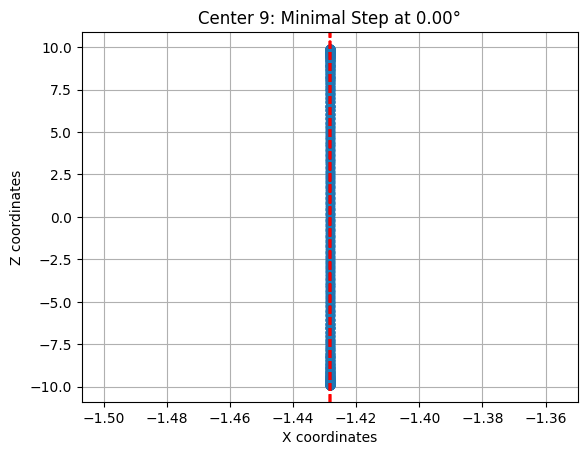

Center 9:
X lines: [-1.42839134 -1.42839134 -1.42839134 -1.42839134 -1.42839134 -1.42839134
 -1.42839134 -1.42839134 -1.42839134 -1.42839134 -1.42839134 -1.42839134
 -1.42839134 -1.42839134 -1.42839134 -1.42839134 -1.42839134 -1.42839134
 -1.42839134 -1.42839134 -1.42839134 -1.42839134]
  Line -9.892148971557617: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -8.950039545694986: Zmin = -4.214122024723577, Zmax = 4.214116692467084
  Line -8.007930119832357: Zmin = -5.812738017383296, Zmax = 5.812737997733214
  Line -7.065820693969727: Zmin = -6.926792612865583, Zmax = 6.926794173470885
  Line -6.123711268107096: Zmin = -7.771697796854629, Zmax = 7.771696227584754
  Line -5.181601842244466: Zmin = -8.430774232390124, Zmax = 8.43077443891937
  Line -4.239492416381836: Zmin = -8.94155627708896, Zmax = 8.941555976270587
  Line -3.297382990519205: Zmin = -9.330052270071771, Zmax = 9.330053029736252
  Line -2.3552735646565752: Zmin = -9.61195410508506, Zmax = 9.611953632335124

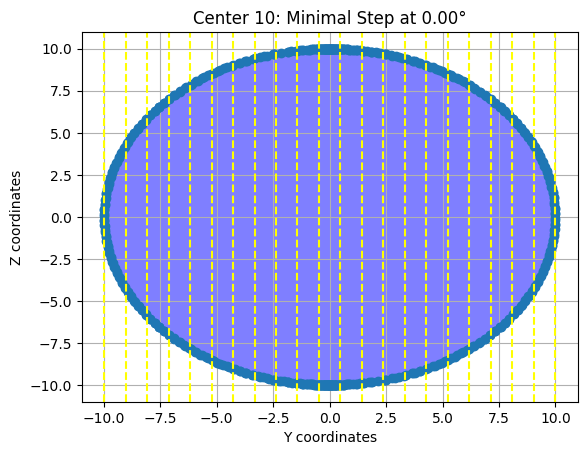

Center 10:
Y lines: [-9.98377705 -9.03294114 -8.08210523 -7.13126932 -6.18043341 -5.2295975
 -4.27876159 -3.32792568 -2.37708977 -1.42625386 -0.47541795  0.47541795
  1.42625386  2.37708977  3.32792568  4.27876159  5.2295975   6.18043341
  7.13126932  8.08210523  9.03294114  9.98377705]


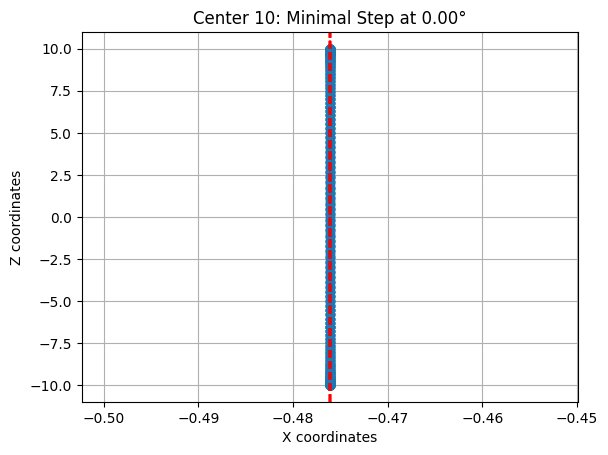

Center 10:
X lines: [-0.47613049 -0.47613049 -0.47613049 -0.47613049 -0.47613049 -0.47613049
 -0.47613049 -0.47613049 -0.47613049 -0.47613049 -0.47613049 -0.47613049
 -0.47613049 -0.47613049 -0.47613049 -0.47613049 -0.47613049 -0.47613049
 -0.47613049 -0.47613049 -0.47613049 -0.47613049]
  Line -9.983777046203613: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -9.032941137041364: Zmin = -4.255866039391235, Zmax = 4.255866490983322
  Line -8.082105227879115: Zmin = -5.866707737857692, Zmax = 5.866706767883359
  Line -7.131269318716867: Zmin = -6.992712506168079, Zmax = 6.992712062350585
  Line -6.180433409554618: Zmin = -7.844864038586995, Zmax = 7.844864302223492
  Line -5.2295975003923685: Zmin = -8.507232018201414, Zmax = 8.507231212249957
  Line -4.27876159123012: Zmin = -9.024930910191085, Zmax = 9.024930916396645
  Line -3.327925682067871: Zmin = -9.416692684220868, Zmax = 9.416692363605431
  Line -2.377089772905622: Zmin = -9.700492634630619, Zmax = 9.700492071984

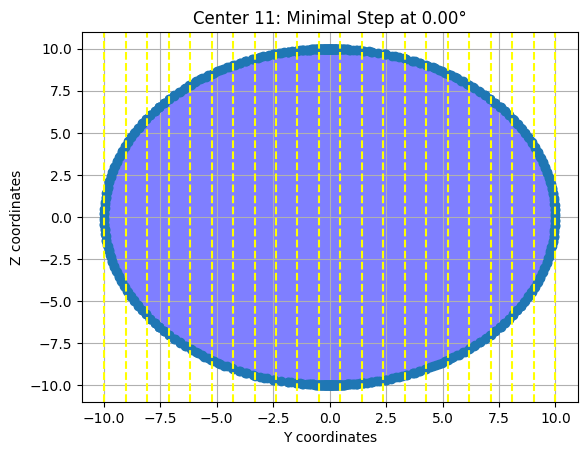

Center 11:
Y lines: [-9.98377705 -9.03294114 -8.08210523 -7.13126932 -6.18043341 -5.2295975
 -4.27876159 -3.32792568 -2.37708977 -1.42625386 -0.47541795  0.47541795
  1.42625386  2.37708977  3.32792568  4.27876159  5.2295975   6.18043341
  7.13126932  8.08210523  9.03294114  9.98377705]


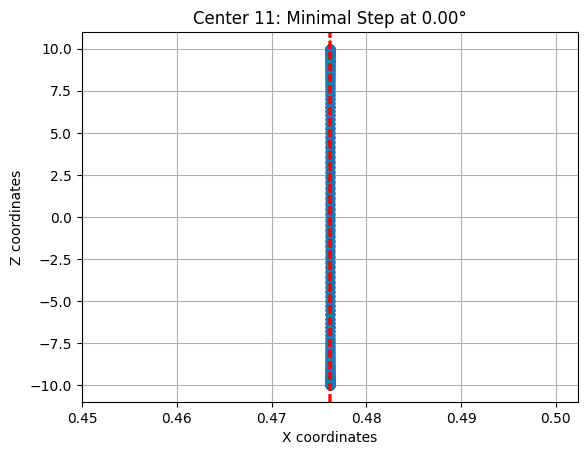

Center 11:
X lines: [0.47613049 0.47613049 0.47613049 0.47613049 0.47613049 0.47613049
 0.47613049 0.47613049 0.47613049 0.47613049 0.47613049 0.47613049
 0.47613049 0.47613049 0.47613049 0.47613049 0.47613049 0.47613049
 0.47613049 0.47613049 0.47613049 0.47613049]
  Line -9.983777046203613: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -9.032941137041364: Zmin = -4.255866490983322, Zmax = 4.255866039391235
  Line -8.082105227879115: Zmin = -5.866706767883359, Zmax = 5.866707737857692
  Line -7.131269318716867: Zmin = -6.992712062350585, Zmax = 6.992712506168079
  Line -6.180433409554618: Zmin = -7.844864302223492, Zmax = 7.844864038586995
  Line -5.2295975003923685: Zmin = -8.507231212249957, Zmax = 8.507232018201414
  Line -4.27876159123012: Zmin = -9.024930916396645, Zmax = 9.024930910191085
  Line -3.327925682067871: Zmin = -9.416692363605431, Zmax = 9.416692684220868
  Line -2.377089772905622: Zmin = -9.700492071984932, Zmax = 9.700492634630619
  Line -1.42625386

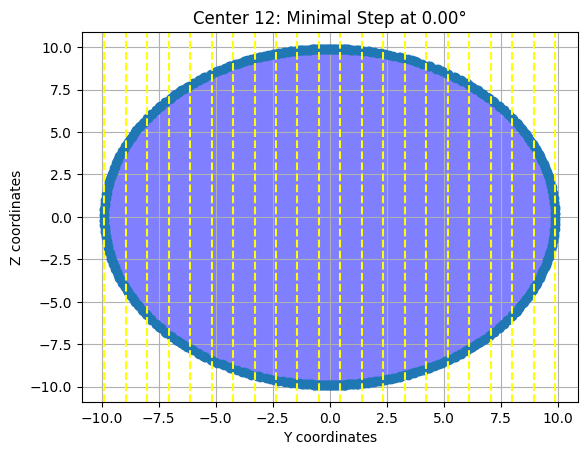

Center 12:
Y lines: [-9.89214897 -8.95003955 -8.00793012 -7.06582069 -6.12371127 -5.18160184
 -4.23949242 -3.29738299 -2.35527356 -1.41316414 -0.47105471  0.47105471
  1.41316414  2.35527356  3.29738299  4.23949242  5.18160184  6.12371127
  7.06582069  8.00793012  8.95003955  9.89214897]


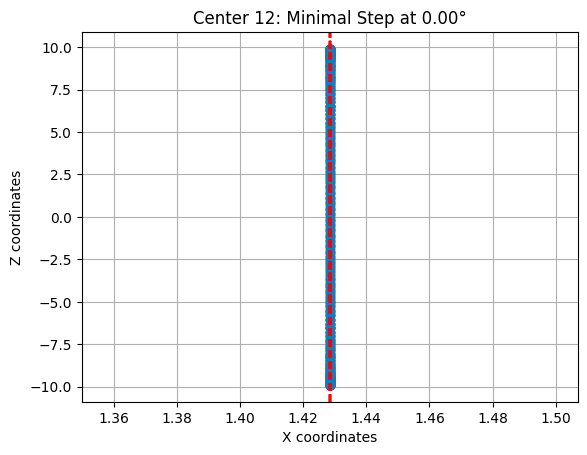

Center 12:
X lines: [1.42839134 1.42839134 1.42839134 1.42839134 1.42839134 1.42839134
 1.42839134 1.42839134 1.42839134 1.42839134 1.42839134 1.42839134
 1.42839134 1.42839134 1.42839134 1.42839134 1.42839134 1.42839134
 1.42839134 1.42839134 1.42839134 1.42839134]
  Line -9.892148971557617: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -8.950039545694986: Zmin = -4.214116692467084, Zmax = 4.214122024723577
  Line -8.007930119832357: Zmin = -5.812737997733214, Zmax = 5.812738017383296
  Line -7.065820693969727: Zmin = -6.926794173470885, Zmax = 6.926792612865583
  Line -6.123711268107096: Zmin = -7.771696227584754, Zmax = 7.771697796854629
  Line -5.181601842244466: Zmin = -8.43077443891937, Zmax = 8.430774232390124
  Line -4.239492416381836: Zmin = -8.941555976270587, Zmax = 8.94155627708896
  Line -3.297382990519205: Zmin = -9.330053029736252, Zmax = 9.330052270071771
  Line -2.3552735646565752: Zmin = -9.611953632335124, Zmax = 9.61195410508506
  Line -1.4131641387

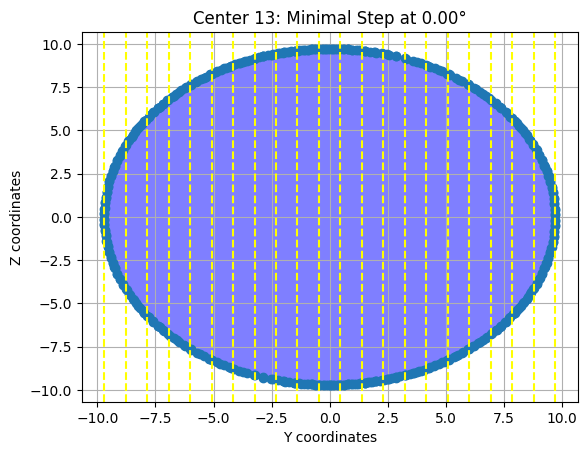

Center 13:
Y lines: [-9.70829105 -8.78369191 -7.85909276 -6.93449361 -6.00989446 -5.08529531
 -4.16069617 -3.23609702 -2.31149787 -1.38689872 -0.46229957  0.46229957
  1.38689872  2.31149787  3.23609702  4.16069617  5.08529531  6.00989446
  6.93449361  7.85909276  8.78369191  9.70829105]


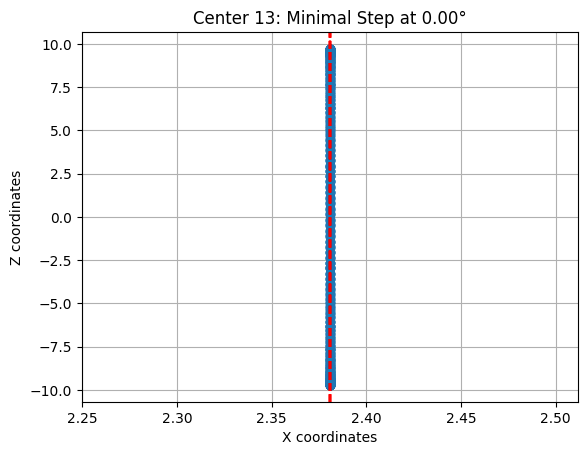

Center 13:
X lines: [2.3806529 2.3806529 2.3806529 2.3806529 2.3806529 2.3806529 2.3806529
 2.3806529 2.3806529 2.3806529 2.3806529 2.3806529 2.3806529 2.3806529
 2.3806529 2.3806529 2.3806529 2.3806529 2.3806529 2.3806529 2.3806529
 2.3806529]
  Line -9.708291053771973: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -8.78369190579369: Zmin = -4.1375157125003605, Zmax = 4.13751541418231
  Line -7.859092757815406: Zmin = -5.6996014680017, Zmax = 5.699603275315717
  Line -6.934493609837123: Zmin = -6.796989500902589, Zmax = 6.796989625567474
  Line -6.00989446185884: Zmin = -7.628906483996428, Zmax = 7.628906479001377
  Line -5.085295313880557: Zmin = -8.27356202967133, Zmax = 8.273562232575856
  Line -4.160696165902274: Zmin = -8.774098477078928, Zmax = 8.774098246116745
  Line -3.2360970179239903: Zmin = -9.157056202216562, Zmax = 9.15705635508553
  Line -2.3114978699457076: Zmin = -9.431785312738034, Zmax = 9.431785931498943
  Line -1.386898721967425: Zmin = -9.6117538

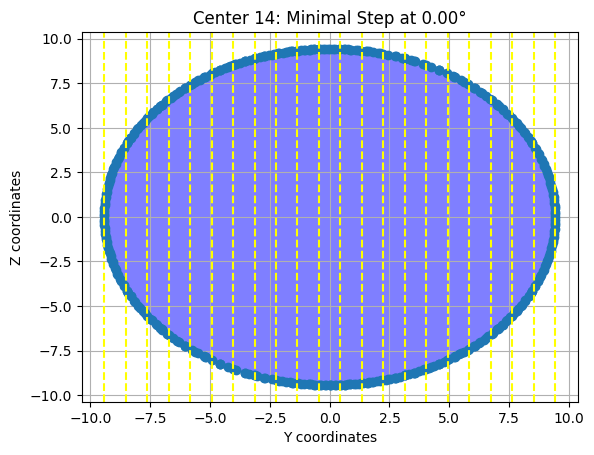

Center 14:
Y lines: [-9.42183399 -8.52451647 -7.62719895 -6.72988142 -5.8325639  -4.93524638
 -4.03792885 -3.14061133 -2.24329381 -1.34597628 -0.44865876  0.44865876
  1.34597628  2.24329381  3.14061133  4.03792885  4.93524638  5.8325639
  6.72988142  7.62719895  8.52451647  9.42183399]


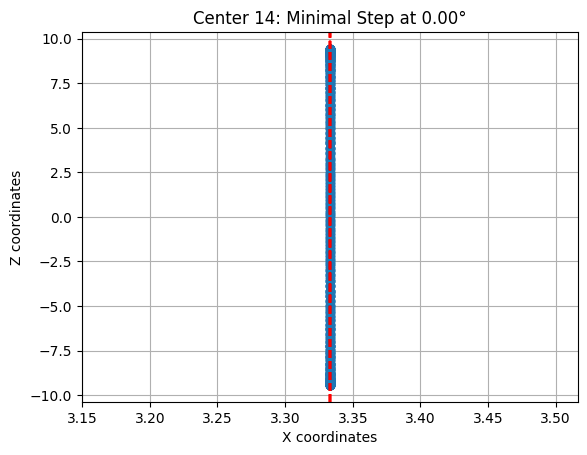

Center 14:
X lines: [3.33291292 3.33291292 3.33291292 3.33291292 3.33291292 3.33291292
 3.33291292 3.33291292 3.33291292 3.33291292 3.33291292 3.33291292
 3.33291292 3.33291292 3.33291292 3.33291292 3.33291292 3.33291292
 3.33291292 3.33291292 3.33291292 3.33291292]
  Line -9.421833992004395: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -8.524516468956357: Zmin = -4.02222047889106, Zmax = 4.022218868077442
  Line -7.62719894590832: Zmin = -5.5361411908192215, Zmax = 5.536141113420001
  Line -6.729881422860282: Zmin = -6.59813843823784, Zmax = 6.598135070017334
  Line -5.832563899812245: Zmin = -7.404103011559976, Zmax = 7.4041011001093
  Line -4.935246376764207: Zmin = -8.03057056240004, Zmax = 8.03057029200716
  Line -4.037928853716169: Zmin = -8.518303218769141, Zmax = 8.518303231743934
  Line -3.140611330668132: Zmin = -8.889606848918541, Zmax = 8.889606608356557
  Line -2.243293807620094: Zmin = -9.156430191778346, Zmax = 9.156430327580239
  Line -1.34597628457205

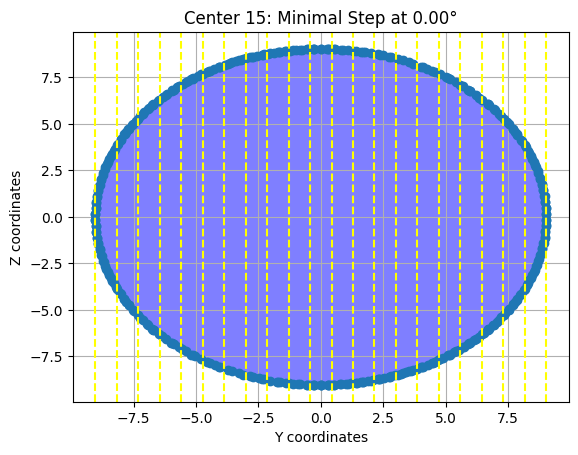

Center 15:
Y lines: [-9.03290558 -8.17262886 -7.31235214 -6.45207541 -5.59179869 -4.73152197
 -3.87124525 -3.01096853 -2.1506918  -1.29041508 -0.43013836  0.43013836
  1.29041508  2.1506918   3.01096853  3.87124525  4.73152197  5.59179869
  6.45207541  7.31235214  8.17262886  9.03290558]


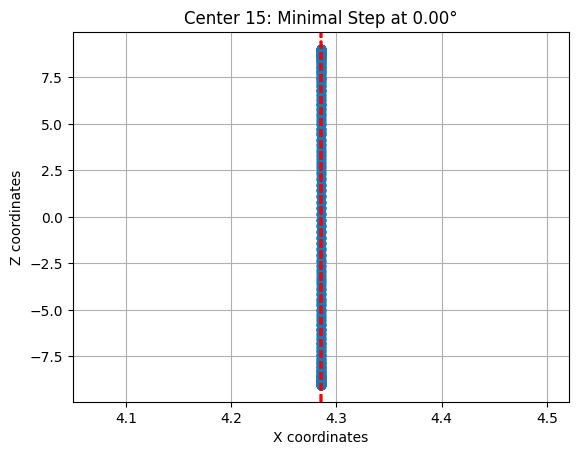

Center 15:
X lines: [4.28517532 4.28517532 4.28517532 4.28517532 4.28517532 4.28517532
 4.28517532 4.28517532 4.28517532 4.28517532 4.28517532 4.28517532
 4.28517532 4.28517532 4.28517532 4.28517532 4.28517532 4.28517532
 4.28517532 4.28517532 4.28517532 4.28517532]
  Line -9.032905578613281: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -8.172628856840587: Zmin = -3.842698059014375, Zmax = 3.8426973906141595
  Line -7.312352135067894: Zmin = -5.29977489907937, Zmax = 5.299776829299967
  Line -6.452075413295201: Zmin = -6.320579333997009, Zmax = 6.320579567618103
  Line -5.5917986915225075: Zmin = -7.0921735784576745, Zmax = 7.092171781233789
  Line -4.731521969749814: Zmin = -7.694333268985112, Zmax = 7.694332907618623
  Line -3.8712452479771207: Zmin = -8.16077830499769, Zmax = 8.16077832379694
  Line -3.0109685262044277: Zmin = -8.516291657639314, Zmax = 8.516291729831414
  Line -2.150691804431734: Zmin = -8.773362788364391, Zmax = 8.773363089697455
  Line -1.290415

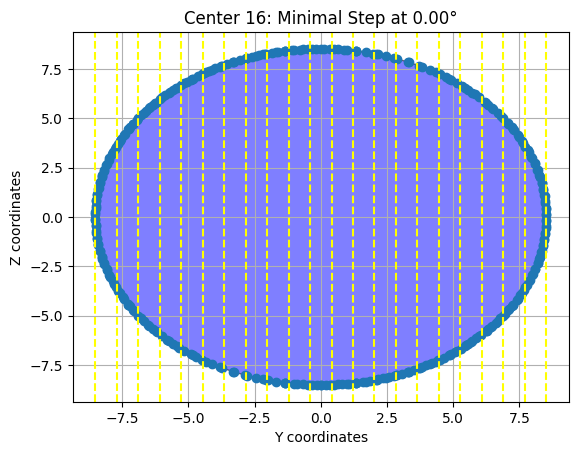

Center 16:
Y lines: [-8.51327896 -7.70249049 -6.89170202 -6.08091354 -5.27012507 -4.4593366
 -3.64854813 -2.83775965 -2.02697118 -1.21618271 -0.40539424  0.40539424
  1.21618271  2.02697118  2.83775965  3.64854813  4.4593366   5.27012507
  6.08091354  6.89170202  7.70249049  8.51327896]


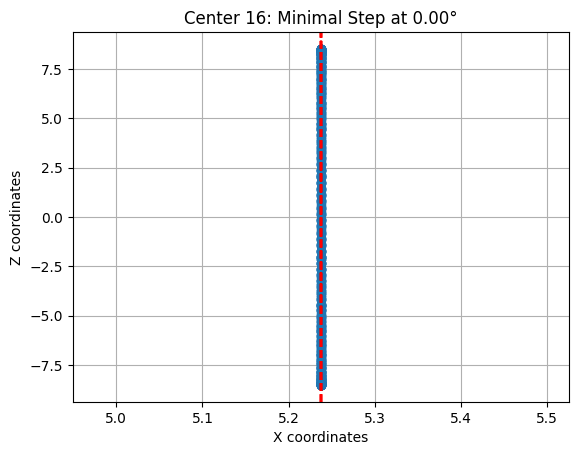

Center 16:
X lines: [5.23743439 5.23743439 5.23743439 5.23743439 5.23743439 5.23743439
 5.23743439 5.23743439 5.23743439 5.23743439 5.23743439 5.23743439
 5.23743439 5.23743439 5.23743439 5.23743439 5.23743439 5.23743439
 5.23743439 5.23743439 5.23743439 5.23743439]
  Line -8.51327896118164: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -7.702490488688151: Zmin = -3.624870798705506, Zmax = 3.624873021305878
  Line -6.891702016194661: Zmin = -5.000677060745399, Zmax = 5.000677047606452
  Line -6.080913543701172: Zmin = -5.959285680161421, Zmax = 5.959288794853263
  Line -5.270125071207682: Zmin = -6.687049226628573, Zmax = 6.687049337250477
  Line -4.459336598714192: Zmin = -7.255559544032732, Zmax = 7.255559825680094
  Line -3.648548126220703: Zmin = -7.694689090806666, Zmax = 7.694690077217902
  Line -2.837759653727213: Zmin = -8.030809084964627, Zmax = 8.030809395572037
  Line -2.0269711812337237: Zmin = -8.27230774781071, Zmax = 8.272307358557319
  Line -1.216182708

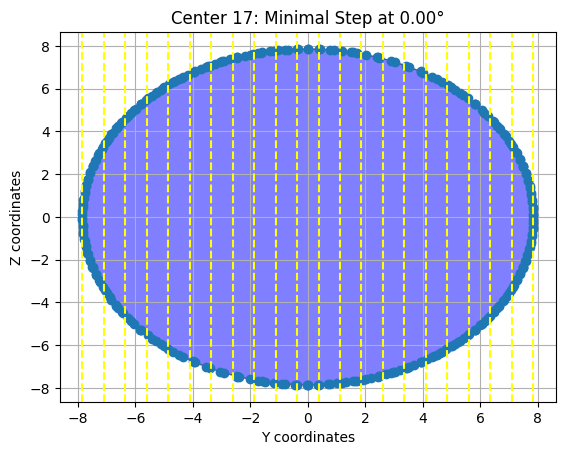

Center 17:
Y lines: [-7.84668541 -7.09938204 -6.35207866 -5.60477529 -4.85747192 -4.11016855
 -3.36286518 -2.6155618  -1.86825843 -1.12095506 -0.37365169  0.37365169
  1.12095506  1.86825843  2.6155618   3.36286518  4.11016855  4.85747192
  5.60477529  6.35207866  7.09938204  7.84668541]


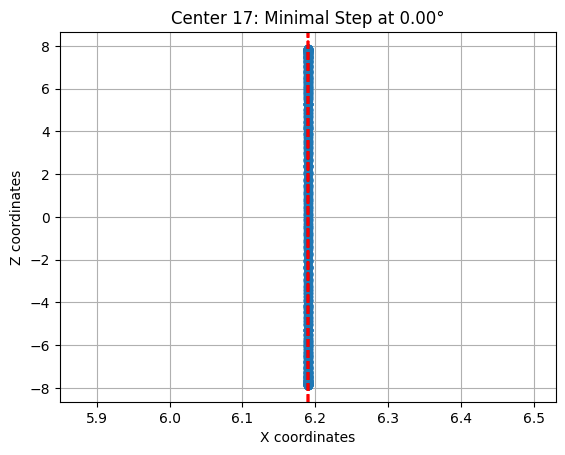

Center 17:
X lines: [6.18969631 6.18969631 6.18969631 6.18969631 6.18969631 6.18969631
 6.18969631 6.18969631 6.18969631 6.18969631 6.18969631 6.18969631
 6.18969631 6.18969631 6.18969631 6.18969631 6.18969631 6.18969631
 6.18969631 6.18969631 6.18969631 6.18969631]
  Line -7.846685409545898: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -7.099382037208194: Zmin = -3.344074773912582, Zmax = 3.3440771502672515
  Line -6.352078664870489: Zmin = -4.609779915011685, Zmax = 4.609780462060744
  Line -5.604775292532785: Zmin = -5.4958010467467995, Zmax = 5.495800454811917
  Line -4.85747192019508: Zmin = -6.165122922167839, Zmax = 6.165120764447319
  Line -4.110168547857375: Zmin = -6.687416672079556, Zmax = 6.687416552508064
  Line -3.362865175519671: Zmin = -7.095161745910766, Zmax = 7.095161723733745
  Line -2.615561803181966: Zmin = -7.401825216718101, Zmax = 7.401826201085934
  Line -1.8682584308442616: Zmin = -7.625370838467168, Zmax = 7.625370159748543
  Line -1.120955

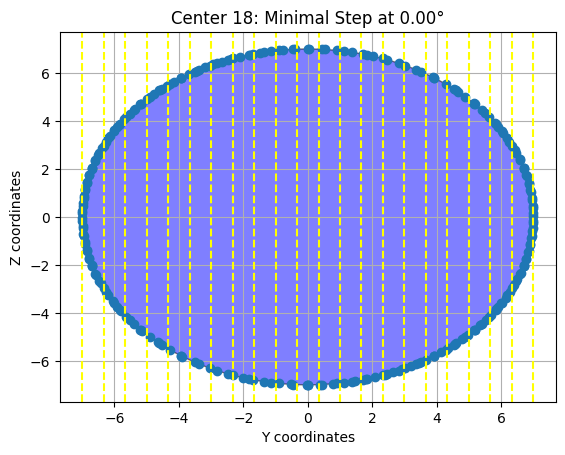

Center 18:
Y lines: [-6.99142313 -6.32557331 -5.65972349 -4.99387366 -4.32802384 -3.66217402
 -2.9963242  -2.33047438 -1.66462455 -0.99877473 -0.33292491  0.33292491
  0.99877473  1.66462455  2.33047438  2.9963242   3.66217402  4.32802384
  4.99387366  5.65972349  6.32557331  6.99142313]


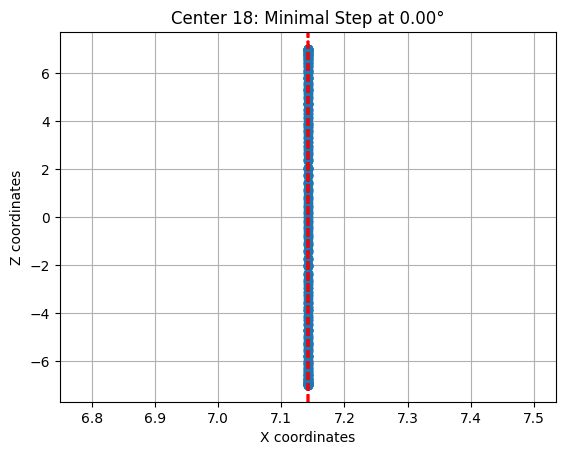

Center 18:
X lines: [7.14195728 7.14195728 7.14195728 7.14195728 7.14195728 7.14195728
 7.14195728 7.14195728 7.14195728 7.14195728 7.14195728 7.14195728
 7.14195728 7.14195728 7.14195728 7.14195728 7.14195728 7.14195728
 7.14195728 7.14195728 7.14195728 7.14195728]
  Line -6.9914231300354: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -6.325573308127267: Zmin = -2.9810097304826226, Zmax = 2.9810098735989303
  Line -5.659723486219134: Zmin = -4.107721749288696, Zmax = 4.107718415703745
  Line -4.993873664311: Zmin = -4.895762316501515, Zmax = 4.895761907036829
  Line -4.328023842402867: Zmin = -5.49415497737425, Zmax = 5.49415188741189
  Line -3.6621740204947337: Zmin = -5.957675670919531, Zmax = 5.957673326821799
  Line -2.9963241985866: Zmin = -6.32113558464409, Zmax = 6.321136635299476
  Line -2.330474376678467: Zmin = -6.59850364424414, Zmax = 6.598503763838258
  Line -1.6646245547703336: Zmin = -6.794753362490104, Zmax = 6.79475371419505
  Line -0.9987747328622003

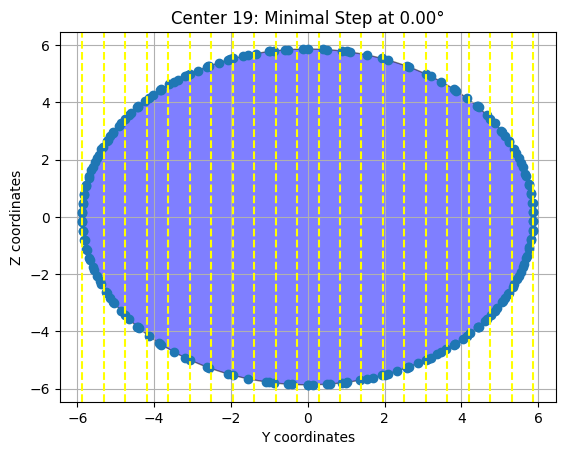

Center 19:
Y lines: [-5.86965322 -5.31063863 -4.75162404 -4.19260945 -3.63359485 -3.07458026
 -2.51556567 -1.95655107 -1.39753648 -0.83852189 -0.2795073   0.2795073
  0.83852189  1.39753648  1.95655107  2.51556567  3.07458026  3.63359485
  4.19260945  4.75162404  5.31063863  5.86965322]


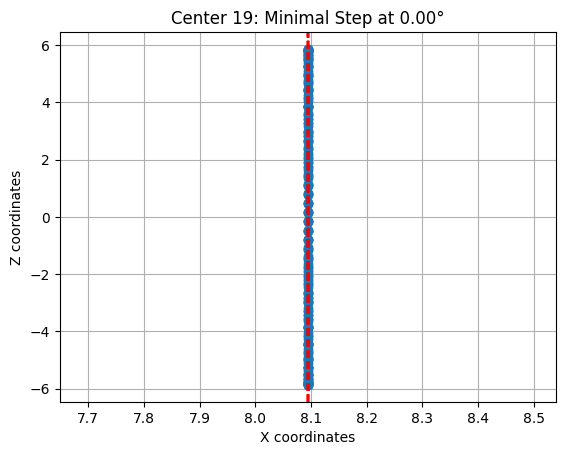

Center 19:
X lines: [8.09421825 8.09421825 8.09421825 8.09421825 8.09421825 8.09421825
 8.09421825 8.09421825 8.09421825 8.09421825 8.09421825 8.09421825
 8.09421825 8.09421825 8.09421825 8.09421825 8.09421825 8.09421825
 8.09421825 8.09421825 8.09421825 8.09421825]
  Line -5.869653224945068: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -5.310638632093157: Zmin = -2.4876466140419575, Zmax = 2.487657272773972
  Line -4.751624039241246: Zmin = -3.434342451165662, Zmax = 3.4343411642416504
  Line -4.192609446389334: Zmin = -4.100262917123015, Zmax = 4.100263410659245
  Line -3.6335948535374234: Zmin = -4.603563287906292, Zmax = 4.603562765922728
  Line -3.0745802606855124: Zmin = -4.997858085517082, Zmax = 4.997857992686006
  Line -2.515565667833601: Zmin = -5.300920995467927, Zmax = 5.300920923547586
  Line -1.9565510749816895: Zmin = -5.532191990182339, Zmax = 5.5321916352498945
  Line -1.3975364821297784: Zmin = -5.6967411574801385, Zmax = 5.696742349669561
  Line -0.

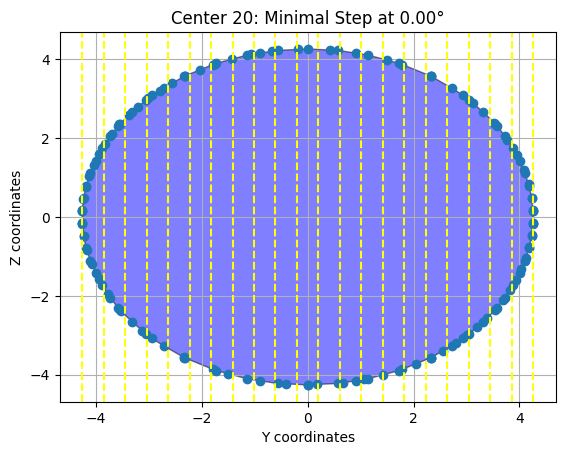

Center 20:
Y lines: [-4.25853443 -3.85295972 -3.44738502 -3.04181031 -2.6362356  -2.23066089
 -1.82508618 -1.41951148 -1.01393677 -0.60836206 -0.20278735  0.20278735
  0.60836206  1.01393677  1.41951148  1.82508618  2.23066089  2.6362356
  3.04181031  3.44738502  3.85295972  4.25853443]


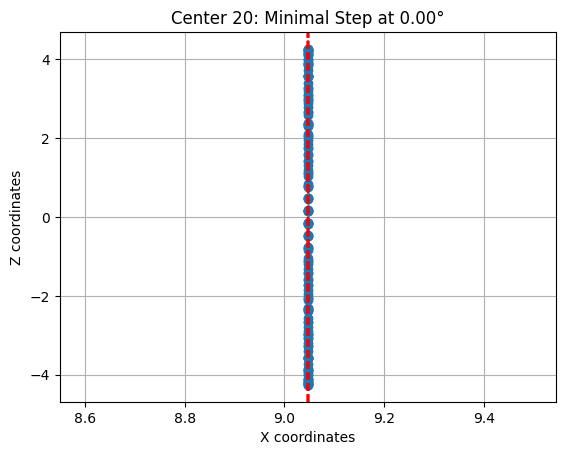

Center 20:
X lines: [9.04648018 9.04648018 9.04648018 9.04648018 9.04648018 9.04648018
 9.04648018 9.04648018 9.04648018 9.04648018 9.04648018 9.04648018
 9.04648018 9.04648018 9.04648018 9.04648018 9.04648018 9.04648018
 9.04648018 9.04648018 9.04648018 9.04648018]
  Line -4.2585344314575195: Zmin = -0.15865999460220337, Zmax = 0.15865999460220337
  Line -3.8529597236996604: Zmin = -1.7913755944221075, Zmax = 1.7913780209878052
  Line -3.4473850159418014: Zmin = -2.488325436783042, Zmax = 2.4883262293464394
  Line -3.0418103081839427: Zmin = -2.9761315430106956, Zmax = 2.9761318079718895
  Line -2.6362356004260836: Zmin = -3.332748089376211, Zmax = 3.3327478925653087
  Line -2.2306608926682245: Zmin = -3.6229787689905653, Zmax = 3.6229764486207015
  Line -1.825086184910366: Zmin = -3.844085266361975, Zmax = 3.844084263167491
  Line -1.4195114771525068: Zmin = -4.004792685260518, Zmax = 4.004793533329604
  Line -1.0139367693946477: Zmin = -4.131466211749596, Zmax = 4.131465771153985
  

Widget(value='<iframe src="http://localhost:55385/index.html?ui=P_0x1b0b889f160_4&reconnect=auto" class="pyvis…

32223

In [8]:
"""Creation of orthogonal cross sections (perpendicular to the secondary horizontal main axis)"""
import os
import pyvista as pv
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation as R
from sklearn.preprocessing import MinMaxScaler
import matplotlib.cm as cm
from shapely.geometry import LineString
import json
import gc

%load_ext memory_profiler
%memit

#retrieve saved center_points
with open('center_points.json', 'r') as f:
    center_points = json.load(f)
# Convert keys by extracting numbers from string keys and converting values to NumPy arrays
center_points = {
    int(k.split('_')[-1]): np.array(v) 
    for k, v in center_points.items() 
    if int(k.split('_')[-1]) != 0  # Skip the entry with index 0
}

# Load rotated normals
with open('rotated_normals.json', 'r') as f:
    rotated_normals = json.load(f)
rotated_normals = {
    int(k.split('_')[-1]): np.array(v)  # Extract the number from the key
    for k, v in rotated_normals.items()
}
 
# Load min_step_dict and min_area_dict from JSON files
try:
    with open('min_steps.json', 'r') as f:
        min_steps = json.load(f)
    with open('min_area_dict.json', 'r') as f:
        min_area_dict = json.load(f)

    # Convert keys to integers if they are stored as strings in the JSON files
    min_steps = {int(k): v for k, v in min_steps.items()}   
    min_area_dict = {int(k): v for k, v in min_area_dict.items()}
except FileNotFoundError as e:
    print(f"Error loading dictionaries: {e}")
    min_step_dict = {}
    min_area_dict = {}



# Directory containing the manually corrected linestrings
save_dir = r"C:\Users\carl\Desktop\Zwischenschritte\sphere_model"

# Check if the directory exists
if os.path.exists(save_dir):
    corrected_files = os.listdir(save_dir)
else:
    corrected_files = []

combined_linestrings = {}

# Function to compute the area using the shoelace formula
def shoelace_area(vertices):
    n = len(vertices)
    area = 0.5 * abs(sum(vertices[i][0]*vertices[(i+1) % n][1] - vertices[i][1]*vertices[(i+1) % n][0] for i in range(n)))
    return area

# Normalize the vertices
def normalize_values(vertices):
    scaler = MinMaxScaler()
    normalized_vertices = scaler.fit_transform(vertices)
    return normalized_vertices

def ensure_continuous_loop(points):
    if points[0] != points[-1]:
        points.append(points[0])
    return points

def ensure_continuous_loop(points):
    # Check if the first point is not equal to the last point
    if not np.array_equal(points[0], points[-1]):
        # If they are not equal, append the first point to the end to close the loop
        points = np.vstack([points, points[0]])
    return points

# Function to load the saved corrected vertex order
def load_corrected_vertex_order(file_path):
    try:
        if os.path.exists(file_path):
            return np.load(file_path)
        else:
            raise FileNotFoundError(f"File '{file_path}' not found.")
    except Exception as e:
        return None

# Function to combine manually corrected linestrings and automatically corrected linestrings into "combined_linestrings"
def combine_vertex_order_with_coords(linestring, center_index, section_type):
    section_name = f"corrected_vertices_direction_{section_type.replace(' ', '_')}_center_{center_index}.npy"
    file_path = os.path.join(save_dir, section_name)

    corrected_vertex_order = load_corrected_vertex_order(file_path)

    if corrected_vertex_order is not None:
        try:
            coords = np.array(linestring.coords)
            corrected_coords = coords[corrected_vertex_order]
            return LineString(corrected_coords)
        except Exception as e:
            print(f"Error combining vertex order with coordinates: {e}")
            return linestring
    else:
        return linestring

# Update linestrings with corrected data using the new function
for key, linestring in linestrings_rearranged.items():
    combined_linestrings[key] = combine_vertex_order_with_coords(linestring, key, "Section dir1")


"""the following 2 functions subdivide sections of 1st direction vertically into 22 intervals & determine the x & y coordinates of these lines""" 
#Function to compute y-range and evenly spaced lines for 22 subdivisions
def compute_y_range_and_lines(ys, num_lines=22):
    y_min, y_max = min(ys), max(ys)
    y_lines = np.linspace(y_min, y_max, num_lines)  # Equally spaced y-values for lines
    return y_lines

# Function to compute x-range and evenly spaced lines for 22 subdivisions
def compute_x_range_and_lines(xs, num_lines=22):
    x_min, x_max = min(xs), max(xs)
    x_lines = np.linspace(x_min, x_max, num_lines)  # Equally spaced x-values for lines
    return x_lines


#plotting the vertical lines
def plot_with_vertical_y_lines(ys, zs, title, y_lines, zmin_zmax_for_section):
    plt.figure()
    
    # Fill the area of the shape in blue
    plt.fill(ys, zs, 'b', edgecolor='black', alpha=0.5)
    
    # Plot points
    plt.plot(ys, zs, 'o')
    
    # Add vertical lines
    for idx, y_line in enumerate(y_lines):
        plt.axvline(x=y_line, color='yellow', linestyle='--', label=f'Line {idx + 1}' if idx < len(y_lines) - 1 else None)

    # Customize plot appearance
    plt.title(title)
    plt.xlabel('Y coordinates')
    plt.ylabel('Z coordinates')
    plt.grid(True)
    
    # Show plot
    plt.show()

# Function to plot the 2D XZ projection with vertical lines
def plot_with_vertical_x_lines(xs, zs, title, x_lines, zmin_zmax_for_section):
    plt.figure()
    
    # Fill the area of the shape in blue
    plt.fill(xs, zs, 'b', edgecolor='black', alpha=0.5)
    
    # Plot points
    plt.plot(xs, zs, 'o')
    
    # Add vertical lines
    for idx, x_line in enumerate(x_lines):
        plt.axvline(x=x_line, color='red', linestyle='--', label=f'Line {idx + 1}' if idx < len(x_lines) - 1 else None)

    # Customize plot appearance
    plt.title(title)
    plt.xlabel('X coordinates')
    plt.ylabel('Z coordinates')
    plt.grid(True)
    
    # Show plot
    plt.show()



"""following 2 functions determine the z values of the lines, where the lines intersect the polygon edge (only one of the functions is run per cross 
section of the 1st direction, depending on its orientation"""
def find_zmin_zmax_for_y_line(points, y_value):
    min_z_value = float('inf')
    max_z_value = -float('inf')
    
    for i in range(len(points)):
        _, y1, z1 = points[i]  # Unpack x, y, and z (ignore x)
        _, y2, z2 = points[(i + 1) % len(points)]  # Unpack next point (ignore x)
        
        # Check if the y_value intersects with the edge (y1, y2)
        if min(y1, y2) <= y_value <= max(y1, y2):
            # Calculate the z-value at the intersection of the y_line and the edge
            z_intersection = z1 + (y_value - y1) * (z2 - z1) / (y2 - y1)
            # Update min and max z values
            min_z_value = min(min_z_value, z_intersection)
            max_z_value = max(max_z_value, z_intersection)
    
    # Handle case with no intersections found
    if min_z_value == float('inf') or max_z_value == -float('inf'):
        print(f"No intersections found for y_value: {y_value} with points: {points}")
        return None, None

    return min_z_value, max_z_value


def find_zmin_zmax_for_x_line(points, x_value):
    min_z_value = float('inf')
    max_z_value = -float('inf')
    
    for i in range(len(points)):
        x1, _, z1 = points[i]  # Unpack x, y, and z (ignore y)
        x2, _, z2 = points[(i + 1) % len(points)]  # Unpack next point (ignore y)
        
        # Check if the x_value intersects with the edge (x1, x2)
        if min(x1, x2) <= x_value <= max(x1, x2):
            # Calculate the z-value at the intersection of the x_line and the edge
            z_intersection = z1 + (x_value - x1) * (z2 - z1) / (x2 - x1)
            # Update min and max z values
            min_z_value = min(min_z_value, z_intersection)
            max_z_value = max(max_z_value, z_intersection)
    
    # Handle case with no intersections found
    if min_z_value == float('inf') or max_z_value == -float('inf'):
        print(f"No intersections found for x_value: {x_value} with points: {points}")
        return None, None

    return min_z_value, max_z_value


# Initialize the plotter
plotter = pv.Plotter()

# Create a colormap for different centers
num_centers = len(center_array)
colormap = cm.get_cmap('viridis', num_centers)

# Dictionaries to store data for each section
x_lines_dict = {} 
y_lines_dict = {}
zmin_zmax_dict = {}


for idx, linestring in list(combined_linestrings.items()):
    if idx == 21:
        continue
    points = list(linestring.coords)
    # Calculate area
    sorted_points = ensure_continuous_loop(points)
    area = shoelace_area(sorted_points)

        
    xs, ys, zs = zip(*sorted_points)  # Create lists of x and y values

    y_lines = compute_y_range_and_lines(ys, 22)  # 22 vertical lines
    min_step = min_steps.get(idx, None)

    """in some cases, the index order of the lines has to be reversed depending on their orientation, so that the creation of trapezoidal segments works 
    (see below)"""
    if dx < dy:
        if min_step is not None and (0 <= min_step <= 90 or min_step in [185, 190]):
            y_lines = y_lines[::-1]

    elif dx >= dy:
            y_lines = y_lines
    
    y_lines_dict[idx] = y_lines

    x_lines = compute_x_range_and_lines(xs, 22)  # 22 vertical lines
    min_step = min_steps.get(idx, None)

    if dx < dy:
            x_lines = x_lines

    elif dx >= dy:
        if min_step is not None and (0 <= min_step <= 90 or min_step in [185, 190]):  
            x_lines = x_lines[::-1]

    x_lines_dict[idx] = x_lines
    """if you want optional printing, uncomment the two lines of code below"""
    #for idx, x_lines in x_lines_dict.items():
     #   print(f"Center {idx}: X lines = {x_lines}")
    

    zmin_zmax_for_section = []
    
    # Compute Zmin and Zmax for each line
    if dx < dy:
        if min_step != 0:
            for y_line in y_lines:
                zmin, zmax = find_zmin_zmax_for_y_line(sorted_points, y_line)
                zmin_zmax_for_section.append((y_line, zmin, zmax))
    
        if min_step == 0:
            for x_line in x_lines:
                zmin, zmax = find_zmin_zmax_for_x_line(sorted_points, x_line)
                
                zmin_zmax_for_section.append((x_line, zmin, zmax))

        # Store Zmin and Zmax values for this section
        zmin_zmax_dict[idx] = zmin_zmax_for_section

    elif dx >= dy:    
        if min_step != 90:
            for y_line in y_lines:
                zmin, zmax = find_zmin_zmax_for_y_line(sorted_points, y_line)
                zmin_zmax_for_section.append((y_line, zmin, zmax))
    
        if min_step == 90:
            for x_line in x_lines:
                zmin, zmax = find_zmin_zmax_for_x_line(sorted_points, x_line)
                
                zmin_zmax_for_section.append((x_line, zmin, zmax))

        # Store Zmin and Zmax values for this section
        zmin_zmax_dict[idx] = zmin_zmax_for_section
     

    

    # Access the minimal step and area values from the dictionaries using idx
    if idx in min_steps and idx in min_area_dict:
        min_step = min_steps[idx]  # Get the min_step for this section/center
        min_area = min_area_dict[idx]  # Get the min_area for this section/center
        
        # Plot the 2D YZ projections and XZ projections with vertical lines
        plot_with_vertical_y_lines(ys, zs, f'Center {idx}: Minimal Step at {min_step:.2f}°', y_lines, zmin_zmax_for_section)
        print(f"Center {idx}:")
        print(f"Y lines: {y_lines}")
        
        plot_with_vertical_x_lines(xs, zs, f'Center {idx}: Minimal Step at {min_step:.2f}°', x_lines, zmin_zmax_for_section)
        print(f"Center {idx}:")
        print(f"X lines: {x_lines}")

    #print Z values of lines
    for zmin_zmax in zmin_zmax_for_section:
        line_value = zmin_zmax[0]
        zmin = zmin_zmax[1]
        zmax = zmin_zmax[2]
        print(f"  Line {line_value}: Zmin = {zmin}, Zmax = {zmax}")


"""------------------------------------------------------2nd step CREATION OF ORTHOGONAL SECTIONS---------------------------------------------------"""
# Initialize the plotter for visualization
plotter = pv.Plotter()


# batch processing for faster computation
start_index = 0 if 0 in combined_linestrings else 1
batch_size = 100

# Get the sorted list of keys from combined_linestrings 
keys = sorted(combined_linestrings.keys())


def calculate_horizontal_extent(points):
    """
    Calculate the horizontal extent (in the XY plane) of the trapezoidal segment. Only the distances between horizontal edges (ignoring the 
    z-coordinates) are summed. For name convention of points, see below
    """
    # Extract the x and y coordinates 
    x_a, y_a = points[0][:2]  # Point 1
    x_b, y_b = points[3][:2]  # Point 4

    # Calculate the horizontal distance between points 1 and 4
    horizontal_distance = np.sqrt((x_b - x_a) ** 2 + (y_b - y_a) ** 2)

    if dx < dy:
        if y_a > y_b:  # Cross-sections are crossing, need to be subtracted, see paper discussion
            horizontal_distance *= -1
    else:  # dx >= dy
        if x_a > x_b:  # Cross-sections are crossing, need to be subtracted, see paper discussion
            horizontal_distance *= -1

    return horizontal_distance


trapezoidal_segments = {n: [] for n in range(22)}
perpendicular_section = {n: [] for n in range(22)}
horizontal_extents = {n: 0 for n in range(22)}


"""setup to create trapezoidal segments out of two lines of same index=n from two consecutive sections of 1st direction (index=i)"""
for batch_start in range(0, len(keys), batch_size):
    batch_end = min(batch_start + batch_size, len(keys))

    for i in range(batch_start, batch_end - 1):
        # Ensure the index does not exceed bounds
        if i + 1 >= len(keys):
            break

        # Use the keys list to access the linestrings
        key_a = keys[i]
        key_b = keys[i + 1]
        
        linestring_a = combined_linestrings[key_a]  # Linestring for section center i='a'
        linestring_b = combined_linestrings[key_b]  # Linestring for section center i='a+1'

        # Extract the points for both linestrings
        points_a = list(linestring_a.coords)
        points_b = list(linestring_b.coords)

        sorted_points_a = ensure_continuous_loop(points_a)
        sorted_points_b = ensure_continuous_loop(points_b)

        xs_a, ys_a, zs_a = zip(*sorted_points_a)  # Y, X and Z coordinates for center 'a'
        xs_b, ys_b, zs_b = zip(*sorted_points_b)  # Y, X and Z coordinates for center 'a+1'

        # Get the y_values, x_values and zmin_zmax for both centers
        y_lines_a = y_lines_dict.get(key_a)
        y_lines_b = y_lines_dict.get(key_b)

        x_lines_a = x_lines_dict.get(key_a)
        x_lines_b = x_lines_dict.get(key_b)
        
        zmin_zmax_a = zmin_zmax_dict.get(key_a)
        zmin_zmax_b = zmin_zmax_dict.get(key_b)


        if x_lines_a is None or x_lines_b is None or y_lines_a is None or y_lines_b is None or zmin_zmax_a is None or zmin_zmax_b is None:
            print(f"Missing data for center {key_a} or {key_b}. Skipping this pair.")
            continue

        # Loop through each index 'n' of orthogonal direction for creating vertical lines
        for n in range(22):
            # Extract fixed coordinates for center 'a'
            x_a = x_lines_a[n]                          # X-coordinate from x_lines 
            y_a = y_lines_a[n]                          # Y-coordinate from y_lines
            zmin_a, zmax_a = zmin_zmax_a[n][1], zmin_zmax_a[n][2]  # Zmin and Zmax for 'a'

            # Extract fixed coordinates for center 'a+1'
            x_b =  x_lines_b[n]                             # X-coordinate for 'a+1'
            y_b = y_lines_b[n]                              # Y-coordinate from y_lines for 'a+1'
            zmin_b, zmax_b = zmin_zmax_b[n][1], zmin_zmax_b[n][2]  # Zmin and Zmax for 'a+1'

            points = np.array([
                [x_a, y_a, zmin_a],  # Point 1
                [x_a, y_a, zmax_a],  # Point 2
                [x_b, y_b, zmax_b],  # Point 3
                [x_b, y_b, zmin_b]   # Point 4
            ])

            # Define the face (quad) of the trapezoid by specifying the indices of the points
            faces = np.array([[4, 0, 1, 2, 3]])  # '4' indicates it's a quad (4 points)

                                
            # Calculate the horizontal extent of this trapezoid
            horizontal_extent = calculate_horizontal_extent(points)
            #print(f"Horizontal extent for trapezoidal segment at n={n}: {horizontal_extent}")

            # Add the horizontal extent to the total for this orthogonal section
            horizontal_extents[n] += horizontal_extent

        
            # Create the PolyData with the points and the face
            quad = pv.PolyData(points, faces)
            
            perpendicular_section[n].append(points)

            trapezoidal_segments[n].append(points)

for n, extent in horizontal_extents.items():
    print(f"Perpendicular section {n}: horizontal extent = {extent}")

#saving calculated horizontal extents
with open('horizontal_extents.json', 'w') as json_file:
    json.dump(horizontal_extents, json_file)
print("Horizontal_extents saved to 'Horizontal_extents.json'")

# Save the trapezoidal segments to a JSON file
with open('trapezoidal_segments.json', 'w') as json_file:
    json.dump({n: [points.tolist() for points in segments] for n, segments in trapezoidal_segments.items()}, json_file)
print("Trapezoidal segments saved to 'trapezoidal_segments.json'")


if combined_linestrings:
    max_existing_key = max(combined_linestrings.keys())  # Get the max key from combined_linestrings
else:
    max_existing_key = 0  # In case combined_linestrings is empty

#create combined trapezoids for each index n, starting from the next available key (linestrings from both directions shall be in combined_linestrings)
new_key = max_existing_key + 1


"""combining the trapezoidal segments to form orthogonal cross sections"""
for n, trapezoid_points in perpendicular_section.items(): 
    if trapezoid_points:  # If there are points to create a trapezoid
        # Combine all points into a single array
        combined_points = np.vstack(trapezoid_points)

        # Get rid of duplicate points and create a mesh for the combined trapezoid
        unique_points, unique_indices = np.unique(combined_points, axis=0, return_inverse=True)
        faces = np.array([[4, unique_indices[i], unique_indices[i+1], unique_indices[i+2], unique_indices[i+3]] 
                          for i in range(0, len(unique_indices), 4)])  # Forming quads

        # Create Pyvista PolyData for the combined trapezoid
        combined_quad = pv.PolyData(unique_points, faces)

        #define orthogonal sections you want to plot
        plot_sections = [5, 10, 15]

        if n in plot_sections:
            # Add the combined trapezoid mesh to the plotter
            plotter.add_mesh(combined_quad, color='red', opacity=0.5, label=f'Perpendicular section {n}')

        # Convert trapezoid points into a LineString
        line_coords_perpendicular = [(point[0], point[1], point[2]) for point in unique_points]  
        line_string_perpendicular = LineString(line_coords_perpendicular)

        # Append LineString to combined_linestrings with a unique key
        combined_linestrings[new_key] = line_string_perpendicular
        # Check the number of items in combined_linestrings
        new_key += 1



"""Ensuring, that sections of 1st direction and orthogonal (=perpendicular) sections get correct keys in combined_linestrings"""
Section_dir1_linestrings = {key: linestring for key, linestring in combined_linestrings.items() 
                      if 1 <= key <= 20}  
num_keys_Section_dir1 = len(Section_dir1_linestrings)
print(f"Number of keys belonging to 'Section Dir 1': {num_keys_Section_dir1}")

perpendicular_linestrings = {
    mapped_key: combined_linestrings[old_key] 
    for mapped_key, old_key in enumerate(range(22, 44))  # Map old keys 22 to 42 to new keys 0 to 20
    if old_key in combined_linestrings
}


"""plotting of defined orthogonal sections in 3D"""
# Set plot labels, grid, background, and camera position
plotter.add_mesh(mesh, opacity=0.3, color='white')
plotter.add_axes()
plotter.set_background('white')
plotter.show_grid(color='black')
plotter.view_isometric()

# Set the camera position to view along the Z-axis
plotter.view_vector([1, 0, 1])

# Show the plot
plotter.show()

# Clear memory after plotting
gc.collect()

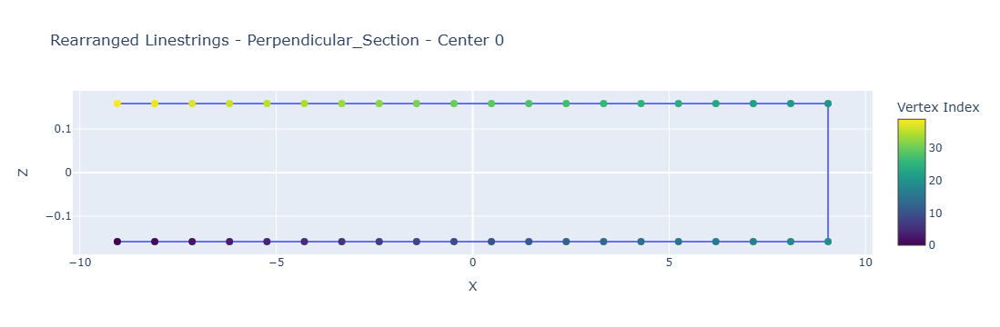

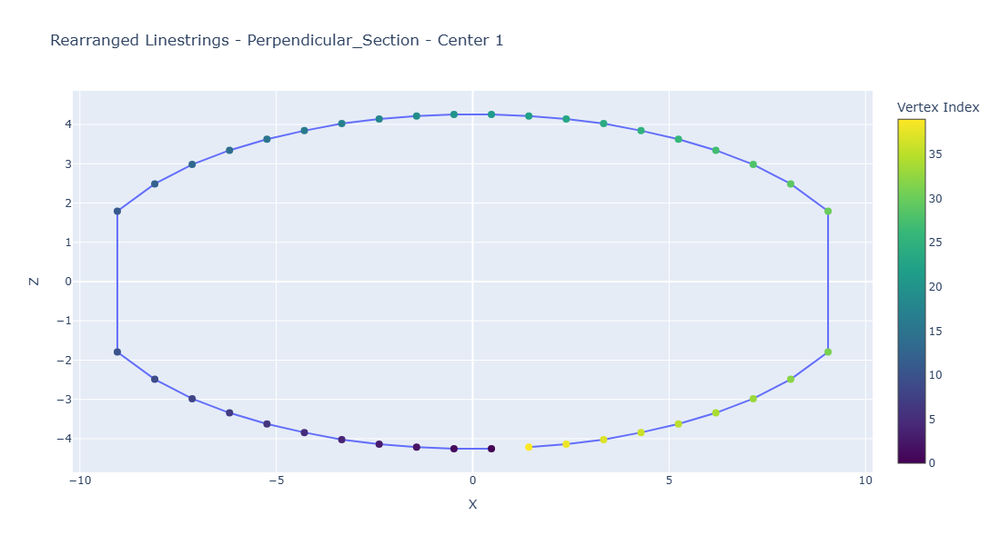

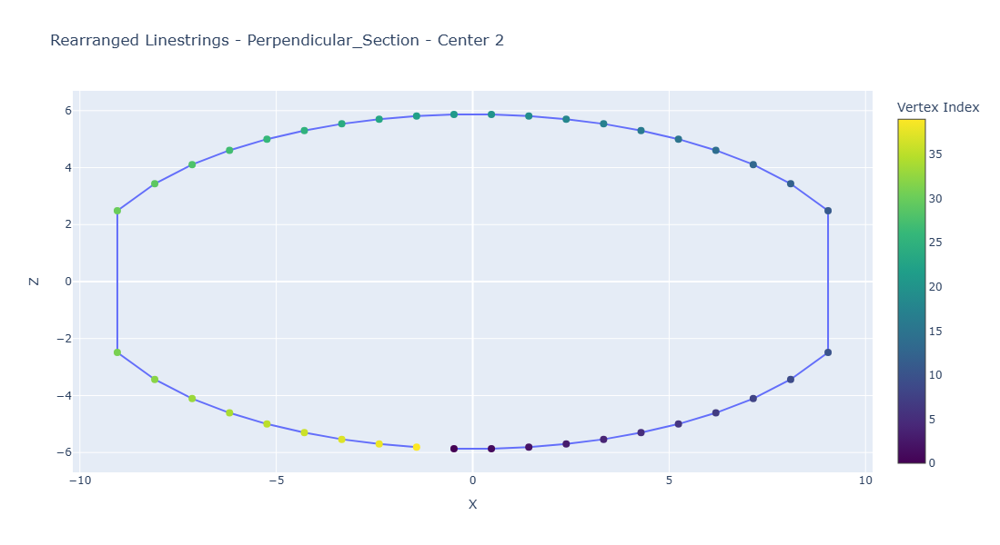

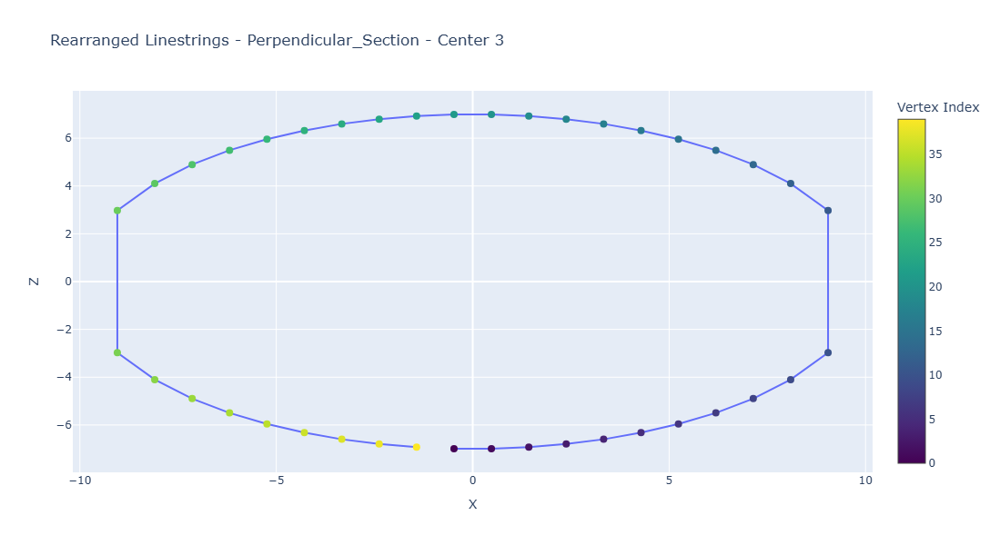

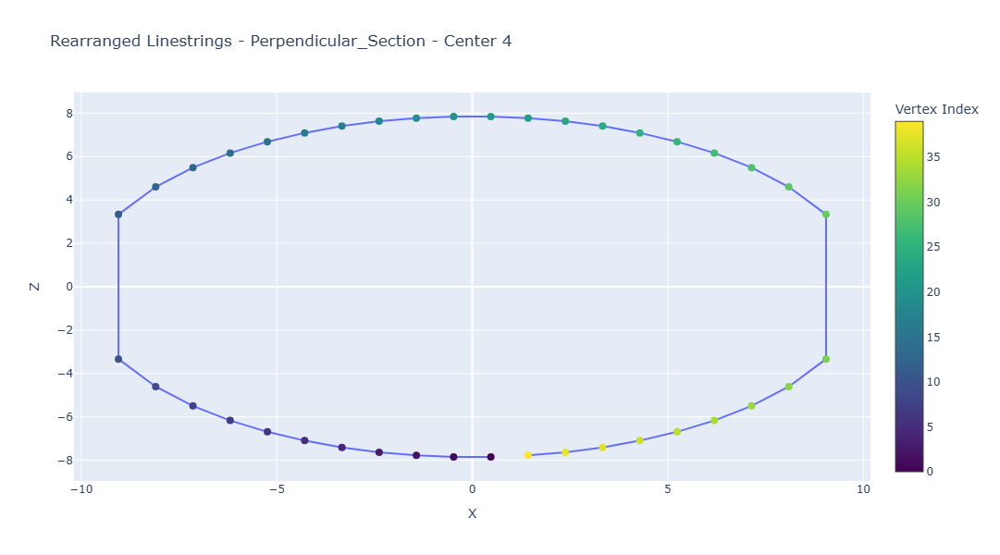

...

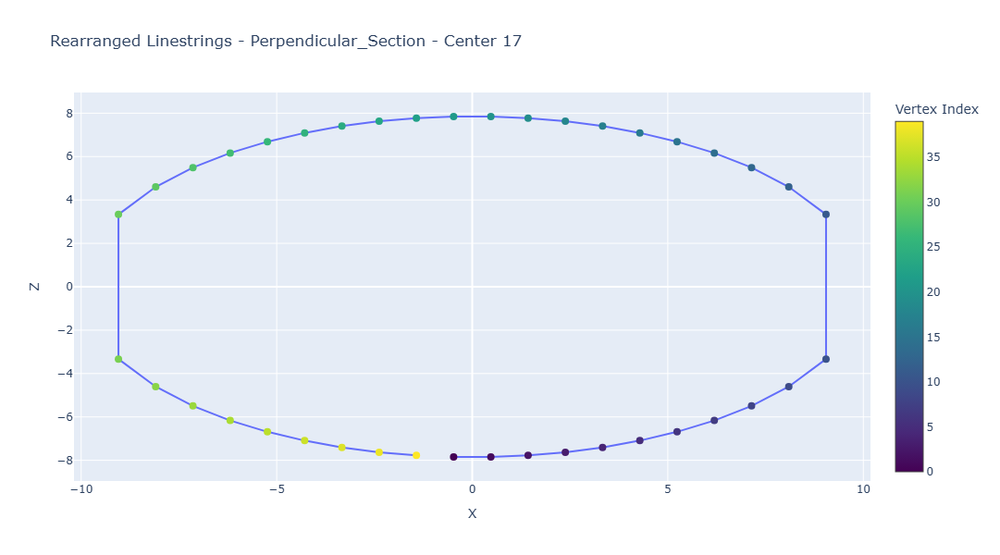

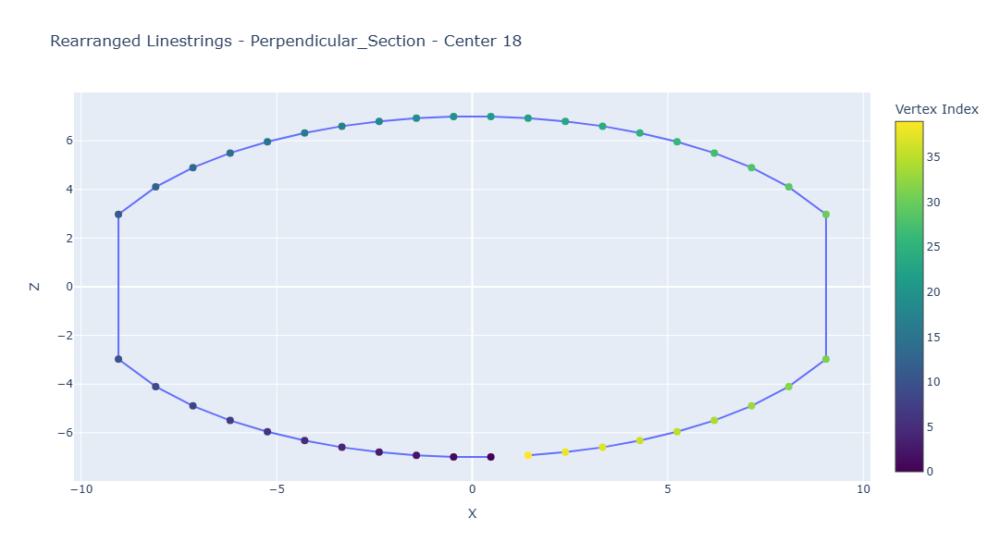

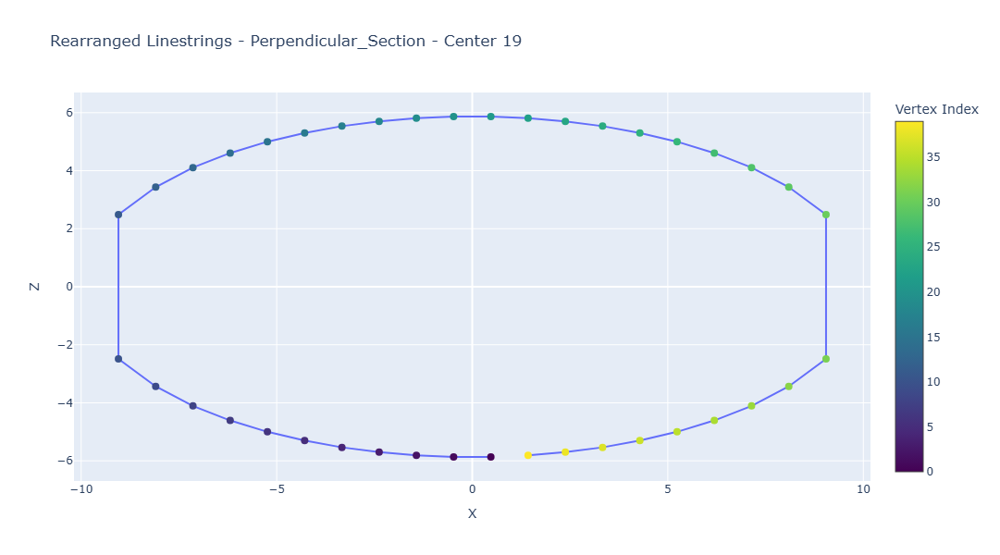

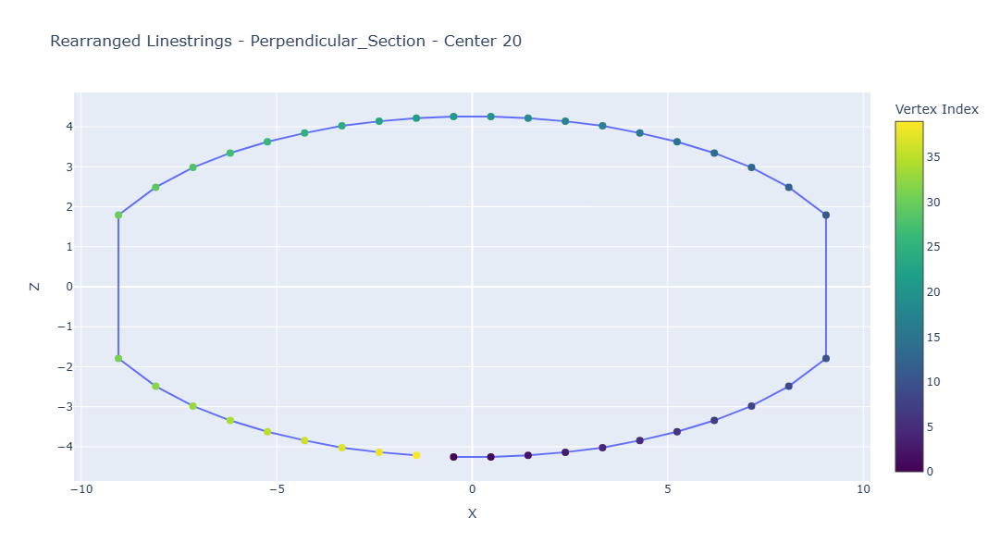

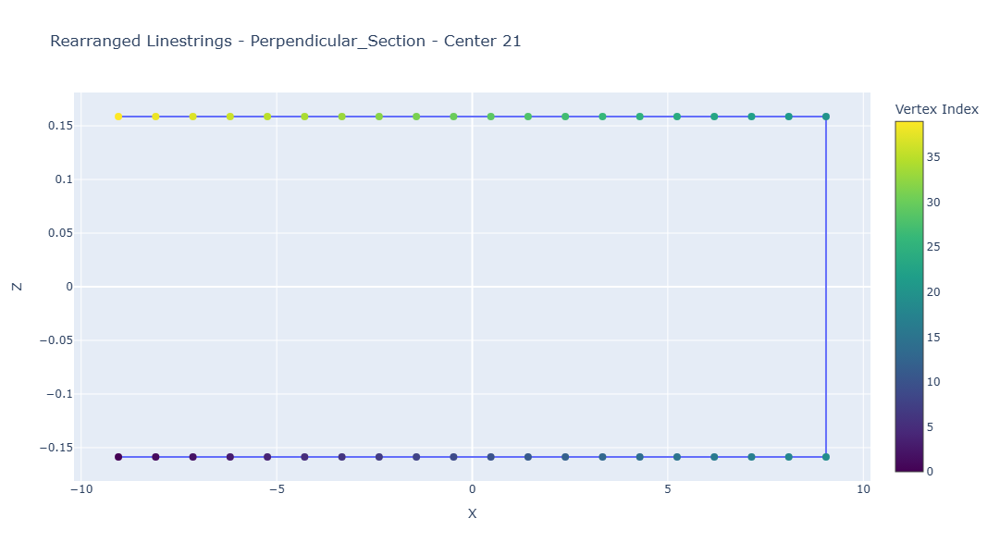

In [9]:
"""Step 1 of artifact correction in orthogonal cross sections: normalized nearest neighbor approach to automatically correct artifacts. 
For explanations on functions, see nearest neighbour cell for sections of 1st direction"""
import numpy as np
from shapely.geometry import LineString
from sklearn.preprocessing import MinMaxScaler
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import json

# Load min_steps from the JSON file
with open('min_steps.json', 'r') as f:
    min_steps = json.load(f)
min_steps = {int(k): v for k, v in min_steps.items()}

def get_last_z_value(line_string):
    coords = np.array(line_string.coords)
    return coords[-1, 2]  

def get_z_value(vertices, index):
    return vertices[index][2]  

def normalize_values(vertices):
    scaler = MinMaxScaler()
    normalized_vertices = scaler.fit_transform(vertices)
    return normalized_vertices
    
def rearrange_vertices_normalized_nearest_neighbor(vertices):
    # Normalize the vertices
    normalized_vertices = normalize_values(vertices)
    
    # Find the vertex with the smallest z-value to start
    start_idx = np.argmin(normalized_vertices[:, 2])
    new_order = [start_idx]

    remaining_indices = set(range(len(normalized_vertices))) - {start_idx}

    while remaining_indices:
        last_idx = new_order[-1]
        last_vertex = normalized_vertices[last_idx]
        
        nearest_idx = min(remaining_indices, key=lambda idx: np.linalg.norm(normalized_vertices[idx] - last_vertex))
        new_order.append(nearest_idx)
        remaining_indices.remove(nearest_idx)
    
    rearranged_vertices = vertices[new_order]  # Return the original vertices in the new order
    return rearranged_vertices, new_order

def rearrange_all_linestrings_with_comparison(linestrings):
    rearranged_linestrings = {}
    last_z_values = []  # To collect last z-values
    selected_z_values = []
    all_rearranged_vertices = {}  # To store all rearranged vertices for each line string
    for idx, line_string in linestrings.items():
        vertices = np.array(line_string.coords)
        try:
            rearranged_vertices, new_order = rearrange_vertices_normalized_nearest_neighbor(vertices)
            rearranged_linestrings[idx] = LineString(rearranged_vertices)
            last_z = get_z_value(rearranged_vertices, -1)
            first_z = get_z_value(rearranged_vertices, 0)
            last_z_values.append(last_z)
            
            if last_z > 0.75 * first_z:
                selected_z = last_z
            else:
                selected_z = first_z            
            selected_z_values.append(selected_z)
            all_rearranged_vertices[idx] = (rearranged_vertices, new_order)
                
        except Exception as e:
            print(f"Center {idx}: Rearrangement failed with error: {e}")
            rearranged_linestrings[idx] = line_string
            
    return rearranged_linestrings, last_z_values, selected_z_values, all_rearranged_vertices


# Run the rearrangement
perpendicular_linestrings_rearranged, last_z_values_perpendicular, selected_z_values_perpendicular, all_rearranged_vertices_perpendicular = rearrange_all_linestrings_with_comparison(perpendicular_linestrings)
selected_z_values = selected_z_values_perpendicular

#plotting function for rearranged linestrings
def plot_rearranged_linestrings_plotly(linestrings, title):
    for idx, line_string in linestrings.items():
        coords = np.array(line_string.coords)
        vertex_indices = np.arange(len(coords))
        
        # Get the last z-value
        last_z_value = get_last_z_value(line_string)

        fig = go.Figure()
        if dx < dy:
            # Plot in the YZ plane
            fig.add_trace(go.Scatter(
                x=coords[:, 1], y=coords[:, 2], mode='markers+lines',
                marker=dict(color=vertex_indices, colorscale='Viridis', size=8, colorbar=dict(title='Vertex Index'))
            ))
            fig.update_layout(
                title=f'{title} - Center {idx}', 
                xaxis_title='Y', 
                yaxis_title='Z',
                height=600
            )

        elif dx >= dy:
            # Plot in the XZ plane
            fig.add_trace(go.Scatter(
                x=coords[:, 0], y=coords[:, 2], mode='markers+lines',
                marker=dict(color=vertex_indices, colorscale='Viridis', size=8, colorbar=dict(title='Vertex Index'))
            ))
            fig.update_layout(
                title=f'{title} - Center {idx}', 
                xaxis_title='X', 
                yaxis_title='Z',
                height=600
            )

        # Show the figure
        fig.show()


# Plot the rearranged linestrings
plot_rearranged_linestrings_plotly(perpendicular_linestrings_rearranged, 'Rearranged Linestrings - Perpendicular_Section')


In [10]:
"""interactive approach orthogonal sections: : manually correct potentially remaining artefacts
Check the cell of the interactive approach for sections of 1st direction for additional comments"""
import os
import numpy as np
from shapely.geometry import LineString
from sklearn.preprocessing import MinMaxScaler
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output, State, callback_context
import dash.exceptions
import matplotlib.pyplot as plt
import json

# Load min_steps from the JSON file
with open('min_steps.json', 'r') as f:
    min_steps = json.load(f)
# Ensure min_steps is a dictionary with integer keys
min_steps = {int(k): v for k, v in min_steps.items()}

section_type = None
center_idx = None

# Normalization and rearrangement functions
def normalize_values(vertices):
    scaler = MinMaxScaler()
    normalized_vertices = scaler.fit_transform(vertices)
    return normalized_vertices

def rearrange_vertices_normalized_nearest_neighbor(vertices):
    normalized_vertices = normalize_values(vertices)
    start_idx = np.argmin(normalized_vertices[:, 2])
    new_order = [start_idx]
    remaining_indices = set(range(len(normalized_vertices))) - {start_idx}
    while remaining_indices:
        last_idx = new_order[-1]
        last_vertex = normalized_vertices[last_idx]
        nearest_idx = min(remaining_indices, key=lambda idx: np.linalg.norm(normalized_vertices[idx] - last_vertex))
        new_order.append(nearest_idx)
        remaining_indices.remove(nearest_idx)
    rearranged_vertices = vertices[new_order]
    return rearranged_vertices, new_order

def get_z_value(vertices, index):
    return vertices[index][2]  

def rearrange_all_linestrings(linestrings):
    rearranged_linestrings = {}
    all_rearranged_vertices = {}

    for idx, line_string in linestrings.items():
        vertices = np.array(line_string.coords)
        try:
            rearranged_vertices, new_order = rearrange_vertices_normalized_nearest_neighbor(vertices)
            rearranged_linestrings[idx] = LineString(rearranged_vertices)
            all_rearranged_vertices[idx] = (rearranged_vertices, new_order)
        except Exception as e:
            print(f"Center {idx}: Rearrangement failed with error: {e}")
            rearranged_linestrings[idx] = line_string

    return rearranged_linestrings, all_rearranged_vertices

def create_figure(linestring, title, vertex_order):
    fig = go.Figure()
    
    coords = np.array(linestring.coords)
    
    if dx < dy:
        # Plot in the YZ plane
        x = list(coords[:, 1])  # Y values
        y = list(coords[:, 2])  # Z values
        fig.add_trace(go.Scatter(
            x=x, y=y, mode='lines+markers', name='LineString'
        ))
        fig.update_layout(
            xaxis_title='Y', 
            yaxis_title='Z'
        )
    else:
        # Plot in the XZ plane
        x = list(coords[:, 0])  # X values
        y = list(coords[:, 2])  # Z values
        fig.add_trace(go.Scatter(
            x=x, y=y, mode='lines+markers', name='LineString'
        ))
        fig.update_layout(
            xaxis_title='X', 
            yaxis_title='Z'
        )
    
    # Apply viridis colormap
    cmap = plt.get_cmap('viridis')
    norm = plt.Normalize(vmin=0, vmax=(len(x) - 1))
    colors = [cmap(norm(i)) for i in range(len(x))]
    colors = [f'rgba({r*255},{g*255},{b*255},{a})' for r, g, b, a in colors]

    # Scatter plot with colormap
    fig.add_trace(go.Scatter(
        x=x, y=y,
        mode='markers',
        marker=dict(color=colors, size=10),
        name='Vertices'
    ))

    fig.update_layout(title=title, height=600)
    return fig

#apply rearrangement
perpendicular_linestrings_rearranged, all_rearranged_vertices_perpendicular = rearrange_all_linestrings(perpendicular_linestrings)

def check_correction_needed(linestrings_rearranged, all_rearranged_vertices, section_type):
    last_z_values = []
    selected_z_values = []
    correction_flag = False
    correction_indices = []

    for idx, (rearranged_vertices, new_order) in all_rearranged_vertices.items():
        last_z = get_z_value(rearranged_vertices, -1)
        first_z = get_z_value(rearranged_vertices, 0)
        last_z_values.append(last_z)

        if last_z > 1 * first_z: # recommended to check all orthogonal sections for potential artifacts
            correction_flag = True
            correction_indices.append(idx)
        else:
            selected_z = last_z
            selected_z_values.append(selected_z)

    if correction_flag:
        print(f"Manual correction needed for {section_type}, centers: {correction_indices} bf proceeding.")

    return last_z_values, selected_z_values, correction_flag, correction_indices

# Step 2: Raise Flag and Implement Manual Correction if Needed
last_z_values_perpendicular, selected_z_values_perpendicular, flag_perpendicular, indices_perpendicular = check_correction_needed(perpendicular_linestrings_rearranged, all_rearranged_vertices_perpendicular, "Perpendicular Direction")
selected_z_values =  selected_z_values_perpendicular

if not (flag_perpendicular):
    print("No manual correction required. Continue processing...")

# Initialize Dash app for interactive corrections
app = Dash(__name__)

# Generate dropdown options based on correction flag
dropdown_options = []
for idx in indices_perpendicular:
    dropdown_options.append({'label': f'Perpendicular_Direction- Center {idx}', 'value': f'Perpendicular_Direction-{idx}'})

app.layout = html.Div([
    dcc.Dropdown(
        id='direction-center-selector',
        options=dropdown_options,
        placeholder='Select a direction-center combination'
    ),
    html.Div(id='plots-container', children=[]),
    dcc.Store(id='vertex-order', data=[]),
    dcc.Store(id='vertex-order-history', data=[]),
    dcc.Store(id='current-figure-index', data=0),
    dcc.Store(id='selected-vertices', data=[]),
    dcc.Store(id='correction-info', data={'section_type': None, 'center_idx': None}),
    html.Div(id='debug', style={'display': 'none'}),
    dcc.Store(id='save-message', data=''),
    dcc.Graph(id='plot'),
    html.Button('Save', id='save-btn', n_clicks=0),
    html.Button('Undo', id='undo-btn', n_clicks=0),
    html.Div(id='save-status')
])

@app.callback(
    [Output('plot', 'figure'),
     Output('vertex-order', 'data'),
     Output('selected-vertices', 'data'),
     Output('current-figure-index', 'data'),
     Output('vertex-order-history', 'data'),
     Output('save-message', 'data')],
    [Input('save-btn', 'n_clicks'),
     Input('plot', 'clickData'),
     Input('direction-center-selector', 'value'),
     Input('undo-btn', 'n_clicks')],
    [State('vertex-order', 'data'),
     State('vertex-order-history', 'data'),
     State('current-figure-index', 'data'),
     State('selected-vertices', 'data'),
     State('correction-info', 'data')]
)
def update_figure(n_clicks_save, clickData, selected_direction_center, n_clicks_undo, vertex_order, vertex_order_history, current_figure_index, selected_vertices, correction_info):
    ctx = callback_context
    if not ctx.triggered:
        raise dash.exceptions.PreventUpdate

    trigger = ctx.triggered[0]['prop_id'].split('.')[0]
    save_message = ''
    section_type, center_idx = None, None

    if selected_direction_center:
        section_type, center_idx = selected_direction_center.split('-')
        center_idx = int(center_idx)

    if trigger == 'direction-center-selector' and selected_direction_center:
        if section_type == 'Section_dir1':
            linestring = list(linestrings_rearranged.values())[center_idx - 1]
        else: 
            #section_type == 'Perpendicular Direction'
            adjusted_idx = center_idx - 21
            linestring = list(perpendicular_linestrings_rearranged.values())[adjusted_idx-1]

        vertex_order = list(range(len(linestring.coords)))
        vertex_order_history = []
        selected_vertices = []
        return create_figure(linestring, f'Perpendicular Linestrings - Center {center_idx}', vertex_order), vertex_order, selected_vertices, None, vertex_order_history, ''

    if trigger == 'plot' and clickData:
        point_index = clickData['points'][0]['pointIndex']
        if point_index >= len(vertex_order):
            raise dash.exceptions.PreventUpdate  # Prevent out-of-range index
        if len(selected_vertices) == 0:
            selected_vertices = [point_index]
        elif len(selected_vertices) == 1:
            selected_vertices.append(point_index)
            first, second = selected_vertices
            if first != second:
                vertex_order_history.append(vertex_order.copy())
                try:
                    first_idx = vertex_order[first]
                    second_idx = vertex_order[second]
                    vertex_order.remove(second_idx)
                    insert_index = vertex_order.index(first_idx) + 1
                    vertex_order.insert(insert_index, second_idx)
                except IndexError as e:
                    print(f"IndexError: {e}")
            selected_vertices = []

        if section_type == 'Section_dir1':
            coords = np.array(list(linestrings_rearranged.values())[center_idx - 1].coords)
        else: 
            #section_type == 'Perpendicular Direction'
            adjusted_idx = center_idx - 21
            coords = np.array(list(perpendicular_linestrings_rearranged.values())[adjusted_idx-1].coords)

        rearranged_coords = coords[vertex_order]
        new_fig = create_figure(LineString(rearranged_coords), f'Perpendicular Linestrings - Center {center_idx}', vertex_order)
        return new_fig, vertex_order, selected_vertices, current_figure_index, vertex_order_history, ''

    if trigger == 'save-btn':
        if selected_vertices and len(selected_vertices) == 2:
            idx1, idx2 = selected_vertices
            try:
                vertex_order[idx1], vertex_order[idx2] = vertex_order[idx2], vertex_order[idx1]
                vertex_order_history.append(vertex_order.copy())
                selected_vertices = []
            except IndexError as e:
                print(f"IndexError: {e}")

        if section_type == 'Section_dir1':
            coords = np.array(list(linestrings_rearranged.values())[center_idx - 1].coords)
        else: 
            #section_type == 'Perpendicular Direction'
            adjusted_idx = center_idx - 21
            coords = np.array(list(perpendicular_linestrings_rearranged.values())[adjusted_idx-1].coords)

        rearranged_coords = coords[vertex_order]
        new_fig = create_figure(LineString(rearranged_coords), f'Perpendicular Linestrings - Center {center_idx}', vertex_order)

        save_message = f"Corrected vertex order saved to corrected_vertices_direction_{section_type}_center_{center_idx}.npy"
        try:
            base_save_dir = r"C:\Users\carl\Desktop\Zwischenschritte" #newly set vertex order is saved to directory again
            dataset_name = "sphere_model"
            dataset_save_dir = os.path.join(base_save_dir, dataset_name)
            if not os.path.exists(dataset_save_dir):
                os.makedirs(dataset_save_dir)
            
            save_path = os.path.join(dataset_save_dir, f"corrected_vertices_direction_{section_type}_center_{center_idx}.npy")
            np.save(save_path, vertex_order)
            save_message = f"Corrected vertex order saved to {save_path}"
        except Exception as e:
            save_message = f"Error occurred while saving: {str(e)}"
        
        print(save_message)

        return new_fig, vertex_order, selected_vertices, current_figure_index, vertex_order_history, save_message

    if trigger == 'undo-btn' and vertex_order_history:
        vertex_order = vertex_order_history.pop()
        if section_type == 'Section_dir1':
            coords = np.array(list(linestrings_rearranged.values())[center_idx - 1].coords)
        else: 
            #section_type == 'Perpendicular Direction'
            adjusted_idx = center_idx - 21
            coords = np.array(list(perpendicular_linestrings_rearranged.values())[adjusted_idx-1].coords)

        rearranged_coords = coords[vertex_order]
        new_fig = create_figure(LineString(rearranged_coords), f'Perpendicular Linestrings - Center {center_idx}', vertex_order)
        return new_fig, vertex_order, selected_vertices, current_figure_index, vertex_order_history, ''

    raise dash.exceptions.PreventUpdate

if __name__ == '__main__':
    app.run_server(debug=True)


Manual correction needed for Perpendicular Direction, centers: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21] bf proceeding.


Keys in combined_linestrings after Section Dir 1: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21]
Final number of keys in combined_linestrings: 43
Keys in combined_linestrings: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43]


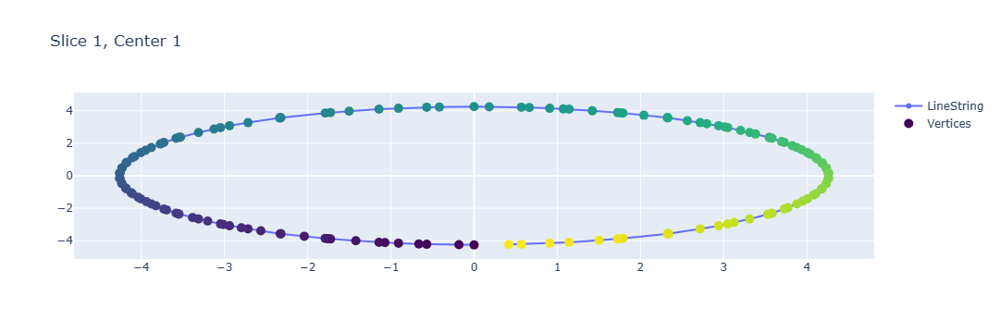

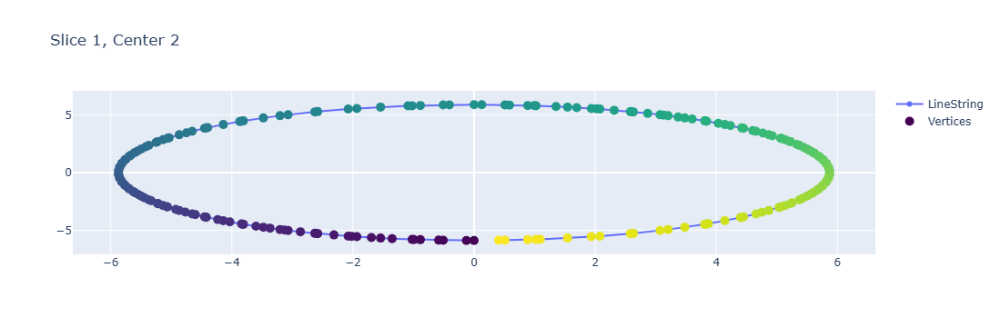

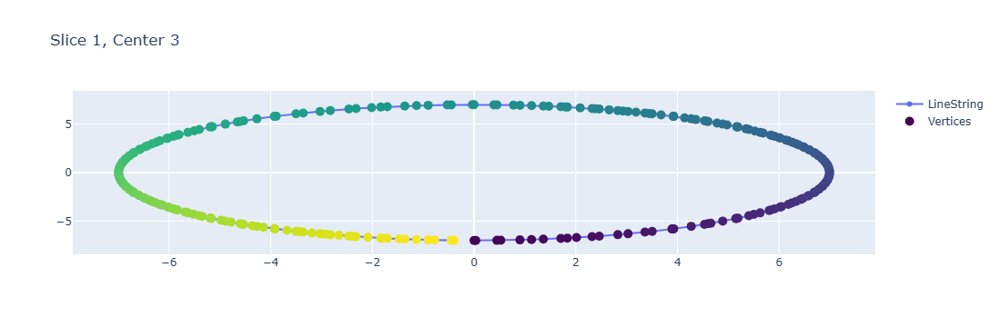

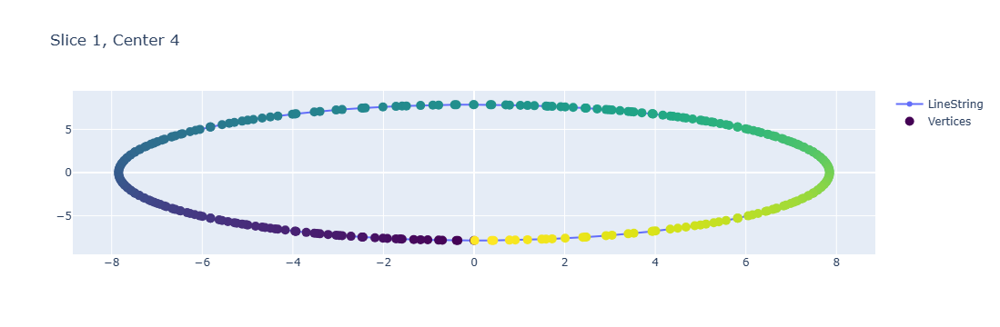

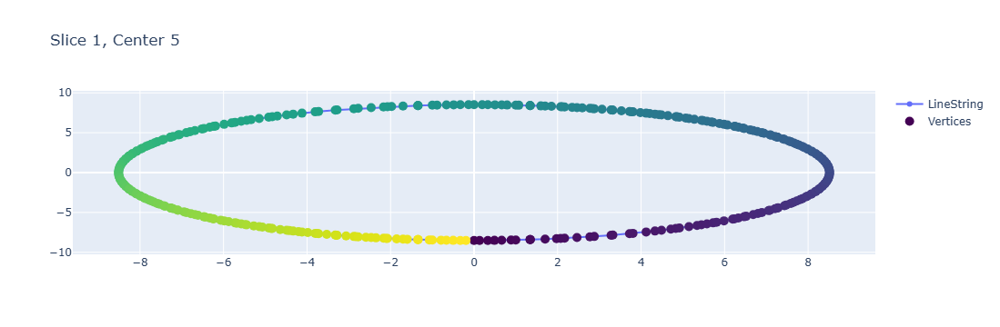

...

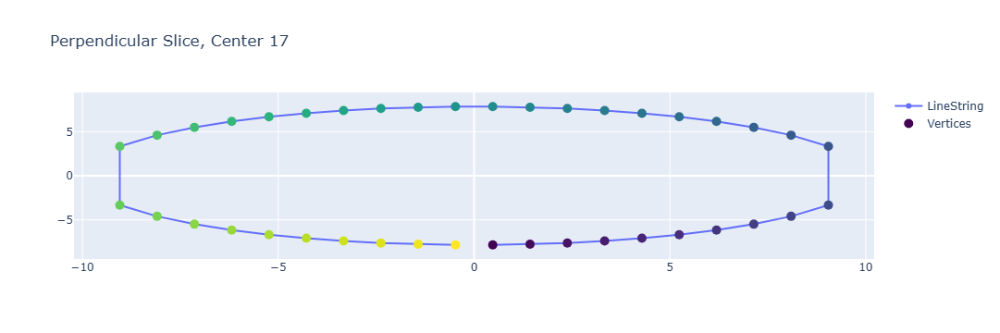

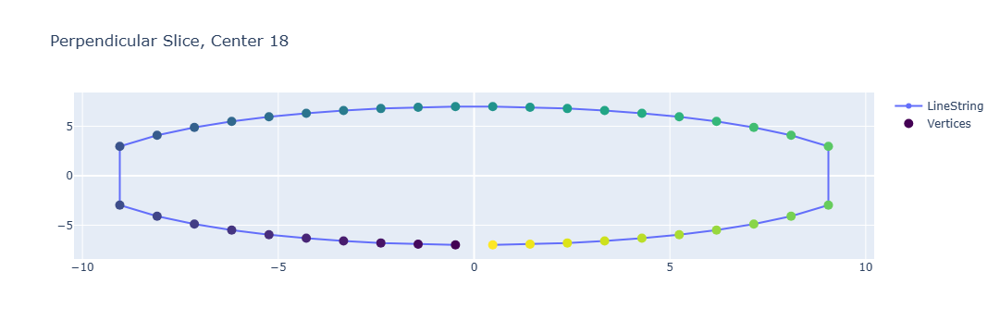

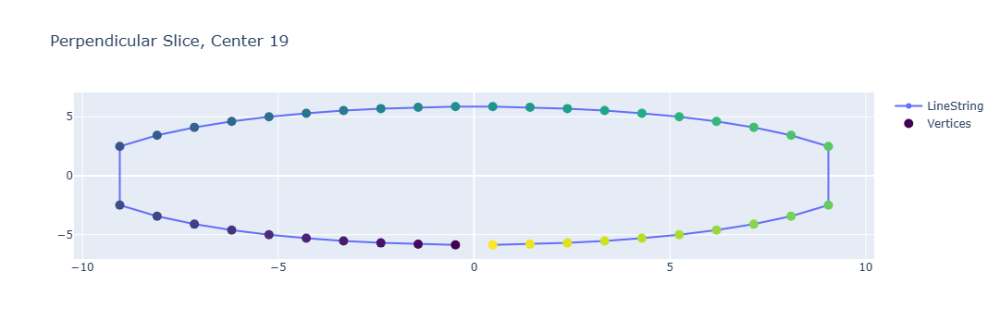

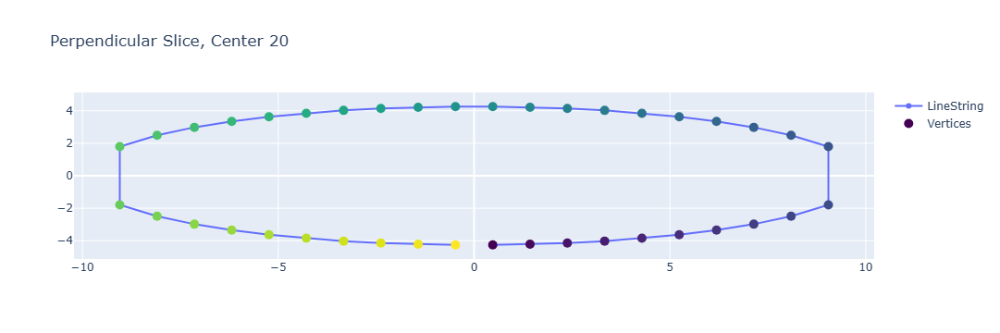

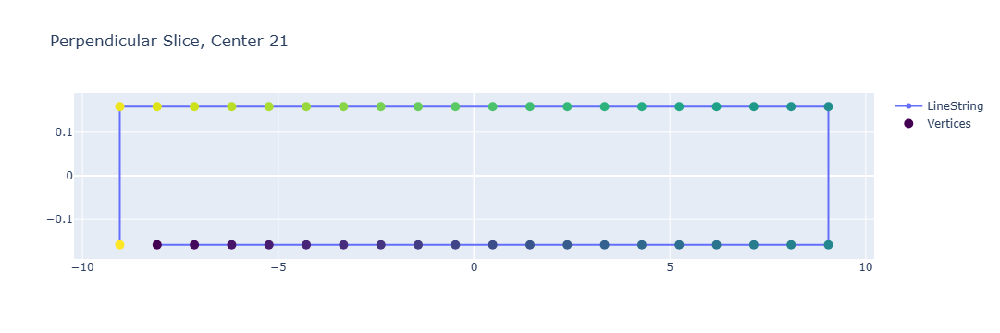

In [11]:
"""combination of manually corrected sections with automatically corrected sections"""
import os
import numpy as np
from shapely.geometry import LineString
import matplotlib.pyplot as plt

# Directory containing the corrected linestrings
save_dir = r"C:\Users\carl\Desktop\Zwischenschritte\sphere_model"

# Check if the directory exists
if os.path.exists(save_dir):
    corrected_files = os.listdir(save_dir)
else:
    corrected_files = []

# Combine unchanged and corrected linestrings
combined_linestrings = {}

# Function to load the saved corrected vertex order
def load_corrected_vertex_order(file_path):
    try:
        if os.path.exists(file_path):
            return np.load(file_path)
        else:
            raise FileNotFoundError(f"File '{file_path}' not found.")
    except Exception as e:
        return None

# Function to combine vertex order with coordinates
def combine_vertex_order_with_coords(linestring, center_index, section_type):
    section_name = f"corrected_vertices_direction_{section_type.replace(' ', '_')}_center_{center_index}.npy"
    file_path = os.path.join(save_dir, section_name)

    corrected_vertex_order = load_corrected_vertex_order(file_path)

    if corrected_vertex_order is not None:
        try:
            coords = np.array(linestring.coords)
            corrected_coords = coords[corrected_vertex_order]
            return LineString(corrected_coords)
        except Exception as e:
            print(f"Error combining vertex order with coordinates: {e}")
            return linestring
    else:
        return linestring

# Integrate corrections for linestrings_rearranged
for key, linestring in linestrings_rearranged.items():
    combined_linestrings[int(key)] = combine_vertex_order_with_coords(linestring, int(key), "Section dir1")

# Print the current state of combined_linestrings
print(f"Keys in combined_linestrings after Section Dir 1: {list(combined_linestrings.keys())}")

# Now we need to generate unique keys for the perpendicular linestrings
max_existing_key = max(combined_linestrings.keys()) if combined_linestrings else 0

# Integrate corrections for perpendicular_linestrings_rearranged
for key, linestring in perpendicular_linestrings_rearranged.items():
    try:
        key_as_int = int(key)  # Ensure the key is an integer
        new_key = max_existing_key + 1  # Start from the next available key
        
        # Find an available key that does not conflict
        while new_key in combined_linestrings:
            new_key += 1

        combined_linestrings[new_key] = combine_vertex_order_with_coords(linestring, key_as_int, "Perpendicular_Direction")
        max_existing_key = new_key  # Update max_existing_key for future use
    except ValueError:
        print(f"Key '{key}' could not be converted to an integer.")
    except Exception as e:
        print(f"An error occurred while processing key '{key}': {e}")

# Print the final state of combined_linestrings
print(f"Final number of keys in combined_linestrings: {len(combined_linestrings)}")
print(f"Keys in combined_linestrings: {list(combined_linestrings.keys())}")


# Function to create a simple figure with corrected headings
def create_simple_figure(linestring, slice_type, center_index):
    coords = np.array(linestring.coords)  # Assuming linestring.coords gives you an array of [x, y, z]
    
    if "Slice 1" in slice_type:
        title = f"Slice 1, Center {center_index}"
        x = coords[:, 1]  # Y-values
        y = coords[:, 2]  # Z-values
    elif "Perpendicular Slice" in slice_type:
        title = f"Perpendicular Slice, Center {center_index}"
        x = coords[:, 0]  # X-values (first column)
        y = coords[:, 2]  # Z-values (third column)
        
    else:
        # Default case for unknown or other slice types
        title = f"Combined Linestrings - Center {center_index}"
        x = coords[:, 1]  # Y-values
        y = coords[:, 2]  # Z-values

    # Convert to lists for plotting
    x = list(x)
    y = list(y)

    fig = go.Figure()
    fig.add_trace(go.Scatter(x=x, y=y, mode='lines+markers', name='LineString'))

    # Apply viridis colormap
    cmap = plt.get_cmap('viridis')
    norm = plt.Normalize(vmin=0, vmax=len(x) - 1)
    colors = [cmap(norm(i)) for i in range(len(x))]
    colors = [f'rgba({r*255},{g*255},{b*255},{a})' for r, g, b, a in colors]

    # Scatter plot with colormap
    fig.add_trace(go.Scatter(
        x=x, y=y,
        mode='markers',
        marker=dict(color=colors, size=10),
        name='Vertices'
    ))

    fig.update_layout(title=title)
    return fig
    
# Visualize combined linestrings with corrected headings
for idx, linestring in combined_linestrings.items():
    if idx in linestrings_rearranged:
        slice_type = "Slice 1"
        center_index = idx  # Center index is the same as the key for Slice 1
    elif idx > len(linestrings_rearranged):
        slice_type = "Perpendicular Slice"
        center_index = idx - len(linestrings_rearranged)-1  # Center index starts from 0 for Perpendicular Slice
    else:
        slice_type = "Unknown"
        center_index = idx  # Default case

    # Create and show the figure
    fig = create_simple_figure(linestring, slice_type, center_index)
    fig.show()



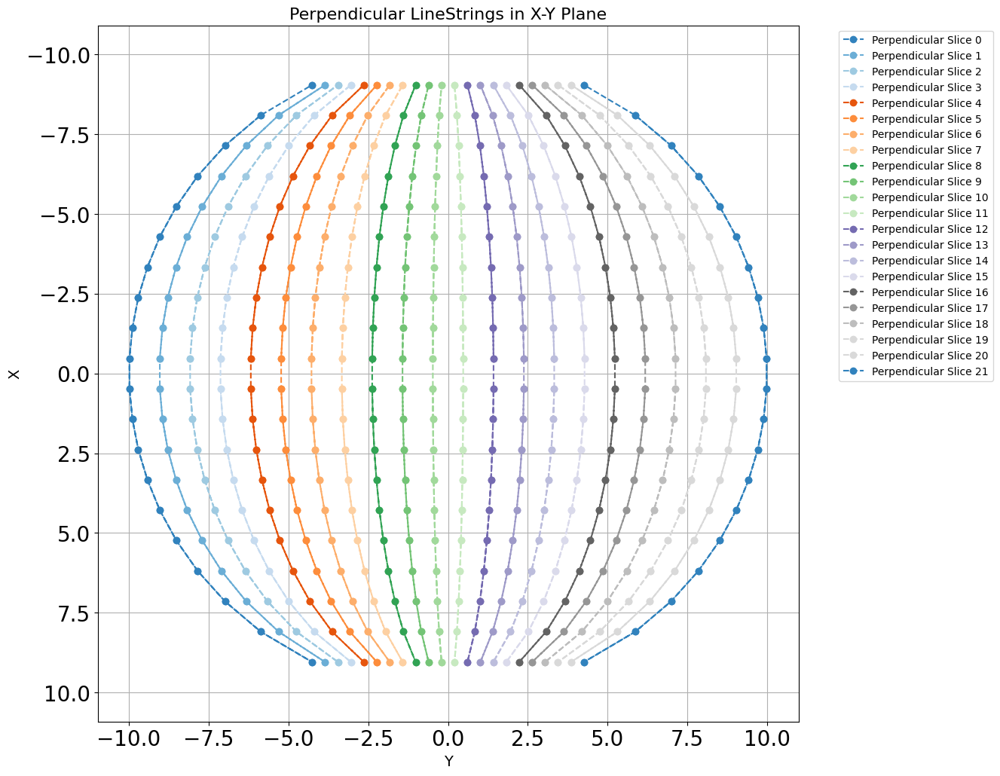

In [12]:
"""optional: visualization of all corrected cross section of both directions in top view"""
import matplotlib.pyplot as plt
import numpy as np
import pyvista as pv

# Initialize the plot
fig = plt.figure(figsize=(12, 12))
ax  = fig.gca()
# Create a colormap with 21 distinct colors
colors = plt.cm.tab20c(np.linspace(0, 1, 21))

# Specify the index to exclude


# Initialize variables to store data ranges
y_min, y_max = float('inf'), float('-inf')
x_min, x_max = float('inf'), float('-inf')

# Loop through combined_linestrings to plot all except the excluded index
for idx, linestring in combined_linestrings.items():
    # Check if the current index matches the excluded index
    #if idx == excluded_index:
     #   continue

    # Determine the slice type and center index
    if idx > len(linestrings_rearranged):
        slice_type = "Perpendicular Slice"
        center_index = idx - len(linestrings_rearranged) - 1  # Center index for Perpendicular Slices

        # Extract coordinates from the linestring
        coords = np.array(linestring.coords)  # Convert to NumPy array
        x_coords = coords[:, 0]  # X-coordinates
        y_coords = coords[:, 1]  # Y-coordinates

        # Update the data range
        y_min, y_max = min(y_min, y_coords.min()), max(y_max, y_coords.max())
        x_min, x_max = min(x_min, x_coords.min()), max(x_max, x_coords.max())

        # Plot the Perpendicular Slice in X-Y plane
        plt.plot(
            y_coords, x_coords,
            marker='o',
            color=colors[center_index % len(colors)],
            linestyle='--',
            label=f'Orthogonal section {center_index}'
        )

# Customize the plot
plt.title(f'Orthogonal sections in X-Y Plane', fontsize=16)
plt.xlabel('Y', fontsize=14)
plt.ylabel('X', fontsize=14)
plt.grid(True)
plt.axis('equal')  # Ensure equal scaling on both axes

# Adjust the limits based on the data ranges with a small margin
margin = 0.05  # 5% margin
plt.xlim(y_min - margin * (y_max - y_min), y_max + margin * (y_max - y_min))
plt.ylim(x_min - margin * (x_max - x_min), x_max + margin * (x_max - x_min))
ax.tick_params(axis='both', which='major', labelsize=20)
# Invert the X-axis
plt.gca().invert_yaxis()

# Add legend
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.show()

Calculated area for line 1: 56.829759162074666


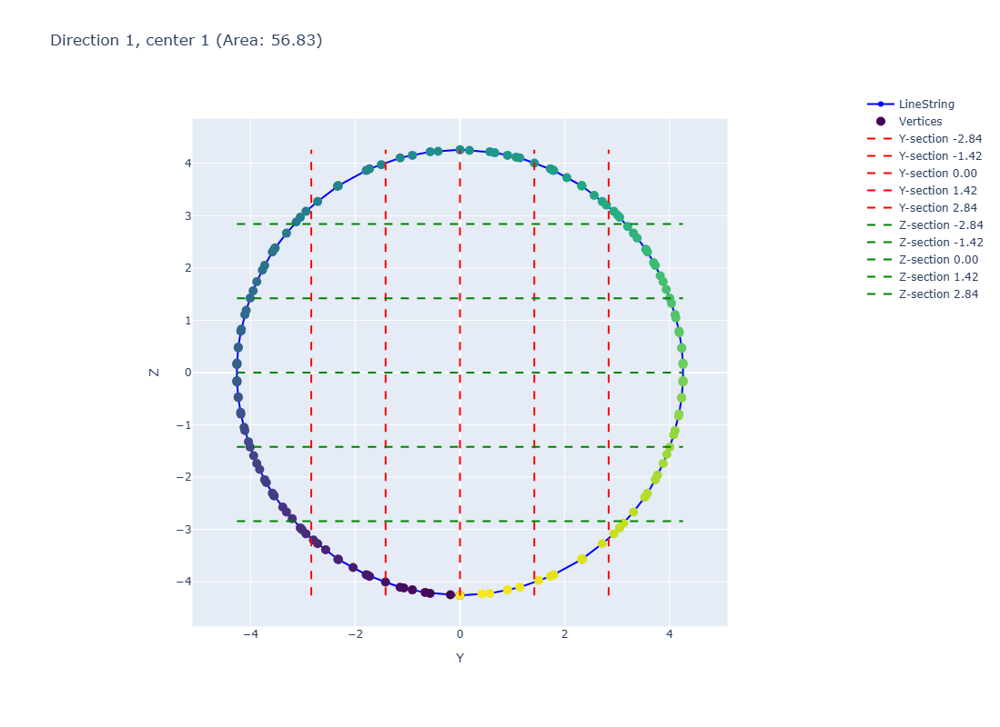


Y-Range at specified Z-values:
z = -2.83923880259196: y-range = -3.161127210180997 to 3.16112842303321
z = -2.83923880259196: horizontal length = 6.322255633214207
z = -1.41961940129598: y-range = -4.006896899977639 to 4.006897102035738
z = -1.41961940129598: horizontal length = 8.013794002013377
z = 0.0: y-range = -4.2585344314575195 to 4.2585344314575195
z = 0.0: horizontal length = 8.517068862915039
z = 1.4196194012959795: y-range = -4.006897102035738 to 4.006896899977639
z = 1.4196194012959795: horizontal length = 8.013794002013377
z = 2.83923880259196: y-range = -3.16112842303321 to 3.161127210180997
z = 2.83923880259196: horizontal length = 6.322255633214207

Z-Range at specified Y-values:
y = -2.8390229543050127: z-range = -3.167114671627831 to 3.1671172163579353
y = -2.8390229543050127: vertical length = 6.334231887985766
y = -1.4195114771525064: z-range = -4.004793533329604 to 4.004792685260518
y = -1.4195114771525064: vertical length = 8.009586218590123
y = 0.0: z-range = -4

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



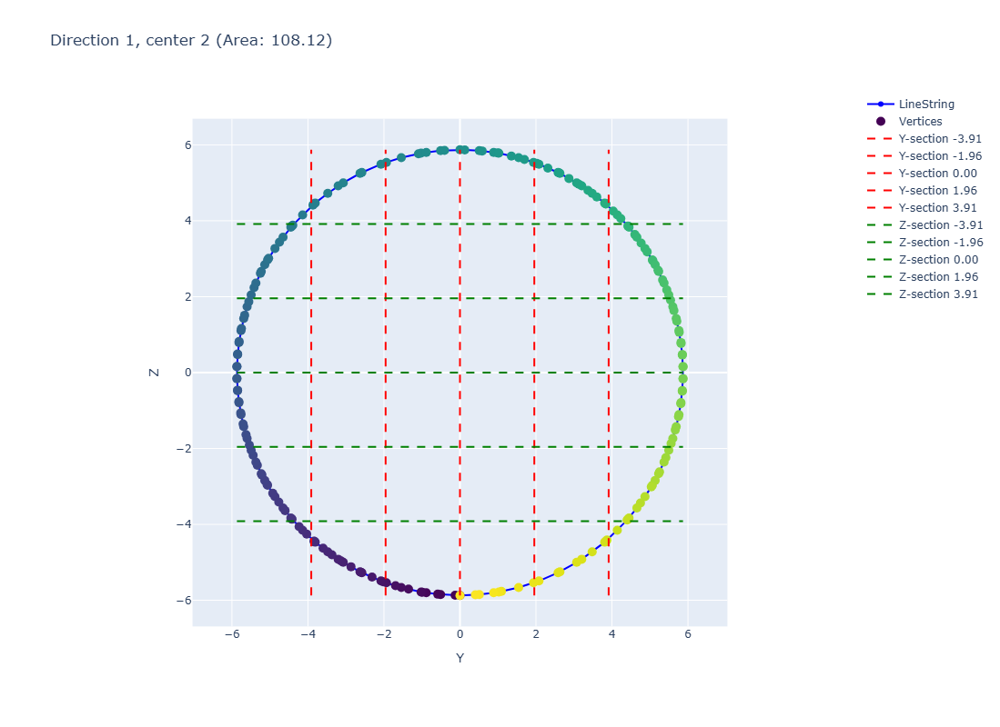


Y-Range at specified Z-values:
z = -3.913715362548828: y-range = -4.372346065413981 to 4.372345880532736
z = -3.913715362548828: horizontal length = 8.744691945946716
z = -1.956857681274414: y-range = -5.526221101938304 to 5.5262167224273995
z = -1.956857681274414: horizontal length = 11.052437824365704
z = 0.0: y-range = -5.869653224945068 to 5.869653224945068
z = 0.0: horizontal length = 11.739306449890137
z = 1.956857681274414: y-range = -5.5262167224273995 to 5.526221101938304
z = 1.956857681274414: horizontal length = 11.052437824365704
z = 3.913715362548828: y-range = -4.372345880532736 to 4.372346065413981
z = 3.913715362548828: horizontal length = 8.744691945946716

Z-Range at specified Y-values:
y = -3.913102149963379: z-range = -4.371313316714189 to 4.371315543632358
y = -3.913102149963379: vertical length = 8.742628860346546
y = -1.9565510749816895: z-range = -5.5321916352498945 to 5.532191990182339
y = -1.9565510749816895: vertical length = 11.064383625432233
y = 0.0: z-ra

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



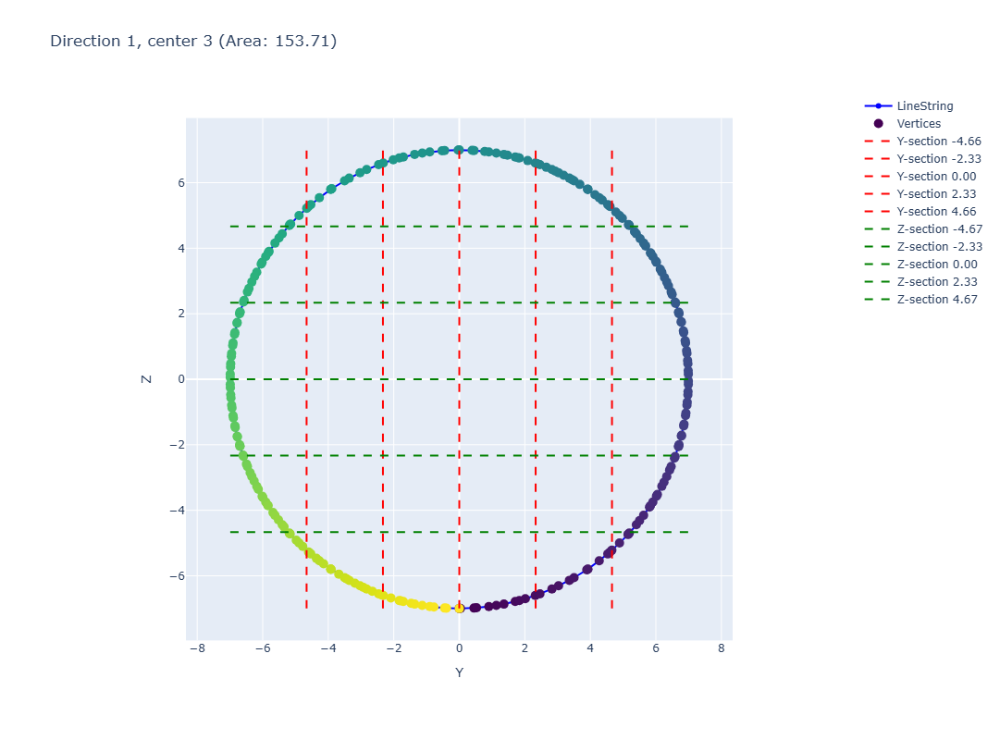


Y-Range at specified Z-values:
z = -4.666000048319498: y-range = -5.214743248808296 to 5.214743354961602
z = -4.666000048319498: horizontal length = 10.429486603769899
z = -2.333000024159749: y-range = -6.5953910931019 to 6.595391105769653
z = -2.333000024159749: horizontal length = 13.190782198871553
z = 0.0: y-range = -6.9914231300354 to 6.9914231300354
z = 0.0: horizontal length = 13.9828462600708
z = 2.333000024159749: y-range = -6.595391105769653 to 6.5953910931019
z = 2.333000024159749: horizontal length = 13.190782198871553
z = 4.666000048319498: y-range = -5.214743354961602 to 5.214743248808296
z = 4.666000048319498: horizontal length = 10.429486603769899

Z-Range at specified Y-values:
y = -4.660948753356934: z-range = -5.21584491194011 to 5.2158470546455575
y = -4.660948753356934: vertical length = 10.431691966585667
y = -2.330474376678467: z-range = -6.598503763838258 to 6.59850364424414
y = -2.330474376678467: vertical length = 13.1970074080824
y = 0.0: z-range = -6.999000

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



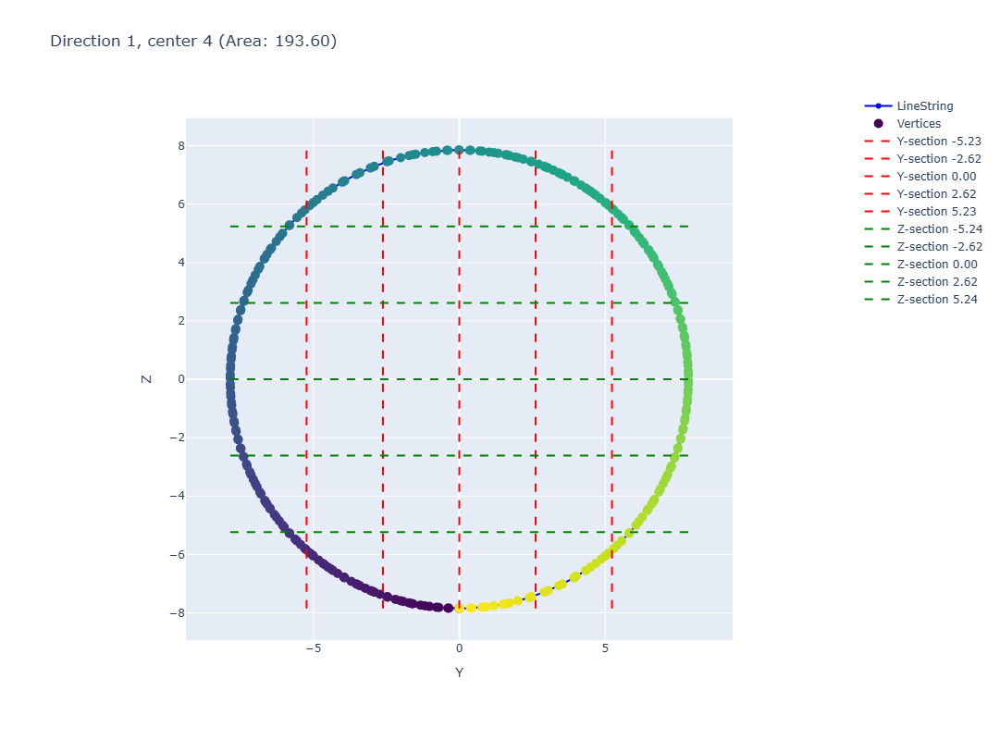

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide




Y-Range at specified Z-values:
z = -5.235962867736816: y-range = -5.852013030677122 to 5.85201287468496
z = -5.235962867736816: horizontal length = 11.704025905362082
z = -2.617981433868408: y-range = -7.402198304625845 to 7.40219870893171
z = -2.617981433868408: horizontal length = 14.804397013557555
z = 0.0: y-range = -7.846685409545898 to 7.846685409545898
z = 0.0: horizontal length = 15.693370819091797
z = 2.617981433868408: y-range = -7.40219870893171 to 7.402198304625845
z = 2.617981433868408: horizontal length = 14.804397013557555
z = 5.235962867736816: y-range = -5.85201287468496 to 5.852013030677122
z = 5.235962867736816: horizontal length = 11.704025905362082

Z-Range at specified Y-values:
y = -5.231123606363932: z-range = -5.854077075749168 to 5.854078504778761
y = -5.231123606363932: vertical length = 11.70815558052793
y = -2.615561803181966: z-range = -7.401826201085934 to 7.401825216718101
y = -2.615561803181966: vertical length = 14.803651417804035
y = 0.0: z-range = -

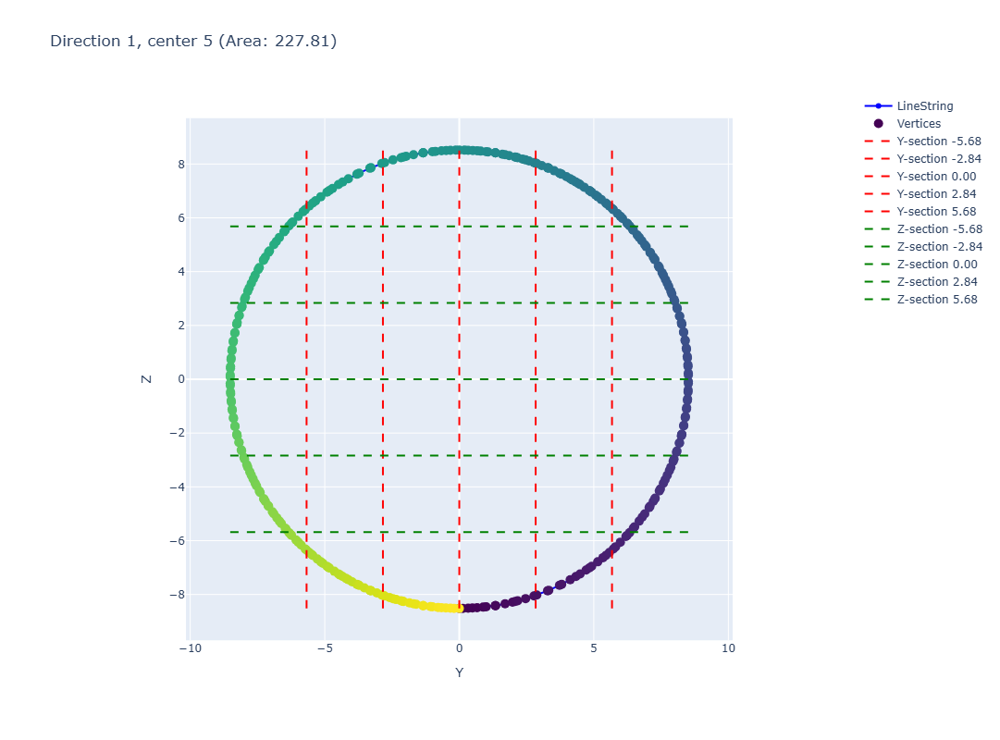


Y-Range at specified Z-values:
z = -5.678250630696615: y-range = -6.347930530636921 to 6.347930480091541
z = -5.678250630696615: horizontal length = 12.69586101072846
z = -2.8391253153483076: y-range = -8.02656026278339 to 8.026557746194728
z = -2.8391253153483076: horizontal length = 16.053118008978117
z = 0.0: y-range = -8.51327896118164 to 8.51327896118164
z = 0.0: horizontal length = 17.02655792236328
z = 2.8391253153483067: y-range = -8.02655774619473 to 8.026560262783391
z = 2.8391253153483067: horizontal length = 16.05311800897812
z = 5.678250630696615: y-range = -6.347930480091541 to 6.347930530636921
z = 5.678250630696615: horizontal length = 12.69586101072846

Z-Range at specified Y-values:
y = -5.675519307454428: z-range = -6.349391033233496 to 6.349391116242353
y = -5.675519307454428: vertical length = 12.69878214947585
y = -2.837759653727214: z-range = -8.030809395572037 to 8.030809084964627
y = -2.837759653727214: vertical length = 16.061618480536666
y = 0.0: z-range = -

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



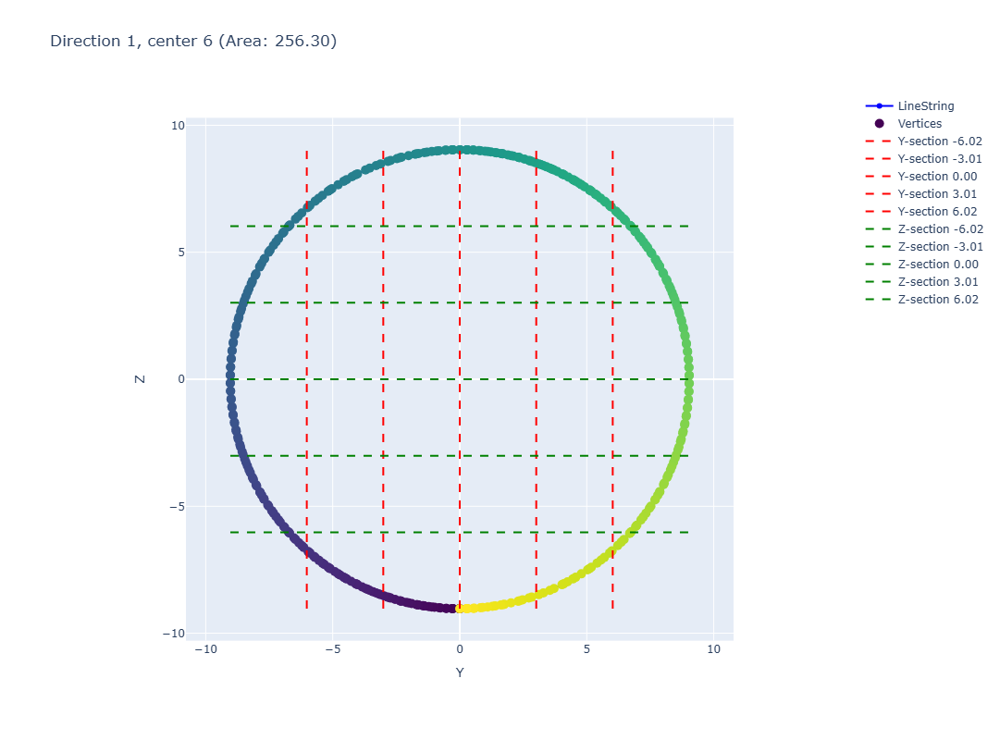


Y-Range at specified Z-values:
z = -6.023402531941732: y-range = -6.733480975069664 to 6.733480904015282
z = -6.023402531941732: horizontal length = 13.466961879084947
z = -3.011701265970866: y-range = -8.512764945422541 to 8.512765902870079
z = -3.011701265970866: horizontal length = 17.025530848292618
z = 0.0: y-range = -9.032905578613281 to 9.032905578613281
z = 0.0: horizontal length = 18.065811157226562
z = 3.0117012659708653: y-range = -8.512765902870079 to 8.512764945422541
z = 3.0117012659708653: horizontal length = 17.025530848292618
z = 6.023402531941732: y-range = -6.733480904015282 to 6.733480975069664
z = 6.023402531941732: horizontal length = 13.466961879084947

Z-Range at specified Y-values:
y = -6.021937052408854: z-range = -6.732573219111986 to 6.732573450204118
y = -6.021937052408854: vertical length = 13.465146669316104
y = -3.010968526204427: z-range = -8.516291729831414 to 8.516291657639314
y = -3.010968526204427: vertical length = 17.03258338747073
y = 0.0: z-ran

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



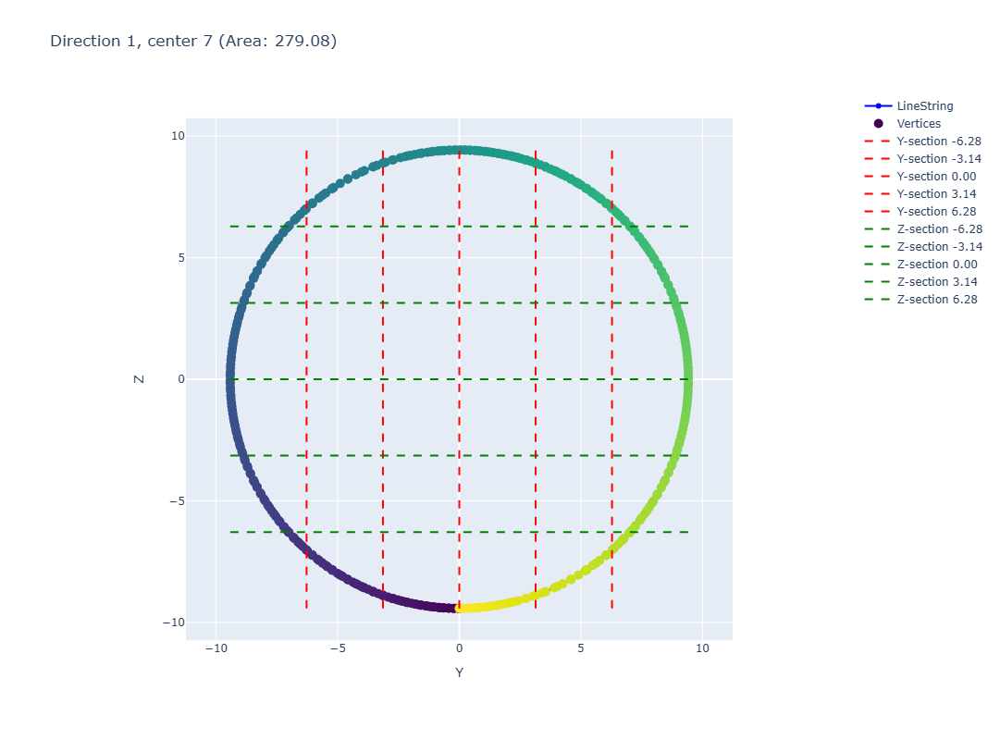


Y-Range at specified Z-values:
z = -6.284758885701498: y-range = -7.026713039662962 to 7.026713729322784
z = -6.284758885701498: horizontal length = 14.053426768985746
z = -3.142379442850749: y-range = -8.883675439213093 to 8.883676821726873
z = -3.142379442850749: horizontal length = 17.767352260939965
z = 0.0: y-range = -9.421833992004395 to 9.421833992004395
z = 0.0: horizontal length = 18.84366798400879
z = 3.142379442850748: y-range = -8.883676821726873 to 8.883675439213093
z = 3.142379442850748: horizontal length = 17.767352260939965
z = 6.284758885701498: y-range = -7.026713729322784 to 7.026713039662962
z = 6.284758885701498: horizontal length = 14.053426768985746

Z-Range at specified Y-values:
y = -6.281222661336264: z-range = -7.028246335319397 to 7.028246242794485
y = -6.281222661336264: vertical length = 14.056492578113883
y = -3.140611330668132: z-range = -8.889606608356557 to 8.889606848918541
y = -3.140611330668132: vertical length = 17.779213457275098
y = 0.0: z-range

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



Dimensions saved to 'C:\Users\carl\Desktop\Structural dimensions\Raw data\standard models\sphere_model\1st direction\Direction_1,_center_7_dimensions.csv'
Calculated area for line 8: 296.2105113664049


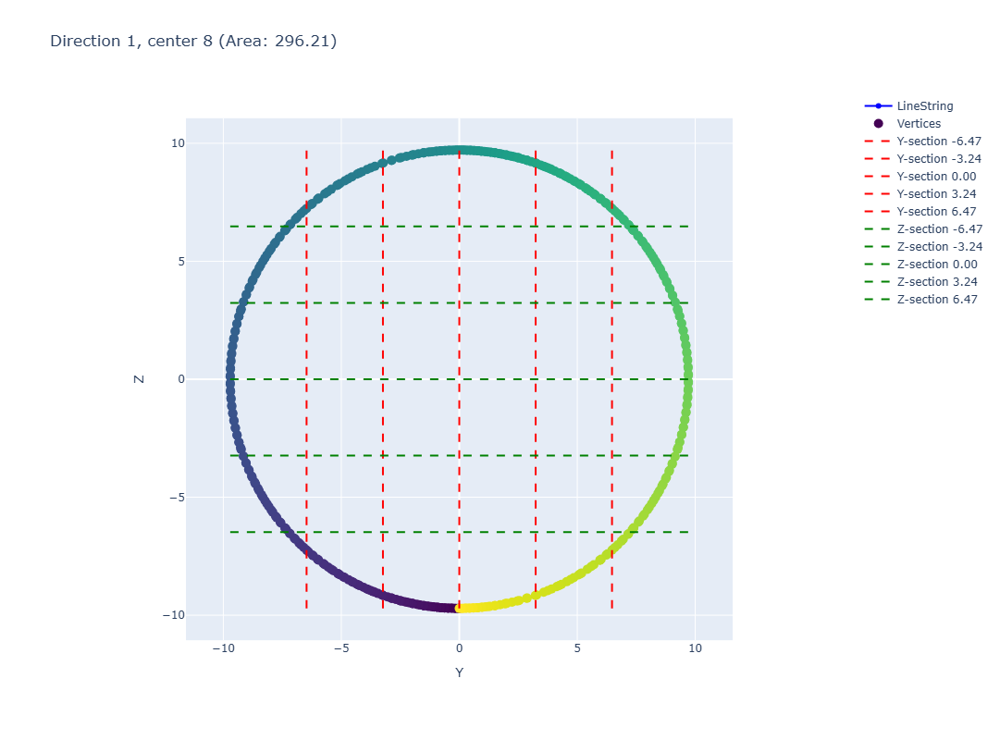


Y-Range at specified Z-values:
z = -6.474152247111002: y-range = -7.237683848995036 to 7.237683234882743
z = -6.474152247111002: horizontal length = 14.475367083877778
z = -3.237076123555501: y-range = -9.155736096206864 to 9.155735809914209
z = -3.237076123555501: horizontal length = 18.31147190612107
z = 0.0: y-range = -9.708291053771973 to 9.708291053771973
z = 0.0: horizontal length = 19.416582107543945
z = 3.237076123555502: y-range = -9.155735809914209 to 9.155736096206864
z = 3.237076123555502: horizontal length = 18.31147190612107
z = 6.474152247111002: y-range = -7.237683234882743 to 7.237683848995036
z = 6.474152247111002: horizontal length = 14.475367083877778

Z-Range at specified Y-values:
y = -6.472194035847982: z-range = -7.238636136169509 to 7.238636128497312
y = -6.472194035847982: vertical length = 14.477272264666821
y = -3.236097017923991: z-range = -9.15705635508553 to 9.157056202216562
y = -3.236097017923991: vertical length = 18.314112557302092
y = 0.0: z-range =

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



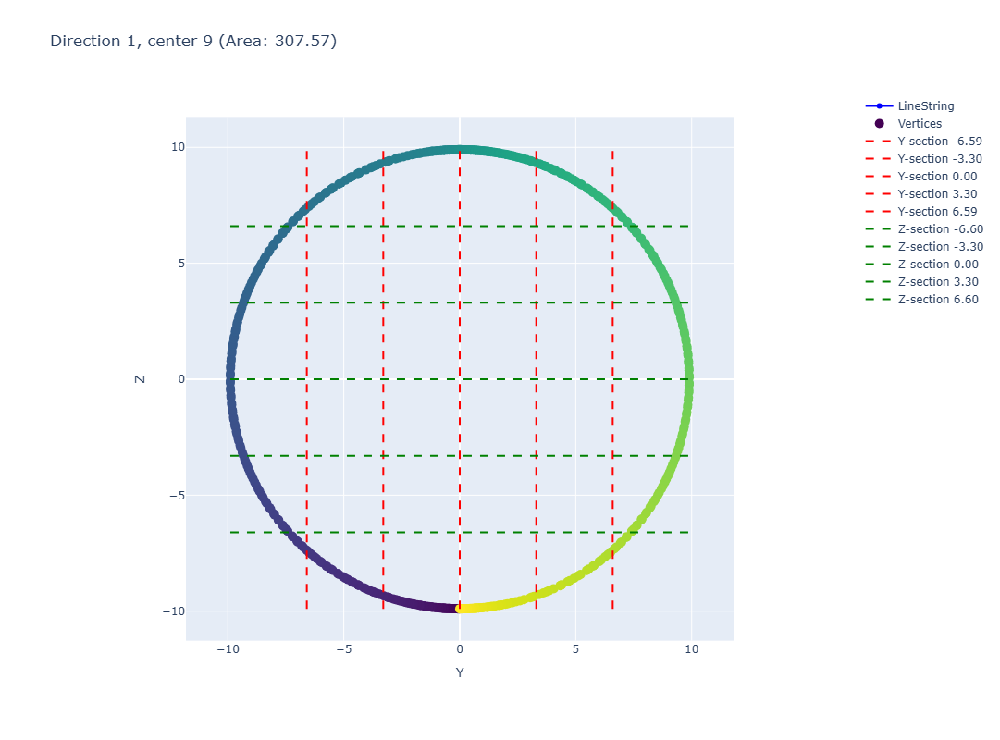

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide




Y-Range at specified Z-values:
z = -6.59745979309082: y-range = -7.376127581071463 to 7.376127594957525
z = -6.59745979309082: horizontal length = 14.752255176028989
z = -3.29872989654541: y-range = -9.326514173732809 to 9.326513565142868
z = -3.29872989654541: horizontal length = 18.65302773887568
z = 0.0: y-range = -9.892148971557617 to 9.892148971557617
z = 0.0: horizontal length = 19.784297943115234
z = 3.29872989654541: y-range = -9.326513565142868 to 9.326514173732809
z = 3.29872989654541: horizontal length = 18.65302773887568
z = 6.59745979309082: y-range = -7.376127594957525 to 7.376127581071463
z = 6.59745979309082: horizontal length = 14.752255176028989

Z-Range at specified Y-values:
y = -6.594765981038412: z-range = -7.375815992828802 to 7.3758146038736285
y = -6.594765981038412: vertical length = 14.75163059670243
y = -3.297382990519206: z-range = -9.330052270071771 to 9.330053029736252
y = -3.297382990519206: vertical length = 18.660105299808023
y = 0.0: z-range = -9.896

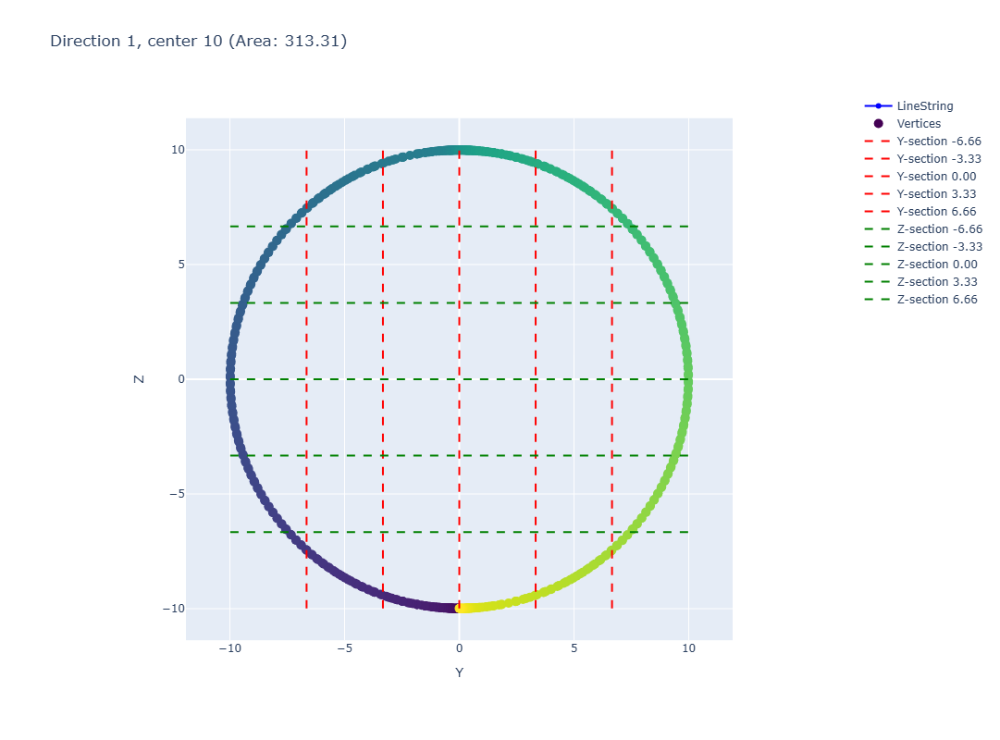


Y-Range at specified Z-values:
z = -6.658267974853516: y-range = -7.443930631795254 to 7.443930399705789
z = -6.658267974853516: horizontal length = 14.887861031501043
z = -3.329133987426758: y-range = -9.413769874813575 to 9.413770489812517
z = -3.329133987426758: horizontal length = 18.827540364626092
z = 0.0: y-range = -9.983777046203613 to 9.983777046203613
z = 0.0: horizontal length = 19.967554092407227
z = 3.329133987426758: y-range = -9.413770489812517 to 9.413769874813575
z = 3.329133987426758: horizontal length = 18.827540364626092
z = 6.658267974853516: y-range = -7.443930399705789 to 7.443930631795254
z = 6.658267974853516: horizontal length = 14.887861031501043

Z-Range at specified Y-values:
y = -6.655851364135742: z-range = -7.4464275313526 to 7.4464273465284645
y = -6.655851364135742: vertical length = 14.892854877881064
y = -3.327925682067871: z-range = -9.416692684220868 to 9.416692363605431
y = -3.327925682067871: vertical length = 18.833385047826297
y = 0.0: z-range

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



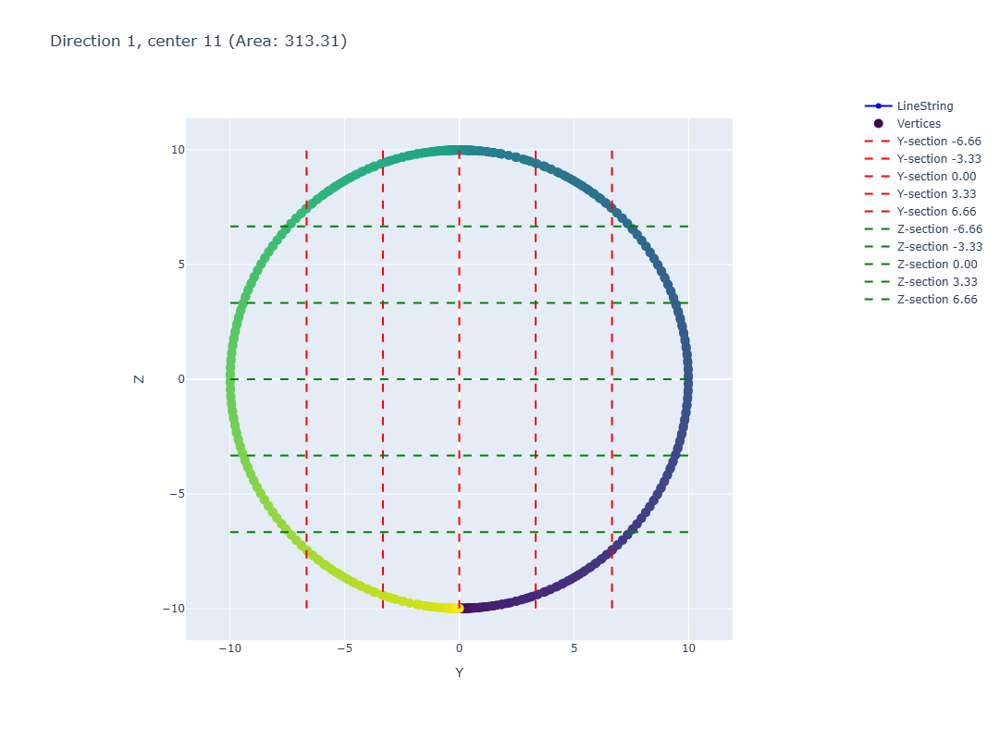


Y-Range at specified Z-values:
z = -6.658267974853516: y-range = -7.443930399705789 to 7.443930631795254
z = -6.658267974853516: horizontal length = 14.887861031501043
z = -3.329133987426758: y-range = -9.413770489812517 to 9.413769874813575
z = -3.329133987426758: horizontal length = 18.827540364626092
z = 0.0: y-range = -9.983777046203613 to 9.983777046203613
z = 0.0: horizontal length = 19.967554092407227
z = 3.329133987426758: y-range = -9.413769874813575 to 9.413770489812517
z = 3.329133987426758: horizontal length = 18.827540364626092
z = 6.658267974853516: y-range = -7.443930631795254 to 7.443930399705789
z = 6.658267974853516: horizontal length = 14.887861031501043

Z-Range at specified Y-values:
y = -6.655851364135742: z-range = -7.4464273465284645 to 7.4464275313526
y = -6.655851364135742: vertical length = 14.892854877881064
y = -3.327925682067871: z-range = -9.416692363605431 to 9.416692684220868
y = -3.327925682067871: vertical length = 18.833385047826297
y = 0.0: z-range

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



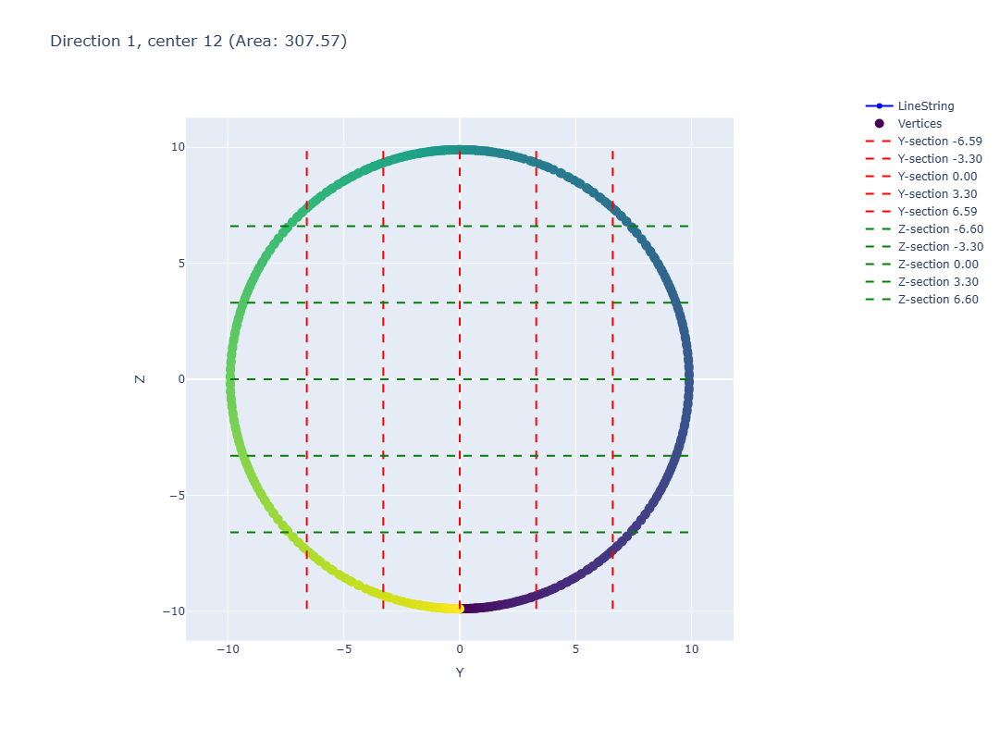


Y-Range at specified Z-values:
z = -6.59745979309082: y-range = -7.376127594957525 to 7.376127581071463
z = -6.59745979309082: horizontal length = 14.752255176028989
z = -3.29872989654541: y-range = -9.326513565142868 to 9.326514173732809
z = -3.29872989654541: horizontal length = 18.65302773887568
z = 0.0: y-range = -9.892148971557617 to 9.892148971557617
z = 0.0: horizontal length = 19.784297943115234
z = 3.29872989654541: y-range = -9.326514173732809 to 9.326513565142868
z = 3.29872989654541: horizontal length = 18.65302773887568
z = 6.59745979309082: y-range = -7.376127581071463 to 7.376127594957525
z = 6.59745979309082: horizontal length = 14.752255176028989

Z-Range at specified Y-values:
y = -6.594765981038412: z-range = -7.3758146038736285 to 7.375815992828802
y = -6.594765981038412: vertical length = 14.75163059670243
y = -3.297382990519206: z-range = -9.330053029736252 to 9.330052270071771
y = -3.297382990519206: vertical length = 18.660105299808023
y = 0.0: z-range = -9.896

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



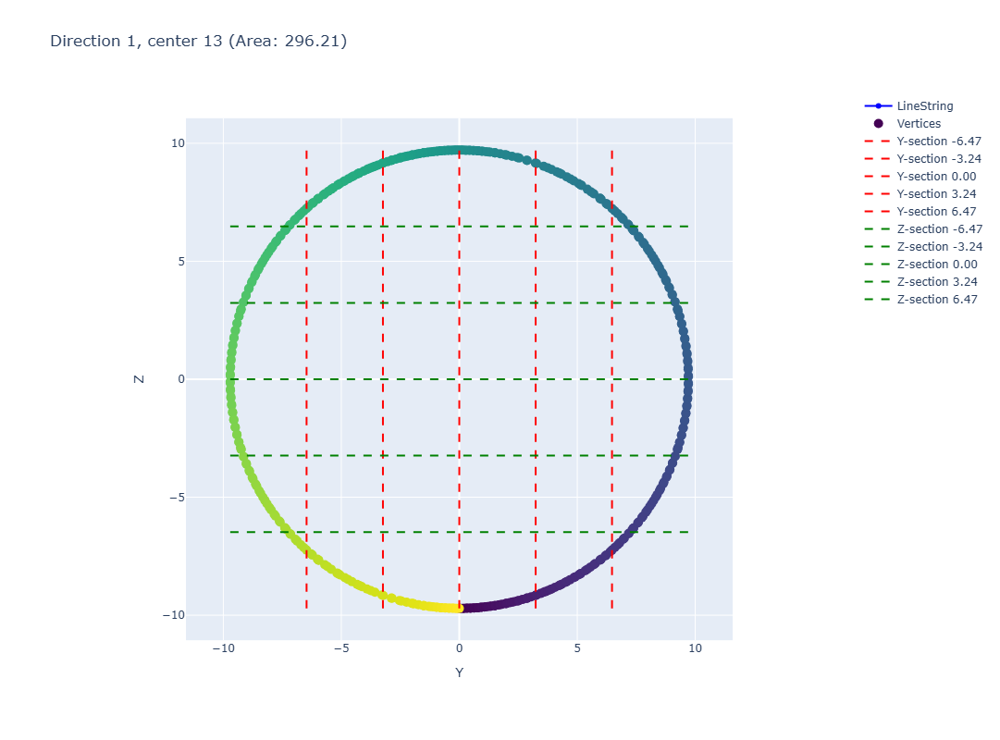


Y-Range at specified Z-values:
z = -6.474152247111002: y-range = -7.237683234882743 to 7.237683848995036
z = -6.474152247111002: horizontal length = 14.475367083877778
z = -3.237076123555501: y-range = -9.155735809914209 to 9.155736096206864
z = -3.237076123555501: horizontal length = 18.31147190612107
z = 0.0: y-range = -9.708291053771973 to 9.708291053771973
z = 0.0: horizontal length = 19.416582107543945
z = 3.237076123555502: y-range = -9.155736096206864 to 9.155735809914209
z = 3.237076123555502: horizontal length = 18.31147190612107
z = 6.474152247111002: y-range = -7.237683848995036 to 7.237683234882743
z = 6.474152247111002: horizontal length = 14.475367083877778

Z-Range at specified Y-values:
y = -6.472194035847982: z-range = -7.238636128497312 to 7.238636136169509
y = -6.472194035847982: vertical length = 14.477272264666821
y = -3.236097017923991: z-range = -9.157056202216562 to 9.15705635508553
y = -3.236097017923991: vertical length = 18.314112557302092
y = 0.0: z-range =

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



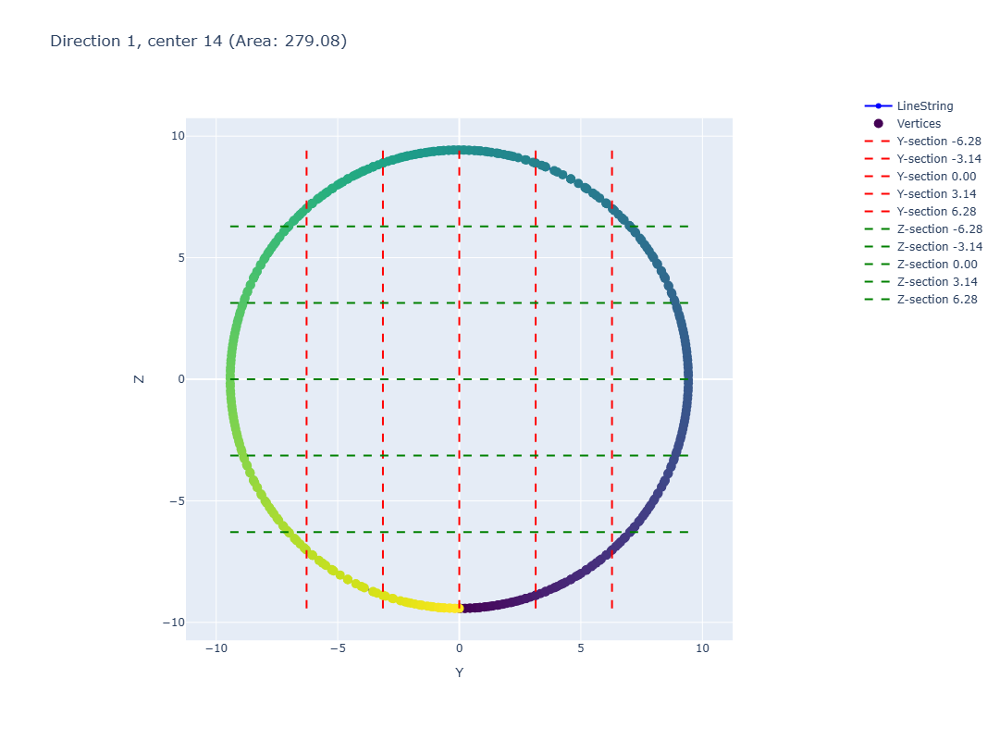


Y-Range at specified Z-values:
z = -6.284758885701498: y-range = -7.026713729322784 to 7.026713039662962
z = -6.284758885701498: horizontal length = 14.053426768985746
z = -3.142379442850749: y-range = -8.883676821726873 to 8.883675439213093
z = -3.142379442850749: horizontal length = 17.767352260939965
z = 0.0: y-range = -9.421833992004395 to 9.421833992004395
z = 0.0: horizontal length = 18.84366798400879
z = 3.142379442850748: y-range = -8.883675439213093 to 8.883676821726873
z = 3.142379442850748: horizontal length = 17.767352260939965
z = 6.284758885701498: y-range = -7.026713039662962 to 7.026713729322784
z = 6.284758885701498: horizontal length = 14.053426768985746

Z-Range at specified Y-values:
y = -6.281222661336264: z-range = -7.028246242794485 to 7.028246335319397
y = -6.281222661336264: vertical length = 14.056492578113883
y = -3.140611330668132: z-range = -8.889606848918541 to 8.889606608356557
y = -3.140611330668132: vertical length = 17.779213457275098
y = 0.0: z-range

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



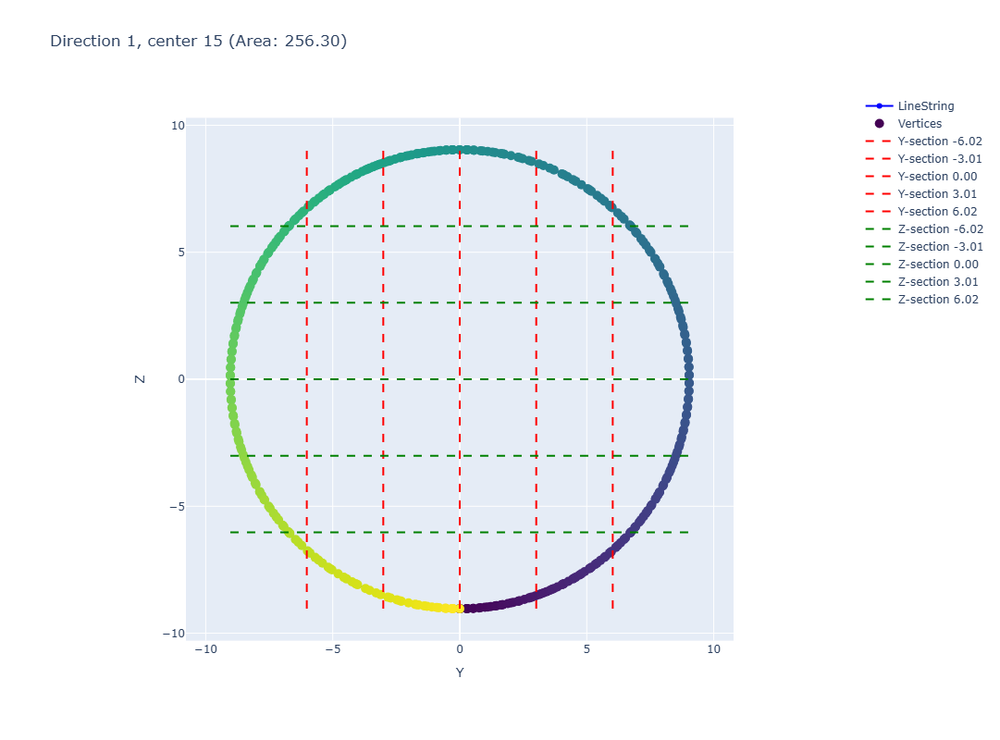


Y-Range at specified Z-values:
z = -6.023402531941732: y-range = -6.733480904015282 to 6.733480975069664
z = -6.023402531941732: horizontal length = 13.466961879084947
z = -3.011701265970866: y-range = -8.512765902870079 to 8.512764945422541
z = -3.011701265970866: horizontal length = 17.025530848292618
z = 0.0: y-range = -9.032905578613281 to 9.032905578613281
z = 0.0: horizontal length = 18.065811157226562
z = 3.0117012659708653: y-range = -8.512764945422541 to 8.512765902870079
z = 3.0117012659708653: horizontal length = 17.025530848292618
z = 6.023402531941732: y-range = -6.733480975069664 to 6.733480904015282
z = 6.023402531941732: horizontal length = 13.466961879084947

Z-Range at specified Y-values:
y = -6.021937052408854: z-range = -6.732573450204118 to 6.732573219111986
y = -6.021937052408854: vertical length = 13.465146669316104
y = -3.010968526204427: z-range = -8.516291657639314 to 8.516291729831414
y = -3.010968526204427: vertical length = 17.03258338747073
y = 0.0: z-ran

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



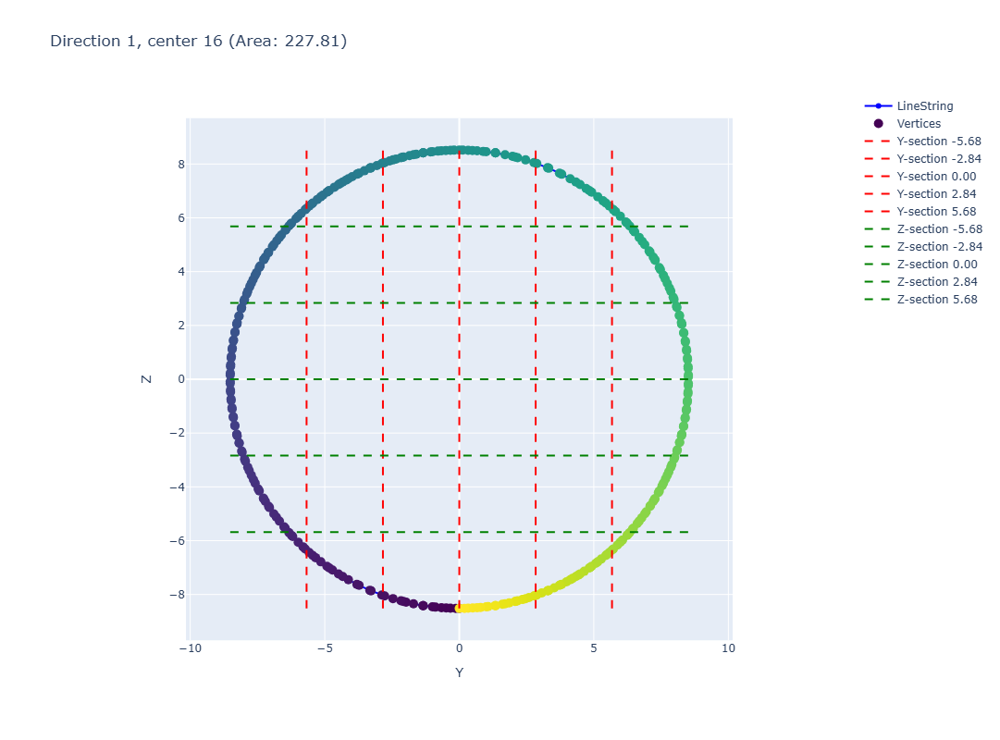


Y-Range at specified Z-values:
z = -5.678250630696615: y-range = -6.347930480091541 to 6.347930530636921
z = -5.678250630696615: horizontal length = 12.69586101072846
z = -2.8391253153483076: y-range = -8.026557746194728 to 8.02656026278339
z = -2.8391253153483076: horizontal length = 16.053118008978117
z = 0.0: y-range = -8.51327896118164 to 8.51327896118164
z = 0.0: horizontal length = 17.02655792236328
z = 2.8391253153483067: y-range = -8.026560262783391 to 8.02655774619473
z = 2.8391253153483067: horizontal length = 16.05311800897812
z = 5.678250630696615: y-range = -6.347930530636921 to 6.347930480091541
z = 5.678250630696615: horizontal length = 12.69586101072846

Z-Range at specified Y-values:
y = -5.675519307454428: z-range = -6.349391116242353 to 6.349391033233496
y = -5.675519307454428: vertical length = 12.69878214947585
y = -2.837759653727214: z-range = -8.030809084964627 to 8.030809395572037
y = -2.837759653727214: vertical length = 16.061618480536666
y = 0.0: z-range = -

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



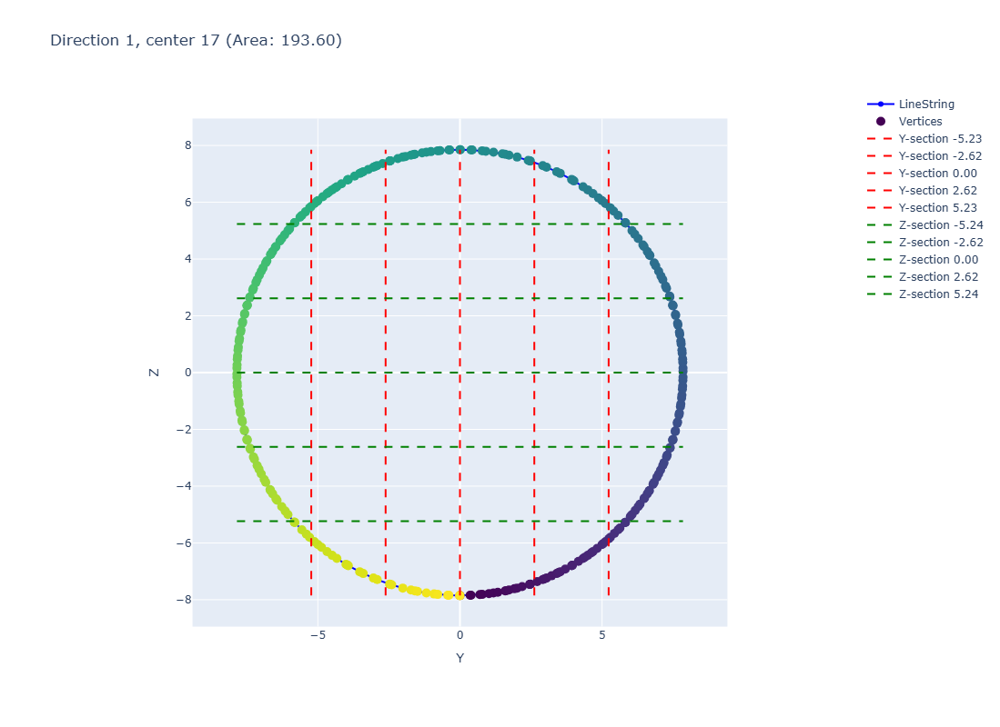


Y-Range at specified Z-values:
z = -5.235962867736816: y-range = -5.85201287468496 to 5.852013030677122
z = -5.235962867736816: horizontal length = 11.704025905362082
z = -2.617981433868408: y-range = -7.40219870893171 to 7.402198304625845
z = -2.617981433868408: horizontal length = 14.804397013557555
z = 0.0: y-range = -7.846685409545898 to 7.846685409545898
z = 0.0: horizontal length = 15.693370819091797
z = 2.617981433868408: y-range = -7.402198304625845 to 7.40219870893171
z = 2.617981433868408: horizontal length = 14.804397013557555
z = 5.235962867736816: y-range = -5.852013030677122 to 5.85201287468496
z = 5.235962867736816: horizontal length = 11.704025905362082

Z-Range at specified Y-values:
y = -5.231123606363932: z-range = -5.854078504778761 to 5.854077075749168
y = -5.231123606363932: vertical length = 11.70815558052793
y = -2.615561803181966: z-range = -7.401825216718101 to 7.401826201085934
y = -2.615561803181966: vertical length = 14.803651417804035
y = 0.0: z-range = -

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



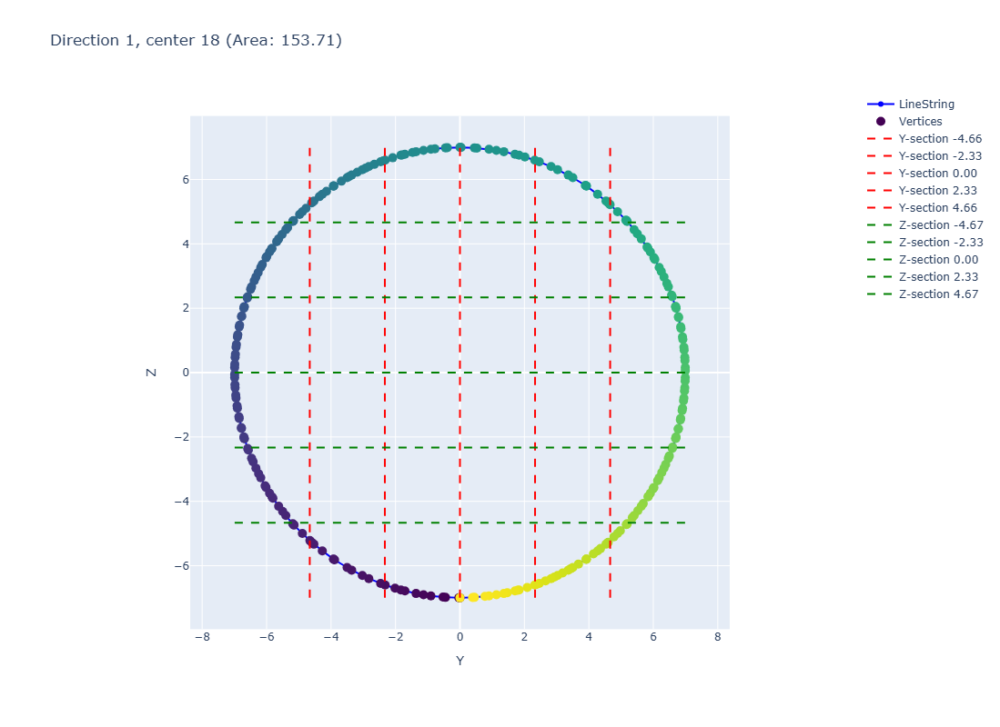


Y-Range at specified Z-values:
z = -4.666000048319498: y-range = -5.214743354961602 to 5.214743248808296
z = -4.666000048319498: horizontal length = 10.429486603769899
z = -2.333000024159749: y-range = -6.595391105769653 to 6.5953910931019
z = -2.333000024159749: horizontal length = 13.190782198871553
z = 0.0: y-range = -6.9914231300354 to 6.9914231300354
z = 0.0: horizontal length = 13.9828462600708
z = 2.333000024159749: y-range = -6.5953910931019 to 6.595391105769653
z = 2.333000024159749: horizontal length = 13.190782198871553
z = 4.666000048319498: y-range = -5.214743248808296 to 5.214743354961602
z = 4.666000048319498: horizontal length = 10.429486603769899

Z-Range at specified Y-values:
y = -4.660948753356934: z-range = -5.2158470546455575 to 5.21584491194011
y = -4.660948753356934: vertical length = 10.431691966585667
y = -2.330474376678467: z-range = -6.59850364424414 to 6.598503763838258
y = -2.330474376678467: vertical length = 13.1970074080824
y = 0.0: z-range = -6.999000

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



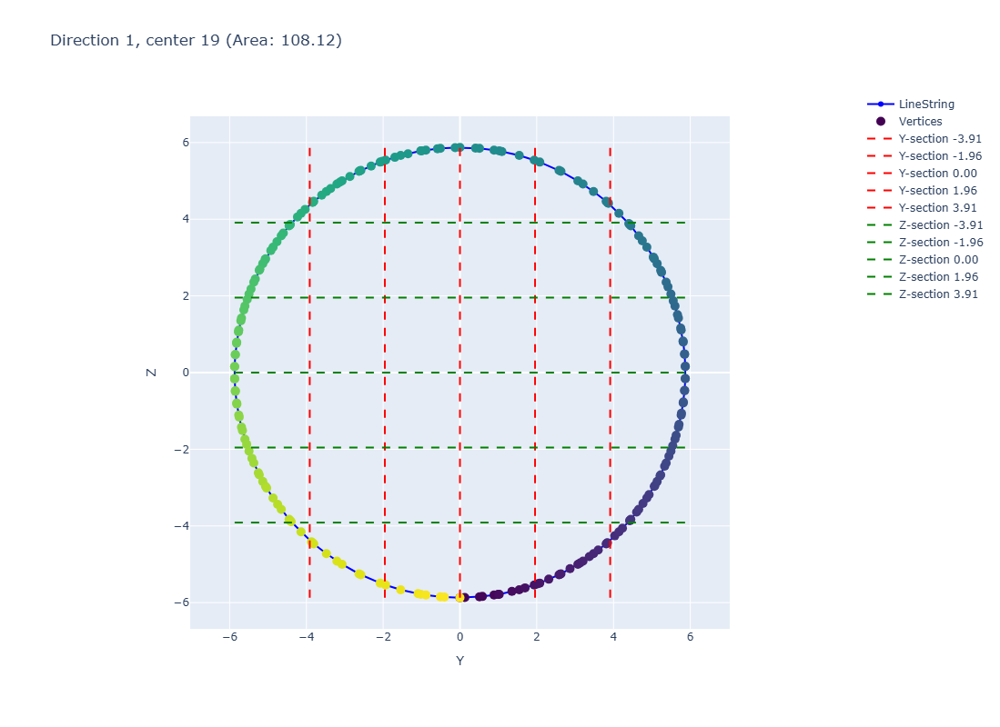


Y-Range at specified Z-values:
z = -3.913715362548828: y-range = -4.372345880532736 to 4.372346065413981
z = -3.913715362548828: horizontal length = 8.744691945946716
z = -1.956857681274414: y-range = -5.5262167224273995 to 5.526221101938304
z = -1.956857681274414: horizontal length = 11.052437824365704
z = 0.0: y-range = -5.869653224945068 to 5.869653224945068
z = 0.0: horizontal length = 11.739306449890137
z = 1.956857681274414: y-range = -5.526221101938304 to 5.5262167224273995
z = 1.956857681274414: horizontal length = 11.052437824365704
z = 3.913715362548828: y-range = -4.372346065413981 to 4.372345880532736
z = 3.913715362548828: horizontal length = 8.744691945946716

Z-Range at specified Y-values:
y = -3.913102149963379: z-range = -4.371315543632358 to 4.371313316714189
y = -3.913102149963379: vertical length = 8.742628860346546
y = -1.9565510749816895: z-range = -5.532191990182339 to 5.5321916352498945
y = -1.9565510749816895: vertical length = 11.064383625432233
y = 0.0: z-ra

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



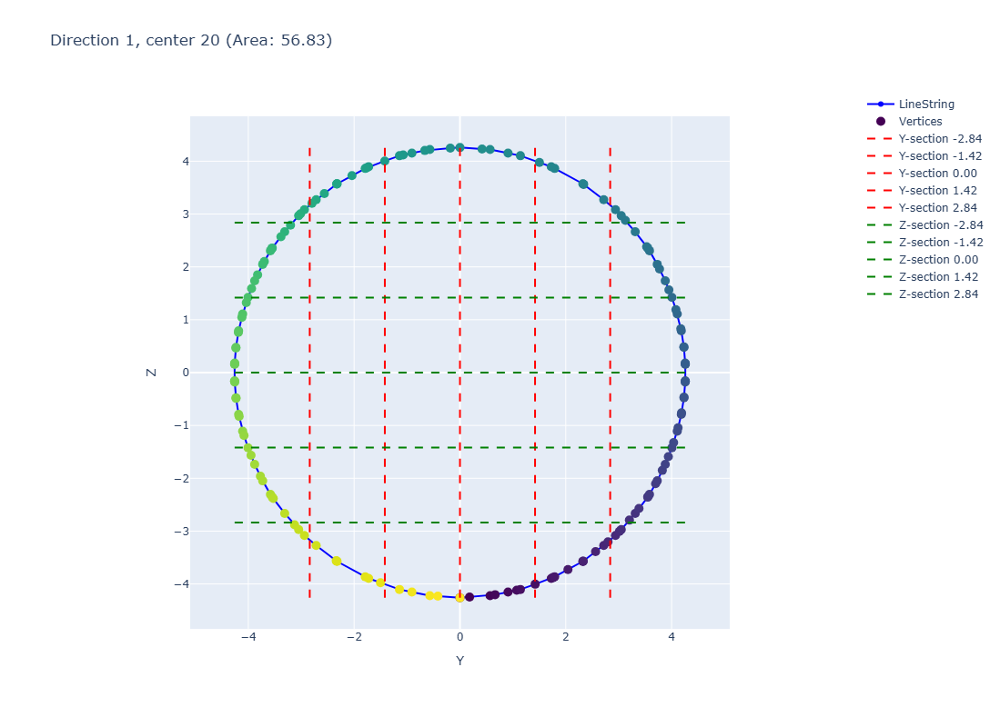


Y-Range at specified Z-values:
z = -2.83923880259196: y-range = -3.16112842303321 to 3.161127210180997
z = -2.83923880259196: horizontal length = 6.322255633214207
z = -1.41961940129598: y-range = -4.006897102035738 to 4.006896899977639
z = -1.41961940129598: horizontal length = 8.013794002013377
z = 0.0: y-range = -4.2585344314575195 to 4.2585344314575195
z = 0.0: horizontal length = 8.517068862915039
z = 1.4196194012959795: y-range = -4.006896899977639 to 4.006897102035738
z = 1.4196194012959795: horizontal length = 8.013794002013377
z = 2.83923880259196: y-range = -3.161127210180997 to 3.16112842303321
z = 2.83923880259196: horizontal length = 6.322255633214207

Z-Range at specified Y-values:
y = -2.8390229543050127: z-range = -3.1671172163579353 to 3.167114671627831
y = -2.8390229543050127: vertical length = 6.334231887985766
y = -1.4195114771525064: z-range = -4.004792685260518 to 4.004793533329604
y = -1.4195114771525064: vertical length = 8.009586218590123
y = 0.0: z-range = -4

C:\Users\carl\AppData\Local\Temp\ipykernel_19040\3310427397.py:274: RuntimeWarning:

invalid value encountered in scalar divide



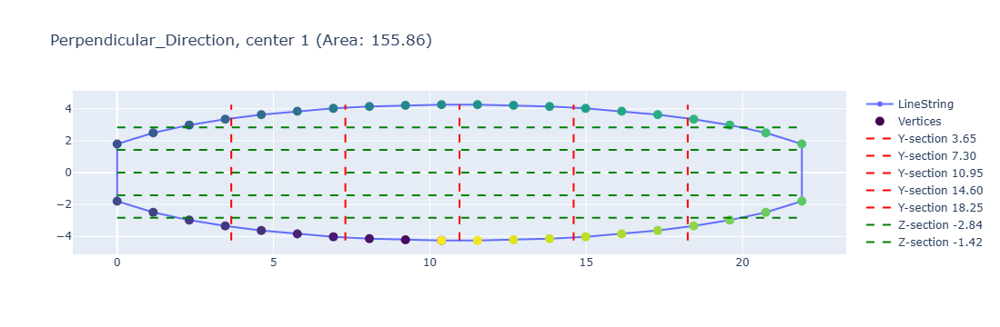


Y-Range at specified Z-values:
z = -2.8372443273222148: y-range = 1.9693544287467244 to 19.930340465970833
z = -2.8372443273222148: horizontal length = 17.96098603722411
z = -1.4186221636611074: y-range = 0.0 to 21.899702388032836
z = -1.4186221636611074: horizontal length = 21.899702388032836
z = 0.0: y-range = 0.0 to 21.899702388032836
z = 0.0: horizontal length = 21.899702388032836
z = 1.4186221636611078: y-range = 0.0 to 21.899702388032836
z = 1.4186221636611078: horizontal length = 21.899702388032836
z = 2.8372443273222148: y-range = 1.9693619220620047 to 19.930347959286113
z = 2.8372443273222148: horizontal length = 17.96098603722411

Z-Range at specified Y-values:
y = 3.6499503980054726: z-range = -3.3908762277634006 to 3.390873877034319
y = 3.6499503980054726: vertical length = 6.78175010479772
y = 7.299900796010945: z-range = -4.0606509923785055 to 4.0606521656942585
y = 7.299900796010945: vertical length = 8.121303158072763
y = 10.949851194016418: z-range = -4.25586626518727

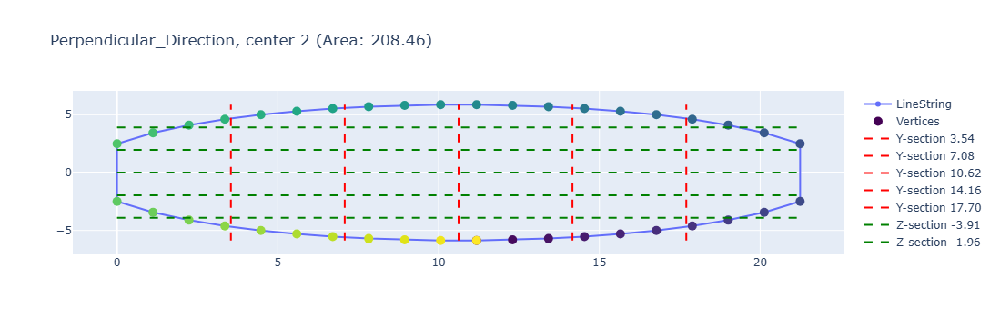


Y-Range at specified Z-values:
z = -3.9111384919051284: y-range = 1.909763102205945 to 19.333814580519373
z = -3.9111384919051284: horizontal length = 17.42405147831343
z = -1.9555692459525642: y-range = 0.0 to 21.243573139689083
z = -1.9555692459525642: horizontal length = 21.243573139689083
z = 0.0: y-range = 0.0 to 21.243573139689083
z = 0.0: horizontal length = 21.243573139689083
z = 1.9555692459525646: y-range = 0.0 to 21.243573139689083
z = 1.9555692459525646: horizontal length = 21.243573139689083
z = 3.9111384919051284: y-range = 1.9097585591697073 to 19.333810037483136
z = 3.9111384919051284: horizontal length = 17.42405147831343

Z-Range at specified Y-values:
y = 3.540595523281514: z-range = -4.674929566754727 to 4.674929113069868
y = 3.540595523281514: vertical length = 9.349858679824596
y = 7.081191046563028: z-range = -5.590628418866105 to 5.590627868028523
y = 7.081191046563028: vertical length = 11.181256286894628
y = 10.621786569844542: z-range = -5.866707252870525 to

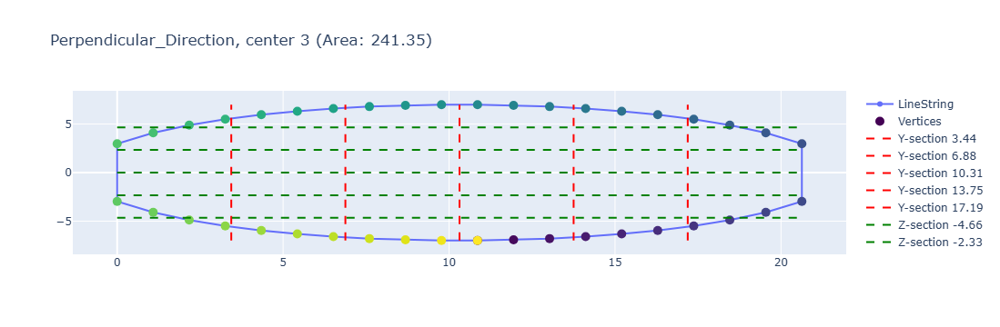


Y-Range at specified Z-values:
z = -4.661808337445386: y-range = 1.8521010143601933 to 18.77621063343917
z = -4.661808337445386: horizontal length = 16.924109619078976
z = -2.330904168722693: y-range = 0.0 to 20.628311451410944
z = -2.330904168722693: horizontal length = 20.628311451410944
z = 0.0: y-range = 0.0 to 20.628311451410944
z = 0.0: horizontal length = 20.628311451410944
z = 2.330904168722693: y-range = 0.0 to 20.628311451410944
z = 2.330904168722693: horizontal length = 20.628311451410944
z = 4.661808337445386: y-range = 1.8521008179717744 to 18.77621043705075
z = 4.661808337445386: horizontal length = 16.924109619078976

Z-Range at specified Y-values:
y = 3.438051908568491: z-range = -5.573048124672321 to 5.573048098839176
y = 3.438051908568491: vertical length = 11.146096223511497
y = 6.876103817136982: z-range = -6.664419822292434 to 6.664422026219558
y = 6.876103817136982: vertical length = 13.328841848511992
y = 10.314155725705472: z-range = -6.9927122842593326 to 6.99

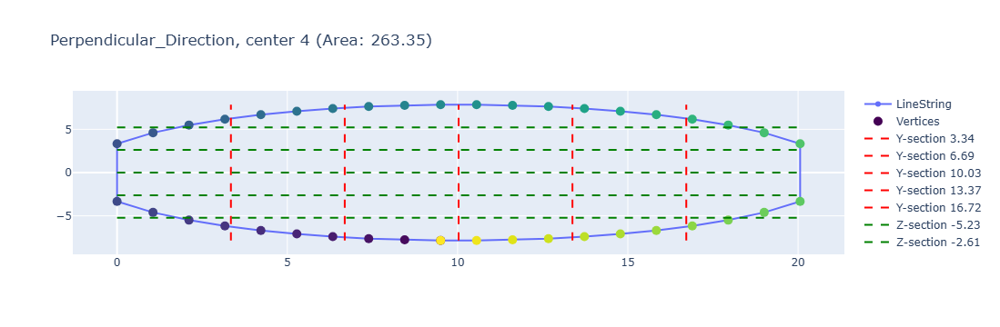


Y-Range at specified Z-values:
z = -5.229909534815661: y-range = 1.798322876564338 to 18.261693318375222
z = -5.229909534815661: horizontal length = 16.463370441810884
z = -2.6149547674078306: y-range = 0.0 to 20.060013435076787
z = -2.6149547674078306: horizontal length = 20.060013435076787
z = 0.0: y-range = 0.0 to 20.060013435076787
z = 0.0: horizontal length = 20.060013435076787
z = 2.6149547674078306: y-range = 0.0 to 20.060013435076787
z = 2.6149547674078306: horizontal length = 20.060013435076787
z = 5.229909534815661: y-range = 1.7983201167015626 to 18.26169055851245
z = 5.229909534815661: horizontal length = 16.463370441810888

Z-Range at specified Y-values:
y = 3.343335572512798: z-range = -6.252108424328933 to 6.252110203994275
y = 3.343335572512798: vertical length = 12.504218628323208
y = 6.686671145025596: z-range = -7.479036113837029 to 7.479037389803452
y = 6.686671145025596: vertical length = 14.958073503640481
y = 10.030006717538395: z-range = -7.844864170405244 to 7

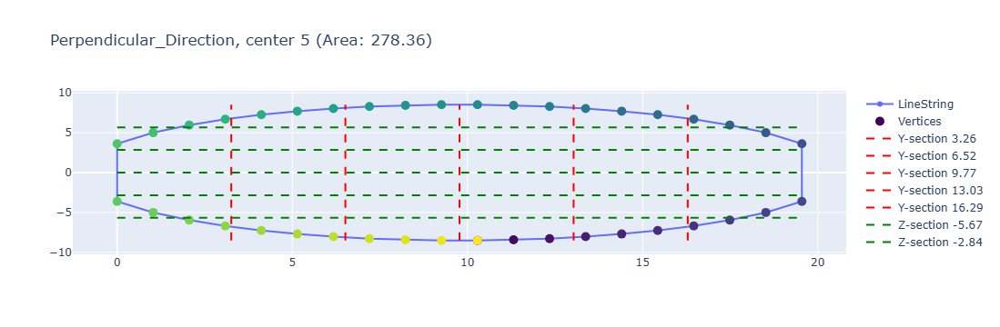


Y-Range at specified Z-values:
z = -5.671488012134276: y-range = 1.7507265305232529 to 17.795135021394373
z = -5.671488012134276: horizontal length = 16.04440849087112
z = -2.835744006067138: y-range = 0.0 to 19.545859758968703
z = -2.835744006067138: horizontal length = 19.545859758968703
z = 0.0: y-range = 0.0 to 19.545859758968703
z = 0.0: horizontal length = 19.545859758968703
z = 2.835744006067138: y-range = 0.0 to 19.545859758968703
z = 2.835744006067138: horizontal length = 19.545859758968703
z = 5.671488012134276: y-range = 1.75072473757433 to 17.79513322844545
z = 5.671488012134276: horizontal length = 16.04440849087112

Z-Range at specified Y-values:
y = 3.2576432931614505: z-range = -6.782106623881785 to 6.782106676583803
y = 3.2576432931614505: vertical length = 13.564213300465589
y = 6.515286586322901: z-range = -8.111567483853642 to 8.111567596480958
y = 6.515286586322901: vertical length = 16.2231350803346
y = 9.772929879484352: z-range = -8.507231615225685 to 8.5072316

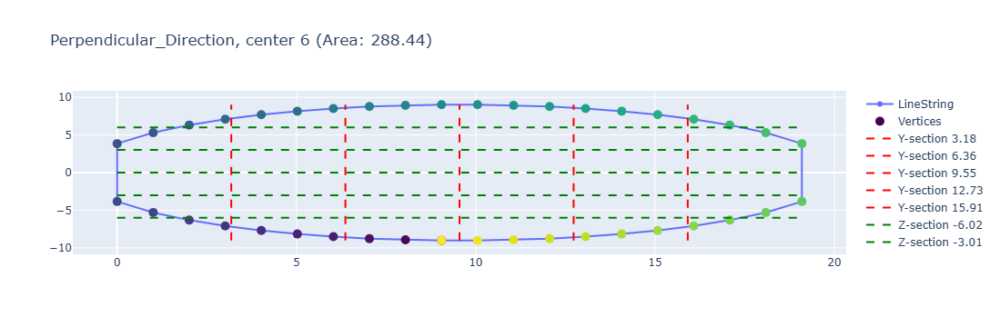


Y-Range at specified Z-values:
z = -6.016620610931097: y-range = 1.709954801729843 to 17.384244791805997
z = -6.016620610931097: horizontal length = 15.674289990076154
z = -3.0083103054655487: y-range = 0.0 to 19.09420029842135
z = -3.0083103054655487: horizontal length = 19.09420029842135
z = 0.0: y-range = 0.0 to 19.09420029842135
z = 0.0: horizontal length = 19.09420029842135
z = 3.008310305465548: y-range = 0.0 to 19.09420029842135
z = 3.008310305465548: horizontal length = 19.09420029842135
z = 6.016620610931097: y-range = 1.7099555066153505 to 17.384245496691506
z = 6.016620610931097: horizontal length = 15.674289990076154

Z-Range at specified Y-values:
y = 3.1823667164035583: z-range = -7.195082615633128 to 7.195082469712948
y = 3.1823667164035583: vertical length = 14.390165085346077
y = 6.364733432807116: z-range = -8.60356810844741 to 8.60356817678482
y = 6.364733432807116: vertical length = 17.20713628523223
y = 9.547100149210674: z-range = -9.024930913293865 to 9.02493091

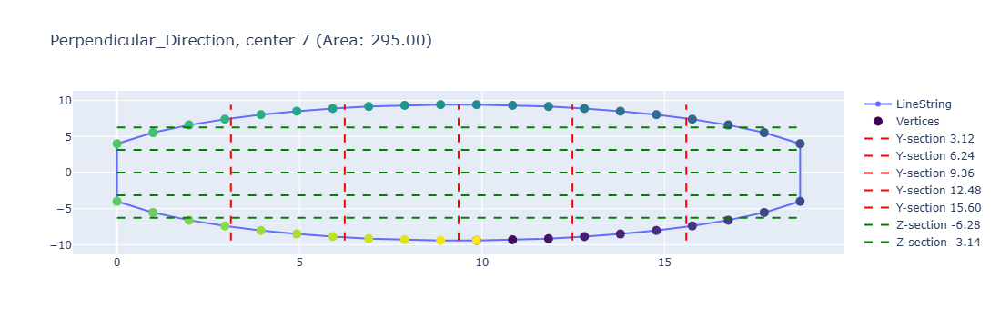


Y-Range at specified Z-values:
z = -6.277795122813911: y-range = 1.6737020077184372 to 17.040784243728076
z = -6.277795122813911: horizontal length = 15.367082236009638
z = -3.1388975614069556: y-range = 0.0 to 18.71448623008408
z = -3.1388975614069556: horizontal length = 18.71448623008408
z = 0.0: y-range = 0.0 to 18.71448623008408
z = 0.0: horizontal length = 18.71448623008408
z = 3.1388975614069548: y-range = 0.0 to 18.71448623008408
z = 3.1388975614069548: horizontal length = 18.71448623008408
z = 6.277795122813911: y-range = 1.6737019863560016 to 17.04078422236564
z = 6.277795122813911: horizontal length = 15.36708223600964

Z-Range at specified Y-values:
y = 3.1190810383473466: z-range = -7.5066562085702015 to 7.50665533649521
y = 3.1190810383473466: vertical length = 15.013311545065411
y = 6.238162076694694: z-range = -8.9787563900094 to 8.97875649942793
y = 6.238162076694694: vertical length = 17.957512889437332
y = 9.35724311504204: z-range = -9.416692523913149 to 9.41669252

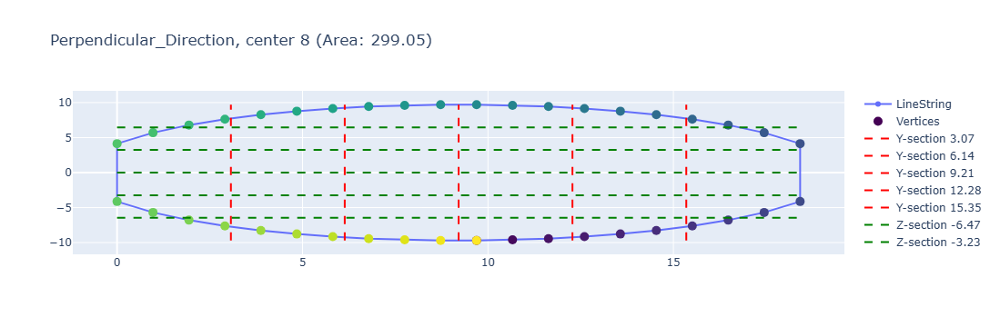


Y-Range at specified Z-values:
z = -6.4669950897537465: y-range = 1.6492792782905163 to 16.76760446019228
z = -6.4669950897537465: horizontal length = 15.118325181901765
z = -3.2334975448768732: y-range = 0.0 to 18.416884270441823
z = -3.2334975448768732: horizontal length = 18.416884270441823
z = 0.0: y-range = 0.0 to 18.416884270441823
z = 0.0: horizontal length = 18.416884270441823
z = 3.233497544876874: y-range = 0.0 to 18.416884270441823
z = 3.233497544876874: horizontal length = 18.416884270441823
z = 6.4669950897537465: y-range = 1.649279810249541 to 16.767604992151306
z = 6.4669950897537465: horizontal length = 15.118325181901765

Z-Range at specified Y-values:
y = 3.069480711740304: z-range = -7.733192486302728 to 7.733193116777389
y = 3.069480711740304: vertical length = 15.466385603080116
y = 6.138961423480607: z-range = -9.248215391004193 to 9.248215094216203
y = 6.138961423480607: vertical length = 18.496430485220394
y = 9.208442135220912: z-range = -9.700492353307775 to 

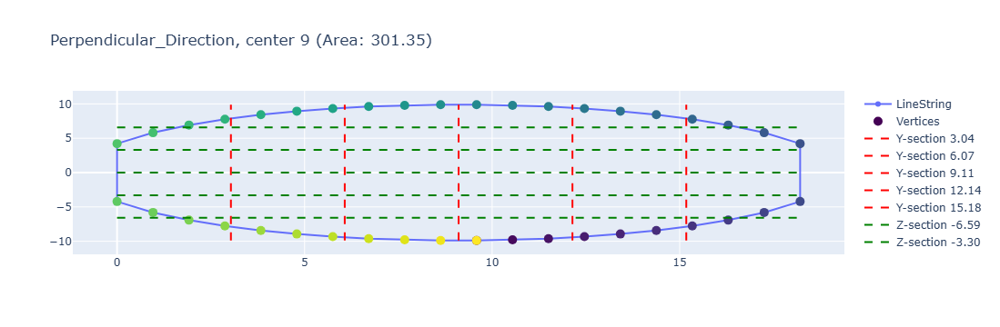


Y-Range at specified Z-values:
z = -6.590216285216403: y-range = 1.6308668697398807 to 16.58050419676952
z = -6.590216285216403: horizontal length = 14.94963732702964
z = -3.2951081426082016: y-range = 0.0 to 18.21137079529844
z = -3.2951081426082016: horizontal length = 18.21137079529844
z = 0.0: y-range = 0.0 to 18.21137079529844
z = 0.0: horizontal length = 18.21137079529844
z = 3.2951081426082016: y-range = 0.0 to 18.21137079529844
z = 3.2951081426082016: horizontal length = 18.21137079529844
z = 6.590216285216403: y-range = 1.6308665985289192 to 16.58050392555856
z = 6.590216285216403: horizontal length = 14.94963732702964

Z-Range at specified Y-values:
y = 3.035228465883073: z-range = -7.880622226169722 to 7.880622284150879
y = 3.035228465883073: vertical length = 15.761244510320601
y = 6.070456931766147: z-range = -9.423984643558276 to 9.423984687628689
y = 6.070456931766147: vertical length = 18.847969331186967
y = 9.10568539764922: z-range = -9.885324292422311 to 9.885324292

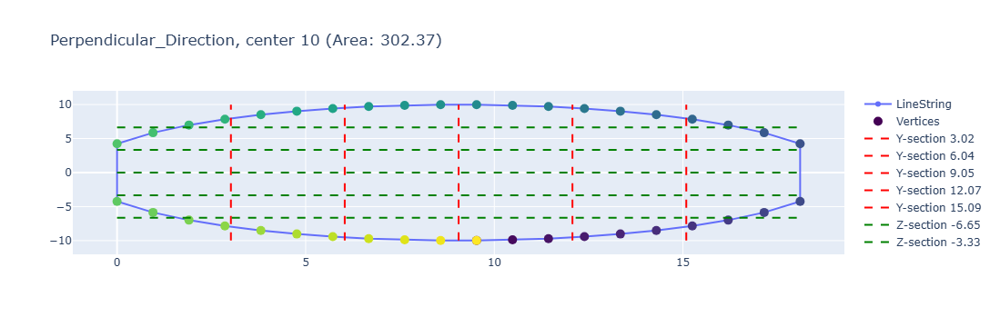


Y-Range at specified Z-values:
z = -6.651182496102143: y-range = 1.6216916338856908 to 16.48453122471586
z = -6.651182496102143: horizontal length = 14.862839590830168
z = -3.3255912480510714: y-range = 0.0 to 18.10622325311158
z = -3.3255912480510714: horizontal length = 18.10622325311158
z = 0.0: y-range = 0.0 to 18.10622325311158
z = 0.0: horizontal length = 18.10622325311158
z = 3.3255912480510705: y-range = 0.0 to 18.10622325311158
z = 3.3255912480510705: horizontal length = 18.10622325311158
z = 6.651182496102143: y-range = 1.6216920283957192 to 16.484531619225887
z = 6.651182496102143: horizontal length = 14.862839590830168

Z-Range at specified Y-values:
y = 3.0177038755185968: z-range = -7.954755062811331 to 7.9547550750519544
y = 3.0177038755185968: vertical length = 15.909510137863286
y = 6.035407751037193: z-range = -9.511109906644176 to 9.511110185898922
y = 6.035407751037193: vertical length = 19.022220092543098
y = 9.05311162655579: z-range = -9.976773664630034 to 9.976

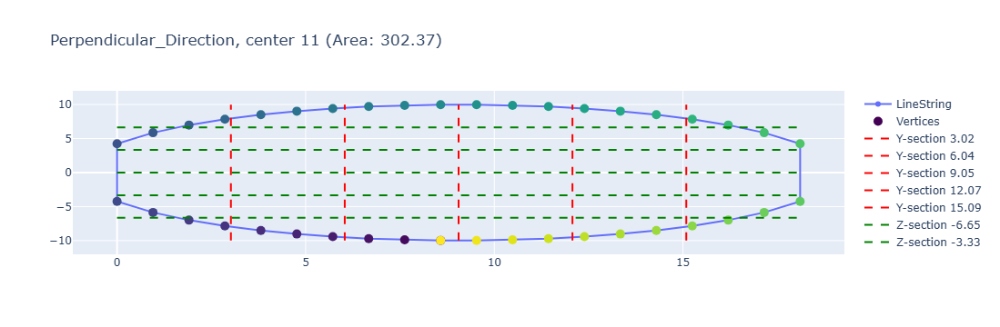


Y-Range at specified Z-values:
z = -6.651182496102143: y-range = 1.6216920283957192 to 16.484531619225887
z = -6.651182496102143: horizontal length = 14.862839590830168
z = -3.3255912480510714: y-range = 0.0 to 18.10622325311158
z = -3.3255912480510714: horizontal length = 18.10622325311158
z = 0.0: y-range = 0.0 to 18.10622325311158
z = 0.0: horizontal length = 18.10622325311158
z = 3.3255912480510705: y-range = 0.0 to 18.10622325311158
z = 3.3255912480510705: horizontal length = 18.10622325311158
z = 6.651182496102143: y-range = 1.6216916338856908 to 16.48453122471586
z = 6.651182496102143: horizontal length = 14.862839590830168

Z-Range at specified Y-values:
y = 3.0177038755185968: z-range = -7.9547550750519544 to 7.954755062811331
y = 3.0177038755185968: vertical length = 15.909510137863286
y = 6.035407751037193: z-range = -9.511110185898922 to 9.511109906644176
y = 6.035407751037193: vertical length = 19.022220092543098
y = 9.05311162655579: z-range = -9.976773664630034 to 9.976

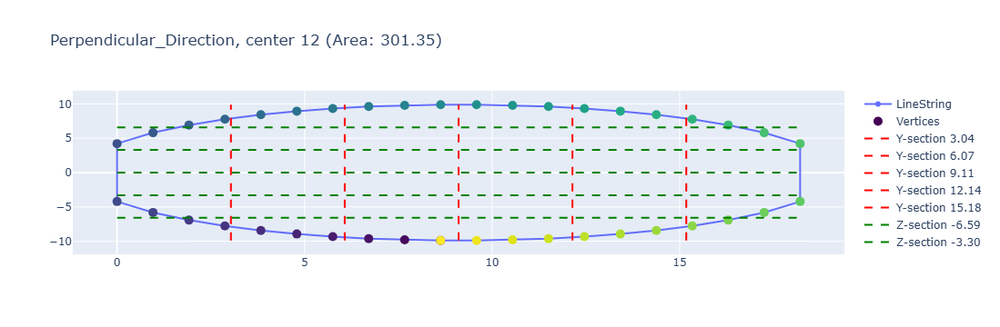


Y-Range at specified Z-values:
z = -6.590216285216403: y-range = 1.630866598528919 to 16.58050392555856
z = -6.590216285216403: horizontal length = 14.949637327029642
z = -3.2951081426082016: y-range = 0.0 to 18.21137079529844
z = -3.2951081426082016: horizontal length = 18.21137079529844
z = 0.0: y-range = 0.0 to 18.21137079529844
z = 0.0: horizontal length = 18.21137079529844
z = 3.2951081426082016: y-range = 0.0 to 18.21137079529844
z = 3.2951081426082016: horizontal length = 18.21137079529844
z = 6.590216285216403: y-range = 1.6308668697398807 to 16.58050419676952
z = 6.590216285216403: horizontal length = 14.94963732702964

Z-Range at specified Y-values:
y = 3.035228465883073: z-range = -7.880622284150879 to 7.880622226169722
y = 3.035228465883073: vertical length = 15.761244510320601
y = 6.070456931766147: z-range = -9.423984687628689 to 9.423984643558276
y = 6.070456931766147: vertical length = 18.847969331186967
y = 9.10568539764922: z-range = -9.885324292422311 to 9.885324292

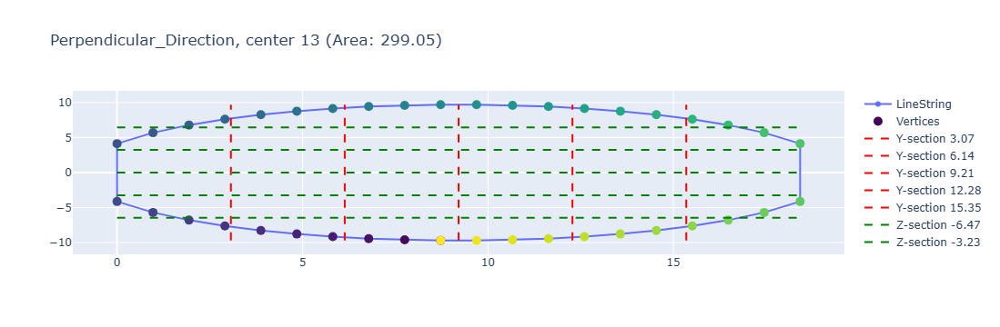


Y-Range at specified Z-values:
z = -6.4669950897537465: y-range = 1.6492798102495412 to 16.76760499215131
z = -6.4669950897537465: horizontal length = 15.118325181901767
z = -3.2334975448768732: y-range = 0.0 to 18.416884270441827
z = -3.2334975448768732: horizontal length = 18.416884270441827
z = 0.0: y-range = 0.0 to 18.416884270441827
z = 0.0: horizontal length = 18.416884270441827
z = 3.233497544876874: y-range = 0.0 to 18.416884270441827
z = 3.233497544876874: horizontal length = 18.416884270441827
z = 6.4669950897537465: y-range = 1.649279278290516 to 16.767604460192285
z = 6.4669950897537465: horizontal length = 15.118325181901769

Z-Range at specified Y-values:
y = 3.0694807117403045: z-range = -7.733193116777389 to 7.733192486302728
y = 3.0694807117403045: vertical length = 15.466385603080116
y = 6.138961423480609: z-range = -9.248215094216203 to 9.248215391004193
y = 6.138961423480609: vertical length = 18.496430485220394
y = 9.208442135220913: z-range = -9.700492353307776 t

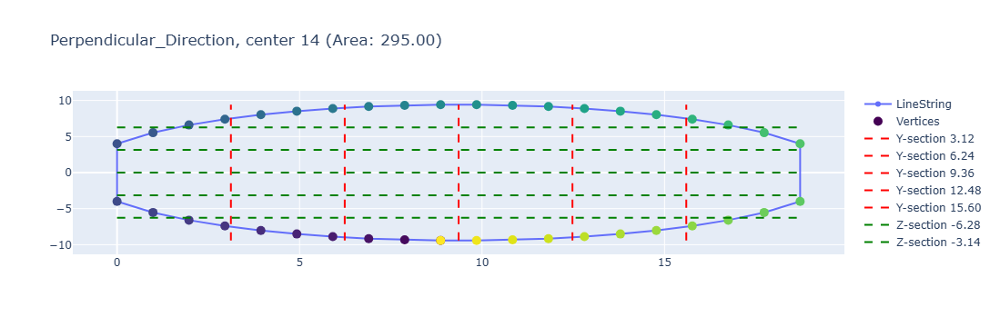


Y-Range at specified Z-values:
z = -6.277795122813911: y-range = 1.6737019863560016 to 17.04078422236564
z = -6.277795122813911: horizontal length = 15.36708223600964
z = -3.1388975614069556: y-range = 0.0 to 18.71448623008408
z = -3.1388975614069556: horizontal length = 18.71448623008408
z = 0.0: y-range = 0.0 to 18.71448623008408
z = 0.0: horizontal length = 18.71448623008408
z = 3.1388975614069548: y-range = 0.0 to 18.71448623008408
z = 3.1388975614069548: horizontal length = 18.71448623008408
z = 6.277795122813911: y-range = 1.6737020077184372 to 17.040784243728076
z = 6.277795122813911: horizontal length = 15.367082236009638

Z-Range at specified Y-values:
y = 3.1190810383473466: z-range = -7.506655336495209 to 7.5066562085702015
y = 3.1190810383473466: vertical length = 15.01331154506541
y = 6.238162076694694: z-range = -8.97875649942793 to 8.9787563900094
y = 6.238162076694694: vertical length = 17.957512889437332
y = 9.35724311504204: z-range = -9.41669252391315 to 9.416692523

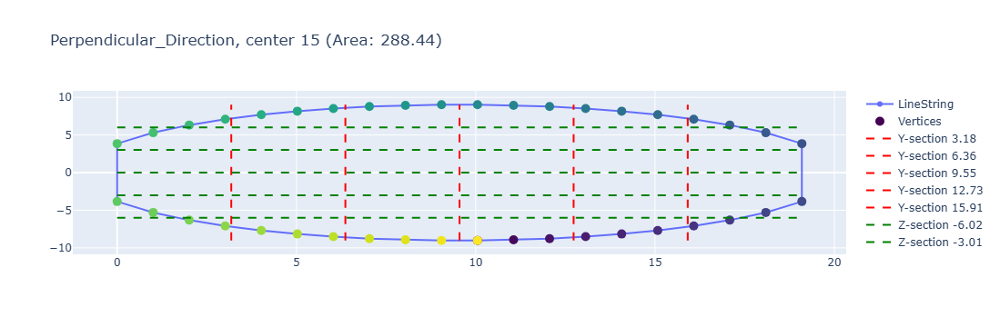


Y-Range at specified Z-values:
z = -6.016620610931097: y-range = 1.7099555066153505 to 17.384245496691506
z = -6.016620610931097: horizontal length = 15.674289990076154
z = -3.0083103054655487: y-range = 0.0 to 19.09420029842135
z = -3.0083103054655487: horizontal length = 19.09420029842135
z = 0.0: y-range = 0.0 to 19.09420029842135
z = 0.0: horizontal length = 19.09420029842135
z = 3.008310305465548: y-range = 0.0 to 19.09420029842135
z = 3.008310305465548: horizontal length = 19.09420029842135
z = 6.016620610931097: y-range = 1.7099548017298423 to 17.384244791805997
z = 6.016620610931097: horizontal length = 15.674289990076154

Z-Range at specified Y-values:
y = 3.1823667164035583: z-range = -7.195082469712948 to 7.195082615633128
y = 3.1823667164035583: vertical length = 14.390165085346077
y = 6.364733432807116: z-range = -8.60356817678482 to 8.60356810844741
y = 6.364733432807116: vertical length = 17.20713628523223
y = 9.547100149210674: z-range = -9.024930913293865 to 9.0249309

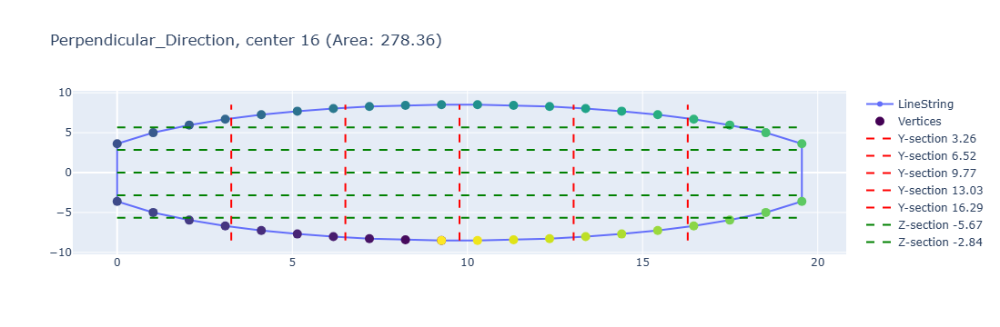


Y-Range at specified Z-values:
z = -5.671488012134276: y-range = 1.7507247375743302 to 17.795133228445454
z = -5.671488012134276: horizontal length = 16.044408490871124
z = -2.835744006067138: y-range = 0.0 to 19.545859758968707
z = -2.835744006067138: horizontal length = 19.545859758968707
z = 0.0: y-range = 0.0 to 19.545859758968707
z = 0.0: horizontal length = 19.545859758968707
z = 2.835744006067138: y-range = 0.0 to 19.545859758968707
z = 2.835744006067138: horizontal length = 19.545859758968707
z = 5.671488012134276: y-range = 1.7507265305232522 to 17.795135021394376
z = 5.671488012134276: horizontal length = 16.044408490871124

Z-Range at specified Y-values:
y = 3.257643293161451: z-range = -6.782106676583802 to 6.782106623881784
y = 3.257643293161451: vertical length = 13.564213300465585
y = 6.515286586322903: z-range = -8.111567596480958 to 8.111567483853642
y = 6.515286586322903: vertical length = 16.2231350803346
y = 9.772929879484353: z-range = -8.507231615225685 to 8.5072

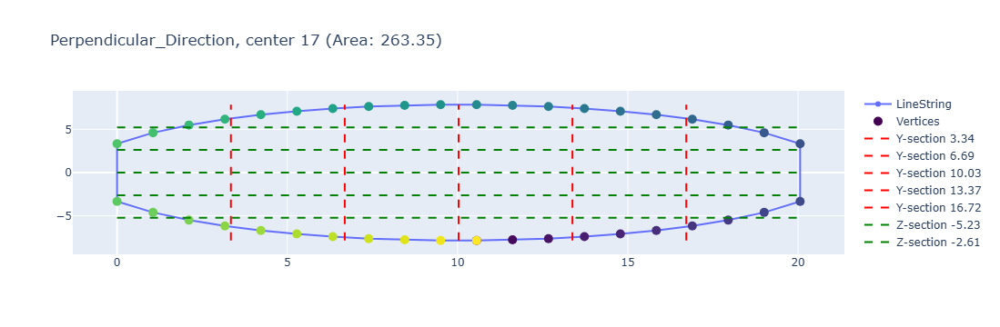


Y-Range at specified Z-values:
z = -5.229909534815661: y-range = 1.7983201167015628 to 18.261690558512452
z = -5.229909534815661: horizontal length = 16.463370441810888
z = -2.6149547674078306: y-range = 0.0 to 20.06001343507679
z = -2.6149547674078306: horizontal length = 20.06001343507679
z = 0.0: y-range = 0.0 to 20.06001343507679
z = 0.0: horizontal length = 20.06001343507679
z = 2.6149547674078306: y-range = 0.0 to 20.06001343507679
z = 2.6149547674078306: horizontal length = 20.06001343507679
z = 5.229909534815661: y-range = 1.798322876564338 to 18.261693318375226
z = 5.229909534815661: horizontal length = 16.463370441810888

Z-Range at specified Y-values:
y = 3.3433355725127982: z-range = -6.252110203994275 to 6.252108424328932
y = 3.3433355725127982: vertical length = 12.504218628323207
y = 6.6866711450255965: z-range = -7.479037389803451 to 7.479036113837029
y = 6.6866711450255965: vertical length = 14.958073503640481
y = 10.030006717538395: z-range = -7.844864170405244 to 7.

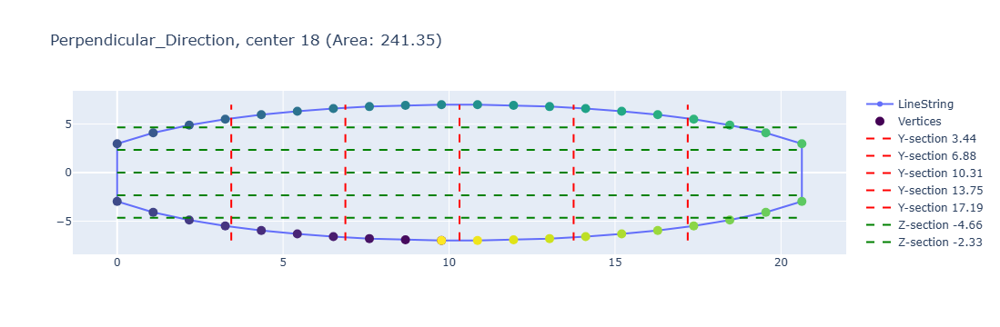


Y-Range at specified Z-values:
z = -4.661808337445386: y-range = 1.8521008179717748 to 18.77621043705076
z = -4.661808337445386: horizontal length = 16.924109619078987
z = -2.330904168722693: y-range = 0.0 to 20.628311451410955
z = -2.330904168722693: horizontal length = 20.628311451410955
z = 0.0: y-range = 0.0 to 20.628311451410955
z = 0.0: horizontal length = 20.628311451410955
z = 2.330904168722693: y-range = 0.0 to 20.628311451410955
z = 2.330904168722693: horizontal length = 20.628311451410955
z = 4.661808337445386: y-range = 1.8521010143601937 to 18.776210633439177
z = 4.661808337445386: horizontal length = 16.924109619078983

Z-Range at specified Y-values:
y = 3.4380519085684926: z-range = -5.573048098839177 to 5.573048124672322
y = 3.4380519085684926: vertical length = 11.146096223511499
y = 6.876103817136984: z-range = -6.664422026219559 to 6.664419822292434
y = 6.876103817136984: vertical length = 13.328841848511992
y = 10.314155725705477: z-range = -6.992712284259332 to 6.

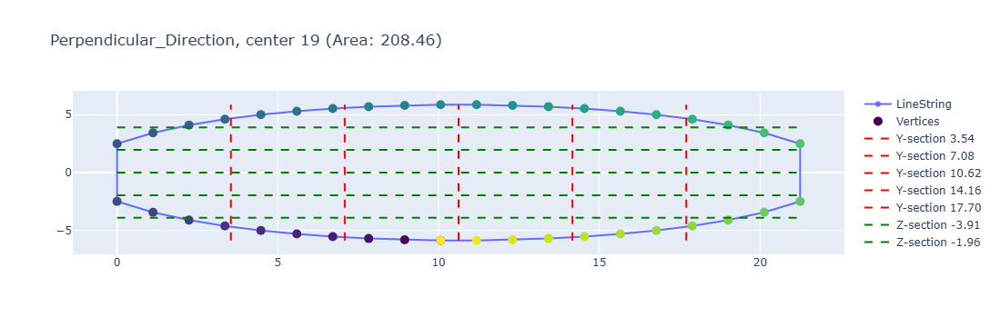


Y-Range at specified Z-values:
z = -3.9111384919051284: y-range = 1.909758559169706 to 19.33381003748314
z = -3.9111384919051284: horizontal length = 17.424051478313434
z = -1.9555692459525642: y-range = 0.0 to 21.243573139689083
z = -1.9555692459525642: horizontal length = 21.243573139689083
z = 0.0: y-range = 0.0 to 21.243573139689083
z = 0.0: horizontal length = 21.243573139689083
z = 1.9555692459525646: y-range = 0.0 to 21.243573139689083
z = 1.9555692459525646: horizontal length = 21.243573139689083
z = 3.9111384919051284: y-range = 1.9097631022059438 to 19.333814580519377
z = 3.9111384919051284: horizontal length = 17.424051478313434

Z-Range at specified Y-values:
y = 3.540595523281514: z-range = -4.674929113069867 to 4.674929566754726
y = 3.540595523281514: vertical length = 9.349858679824592
y = 7.081191046563028: z-range = -5.590627868028524 to 5.590628418866106
y = 7.081191046563028: vertical length = 11.18125628689463
y = 10.621786569844542: z-range = -5.866707252870526 to

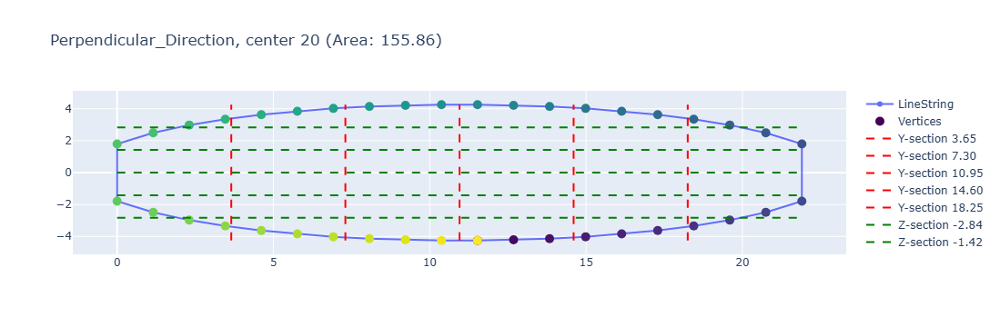


Y-Range at specified Z-values:
z = -2.837244327322212: y-range = 1.969361922061993 to 19.930347959286124
z = -2.837244327322212: horizontal length = 17.96098603722413
z = -1.418622163661106: y-range = 0.0 to 21.899702388032836
z = -1.418622163661106: horizontal length = 21.899702388032836
z = 0.0: y-range = 0.0 to 21.899702388032836
z = 0.0: horizontal length = 21.899702388032836
z = 1.418622163661106: y-range = 0.0 to 21.899702388032836
z = 1.418622163661106: horizontal length = 21.899702388032836
z = 2.837244327322212: y-range = 1.9693544287467126 to 19.930340465970843
z = 2.837244327322212: horizontal length = 17.96098603722413

Z-Range at specified Y-values:
y = 3.6499503980054726: z-range = -3.3908738770343185 to 3.3908762277634
y = 3.6499503980054726: vertical length = 6.781750104797719
y = 7.299900796010945: z-range = -4.060652165694259 to 4.060650992378507
y = 7.299900796010945: vertical length = 8.121303158072767
y = 10.949851194016418: z-range = -4.255866265187275 to 4.25586

In [13]:
"""Dimensional Measurements: measurement of the data in the hoizontal and vertical directions between the intersections of the measurement 
lines with the linestring polygons"""
import os
import numpy as np
from shapely.geometry import LineString
import pandas as pd
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import json

with open('center_points.json', 'r') as f:
    center_points = json.load(f)
center_points = {
    int(k.split('_')[-1]): np.array(v) 
    for k, v in center_points.items() 
    if int(k.split('_')[-1]) != 0  # Skip the entry with index 0
}
with open('rotated_norms.json', 'r') as f:
     rotated_norms = json.load(f)
rotated_norms = {
    int(k.split('_')[-1]): np.array(v)  # Extract the number from the key
    for k, v in rotated_norms.items()
}
with open('horizontal_extents.json', 'r') as f:
    horizontal_extents = json.load(f)
horizontal_extents = {int(k): v for k, v in horizontal_extents.items()}

try:
    with open('min_steps.json', 'r') as f:
        min_steps = json.load(f)
    with open('min_area_dict.json', 'r') as f:
        min_area_dict = json.load(f)
    # Convert keys to integers if they are stored as strings in the JSON files
    min_steps = {int(k): v for k, v in min_steps.items()}   
    min_area_dict = {int(k): v for k, v in min_area_dict.items()}
except FileNotFoundError as e:
    print(f"Error loading dictionaries: {e}")
    min_step_dict = {}
    min_area_dict = {}


def sort_points_by_angle(points, centroid):
    def angle(p):
        return np.arctan2(p[1] - centroid[1], p[0] - centroid[0])
    return sorted(points, key=angle)

# Normalize the vertices
def normalize_values(vertices):
    scaler = MinMaxScaler()
    normalized_vertices = scaler.fit_transform(vertices)
    return normalized_vertices

#function to rotate and project cross section parallel to the YZ plane
def rotate_to_x_axis(vertices, normal):
    normal = normal / np.linalg.norm(normal)  # Normalize the normal vector
    target = np.array([1, 0, 0])  # Target vector along the x-axis

    # Ensure normal is not aligned with the target vector to avoid zero rotation
    if np.allclose(normal, target) or np.allclose(normal, -target):
        return vertices, np.eye(3)  # No rotation needed if already aligned

    # Calculate the rotation needed to align the normal with the x-axis
    rotation_vector = np.cross(normal, target)
    rotation_vector /= np.linalg.norm(rotation_vector)  # Normalize the rotation vector
    angle = np.arccos(np.clip(np.dot(normal, target), -1.0, 1.0))
    
    K = np.array([
        [0, -rotation_vector[2], rotation_vector[1]],
        [rotation_vector[2], 0, -rotation_vector[0]],
        [-rotation_vector[1], rotation_vector[0], 0]
    ])
    rotation_matrix = np.eye(3) + np.sin(angle) * K + (1 - np.cos(angle)) * np.dot(K, K)

    if np.linalg.det(rotation_matrix) < 0:
        rotation_matrix[:, 1] = -rotation_matrix[:, 1]
        
    # Apply the rotation to the vertices
    rotated_vertices = vertices @ rotation_matrix.T 
    return rotated_vertices, rotation_matrix



all_linestrings = combined_linestrings

def determine_section_type(key, num_linestrings):

    try:
        key = int(key)  # Ensure key is an integer
    except ValueError as e:
        print(f"Error converting key to int: {key}. Error: {e}")
        return None  # Return None if conversion fails

    if key < num_linestrings:
        return "Section_dir1"
    else:
        return "Perpendicular_Direction"

    print(f"Section type for key {key}: {section_type}")
    
    return section_type


"""Function redundant for regular geometries"""
def rescale_linestring_coords(linestring, new_min, new_max, dx, dy):
    # Extract the current coordinates of the linestring
    points = np.array(linestring.coords)  # Convert to numpy array for easier manipulation
    
    # Determine if we should work on x or y coordinates based on dx and dy
    if dx >= dy:
        current_min = np.min(points[:, 0])  # Extract x-values (1st column)
        current_max = np.max(points[:, 0])  # X-range
    else:
        current_min = np.min(points[:, 1])  # Extract y-values (2nd column)
        current_max = np.max(points[:, 1])  # Y-range
    
    # Calculate the scaling factor based on the current and new ranges
    scale = (new_max - new_min) / (current_max - current_min)
    
    # Rescale the coordinates
    new_points = []
    for x, y, z in points:
        if dx >= dy:
            new_x = new_min + (x - current_min) * scale  # Scale the x-value
            new_points.append((new_x, y, z))  # Keep y and z unchanged
        else:
            new_y = new_min + (y - current_min) * scale  # Scale the y-value
            new_points.append((x, new_y, z))  # Keep x and z unchanged
    
    # Return a new linestring with the rescaled coordinates
    return LineString(new_points)


def create_rescaling_figure(linestring, section_type, center_index, dx, dy):
    # Set the title based on section_type and center_index
    if "Section_dir1" in section_type:
        title = f"Direction 1, center {center_index}"
    elif "Perpendicular_Direction" in section_type:
        title = f"Perpendicular_Direction, center {center_index}"
    else:
        title = f"Combined Linestrings - Center {center_index}"

    fig = go.Figure()

    coords = np.array(linestring.coords)  
    
    if dx >= dy:
        y = coords[:, 0]  # Use X-values (1st column)
    else:
        y = coords[:, 1]  # Use Y-values (2nd column)
    
    z = coords[:, 2]  # Z-values (3rd column)

    # Convert to lists for plotting
    y = list(y)
    z = list(z)

    # Add line trace for the linestring
    fig.add_trace(go.Scatter(x=y, y=z, mode='lines+markers', name='LineString'))

    # Apply viridis colormap
    cmap = plt.get_cmap('viridis')
    norm = plt.Normalize(vmin=0, vmax=len(y) - 1)
    colors = [cmap(norm(i)) for i in range(len(y))]
    colors = [f'rgba({r*255},{g*255},{b*255},{a})' for r, g, b, a in colors]

    # Add a scatter plot for the vertices with the colormap
    fig.add_trace(go.Scatter(
        x=y, y=z,
        mode='markers',
        marker=dict(color=colors, size=10),
        name='Vertices'
    ))
    x_label = 'X' if dx >= dy else 'Y'
    fig.update_layout(title=title, xaxis_title='Y', yaxis_title='Z')
    return fig

# Define max_Section_dir1_key 
max_Section_dir1_key = max(linestrings_rearranged)  

# Loop through all_linestrings to determine orthogonal (=perpendicular) sections
for idx, (key, linestring) in enumerate(all_linestrings.items()):
    if key in linestrings_rearranged:
        section_type = "Section_dir1"
        center_index = key  # For Direction 1, the center index is the key itself
    elif key > max_Section_dir1_key:  # Keys greater than max_Section_dir1_key belong to Perpendicular sections
        section_type = "Perpendicular_Direction"
        center_index = key - (max_Section_dir1_key + 1)  
    else:
        section_type = "Unknown"
        center_index = key  # Fallback for unknown section types

    # Rescale Perpendicular Sections
    if section_type == "Perpendicular_Direction":  
        # Retrieve the corresponding horizontal extent for this center index
        horizontal_extent = horizontal_extents.get(center_index, None)
        
        if horizontal_extent is not None:
            # Check the condition between dx and dy to rescale either x or y
            if dx >= dy:
                # Rescale the x-values to the range [0, horizontal_extent]
                xmin_section = 0
                xmax_section = horizontal_extent
                rescaled_linestring = rescale_linestring_coords(linestring, xmin_section, xmax_section, dx, dy)
            else:
                # Rescale the y-values to the range [0, horizontal_extent]
                ymin_section = 0
                ymax_section = horizontal_extent
                rescaled_linestring = rescale_linestring_coords(linestring, ymin_section, ymax_section, dx, dy)
            
            # **Save the rescaled linestring back into all_linestrings**
            all_linestrings[key] = rescaled_linestring
       
    else:
        # For "Direction 1", keep the linestring unchanged in all_linestrings
        all_linestrings[key] = linestring


def ensure_continuous_loop_yz(points):
    # Check if the first point is not equal to the last point
    if not np.array_equal(points[0], points[-1]):
        # If they are not equal, append the first point to the end to close the loop
        points = np.vstack([points, points[0]])
    return points

def ensure_continuous_loop(points):
    """
    Ensure that the polygon forms a closed loop.
    """
    first_point = points[0]
    last_point = points[-1]
    
    # Check if the first and last points are the same
    if first_point != last_point:
        points.append(first_point)    
    return points


# Calculate the shoelace area
def shoelace_area(points):
    n = len(points)
    area = 0.0
    for i in range(n):
        j = (i + 1) % n
        area += points[i][0] * points[j][1]
        area -= points[j][0] * points[i][1]
    return abs(area) / 2.0

# Measure polygon line length along horizontal axis at given z value
def measure_polygon_line_length_y(points, y_value):
    min_z_value = float('inf')
    max_z_value = -float('inf')
    
    for i in range(len(points)):
        z1, y1 = points[i]
        z2, y2 = points[(i + 1) % len(points)]
        
        if min(y1, y2) <= y_value <= max(y1, y2):
            z_intersection = z1 + (y_value - y1) * (z2 - z1) / (y2 - y1)
            min_z_value = min(min_z_value, z_intersection)
            max_z_value = max(max_z_value, z_intersection)
                
    return min_z_value, max_z_value

# Measure polygon line length along z at given y value
def measure_polygon_line_length_z(points, z_value):
    min_y_value = float('inf')
    max_y_value = -float('inf')
    
    for i in range(len(points)):
        z1, y1 = points[i]
        z2, y2 = points[(i + 1) % len(points)]
        
        if min(z1, z2) <= z_value <= max(z1, z2):
            y_intersection = y1 + (z_value - z1) * (y2 - y1) / (z2 - z1)
            min_y_value = min(min_y_value, y_intersection)
            max_y_value = max(max_y_value, y_intersection)
                
    return min_y_value, max_y_value



#functions ensuring to create correct title of linestring
def create_title(section_type, center_index):
    if "Section_dir1" in section_type:
        return f"Direction 1, center {center_index}"
    elif "Perpendicular_Direction" in section_type:
        return f"Perpendicular_Direction, center {center_index}"
    else:
        return f"Combined Linestrings - Center {center_index}"  # Default title if not recognized

num_linestrings = len(combined_linestrings)
center_index = key
# Convert to integer if necessary
if isinstance(key, str) and key.startswith('rotated_n_'):
    # Extract the numeric part of the key
    key = int(key.split('_')[-1])
else:
    key = int(key)  # Ensure key is an integer


section_type = determine_section_type(key, num_linestrings)
title = create_title(section_type, key)


# Sanitize the title for use in file names
def sanitize_filename(filename):
    # Remove characters not allowed in filenames
    forbidden_chars = '<>:"/\\|?*'
    return "".join(c for c in filename if c not in forbidden_chars).replace(" ", "_")

#function to create the figures of the linestrings of 1st direction
def create_simple_figure(y_values, z_values, title, area):
    fig = go.Figure()

    if y_values[0] != y_values[-1] or z_values[0] != z_values[-1]:
        y_values.append(y_values[0])
        z_values.append(z_values[0])


    fig.add_trace(go.Scatter(
        y=z_values, x=y_values,
        mode='lines+markers',
        name='LineString',
        line=dict(color='blue')
    ))

    # Apply viridis colormap
    cmap = plt.get_cmap('viridis')
    norm = plt.Normalize(vmin=0, vmax=len(y_values) - 1)
    colors = [cmap(norm(i)) for i in range(len(y_values))]
    colors = [f'rgba({int(r*255)},{int(g*255)},{int(b*255)},{a})' for r, g, b, a in colors]

    # Scatter plot with colormap
    fig.add_trace(go.Scatter(
        y=z_values, x=y_values,
        mode='markers',
        marker=dict(color=colors, size=10),
        name='Vertices'
    ))

    fig.update_layout(
        title=f'{title} (Area: {area:.2f})',
        xaxis_title='Y',
        yaxis_title='Z',
        showlegend=True,
        autosize=True,
        width=800,  
        height=800  
    )
    
    # Set isotropic axis
    fig.update_layout(
        xaxis=dict(scaleanchor='y', constrain='domain'),
        yaxis=dict(constrain='domain')
    )

    return fig

#function to create the figures of the linestrings of orthogonal direction
def create_simple_figure_perp(linestring, title, area):
    fig = go.Figure()

    coords = np.array(linestring.coords)  

    if dx < dy:
            # Plot in the YZ plane
        y = list(coords[:, 1])  # Y-values (second column)
        z = list(coords[:, 2])  # Z-values (third column)
    else:
            # Plot in the XZ plane
        y = list(coords[:, 0])  # X-values (first column)
        z = list(coords[:, 2])  # Z-values (third column)    
    

    if (y[0], z[0]) != (y[-1], z[-1]):
        y.append(y[0])
        z.append(z[0])

    # Convert to lists for plotting
    y = list(y)
    z = list(z)

    fig.add_trace(go.Scatter(x=y, y=z, mode='lines+markers', name='LineString'))

    # Apply viridis colormap
    cmap = plt.get_cmap('viridis')
    norm = plt.Normalize(vmin=0, vmax=(len(y)) - 1)
    colors = [cmap(norm(i)) for i in range(len(y))]
    colors = [f'rgba({r*255},{g*255},{b*255},{a})' for r, g, b, a in colors]

    # Scatter plot with colormap
    fig.add_trace(go.Scatter(
        x=y, y=z,
        mode='markers',
        marker=dict(color=colors, size=10),
        name='Vertices'
    ))

    fig.update_layout(title=f'{title} (Area: {area:.2f})')
    return fig

#function defining how measurements and plotting is conducted for sections of 1st direction
def calculate_and_plot_results_Section_dir1(yz_projections,  dataset_name):
    base_dir = r'C:\Users\carl\Desktop\Structural dimensions\Raw data\standard models'
    dataset_dir = os.path.join(base_dir, dataset_name)

    # Create dataset directory if it does not exist
    if not os.path.exists(dataset_dir):
        os.makedirs(dataset_dir)

    # Create subdirectories for 1st and 2nd direction
    first_direction_dir = os.path.join(dataset_dir, '1st direction')
    second_direction_dir = os.path.join(dataset_dir, '2nd direction')

    if not os.path.exists(first_direction_dir):
        os.makedirs(first_direction_dir)

    if not os.path.exists(second_direction_dir):
        os.makedirs(second_direction_dir)

    for idx, sorted_points in yz_projections.items():

        ys, zs = zip(*sorted_points)  # Extract Y and Z values
        section_type = "Section_dir1"  
        center_index = idx 

        # Skip marginal sections (index 0 & 21) to avoid artifacts in dimensional measurements --> ending up with 20 sections
        if (section_type == "Section_dir1" and center_index in [0, 21]) or (section_type == "Perpendicular_Direction" and center_index in [0, 21]):
            continue
        
        # Generate title
        title = create_title(section_type, center_index)
    
        area = shoelace_area(sorted_points)
        print(f"Calculated area for line {idx}: {area}")
        
        # Extract y and z values
        z_values = [point[1] for point in sorted_points]
        y_values = [point[0] for point in sorted_points]

        fig = create_simple_figure(ys, zs,  title, area)

        ymin_section = np.min(y_values)
        ymax_section = np.max(y_values)
        zmin_section = np.min(z_values)
        zmax_section = np.max(z_values)

        # Definition of number of measurements per dimension
        num_intervals = 5

        # Calculating the interval length
        dy_section = (ymax_section - ymin_section) / (num_intervals + 1)
        dz_section = (zmax_section - zmin_section) / (num_intervals + 1)
        
        # Measuring lengths and plot the results
        y_values_section = np.linspace(ymin_section + dy_section, ymax_section - dy_section, num_intervals)
        z_values_section = np.linspace(zmin_section + dz_section, zmax_section - dz_section, num_intervals)

        # Add vertical and horizontal lines
        for y_section in y_values_section:
            fig.add_trace(go.Scatter(
                x=[y_section, y_section],
                y=[zmin_section, zmax_section],
                mode='lines',
                line=dict(color='red', width=2, dash='dash'),
                name=f'Y-section {y_section:.2f}'
            ))
        
        for z_section in z_values_section:
            fig.add_trace(go.Scatter(
                x=[ymin_section, ymax_section],
                y=[z_section, z_section],
                mode='lines',
                line=dict(color='green', width=2, dash='dash'),
                name=f'Z-section {z_section:.2f}'
            ))

        fig.show()
    
        # Measure polygon line lengths
        z_lengths = []
        y_lengths = []
    
        print("\nY-Range at specified Z-values:")
        for z_val in z_values_section:
            extent = measure_polygon_line_length_y(sorted_points, z_val)
            length = extent[1] - extent[0]
            y_lengths.append(length)
            print(f"z = {z_val}: y-range = {extent[0]} to {extent[1]}")
            print(f"z = {z_val}: horizontal length = {length}")
        
        print("\nZ-Range at specified Y-values:")
        for y_val in y_values_section:
            extent = measure_polygon_line_length_z(sorted_points, y_val)
            length = extent[1] - extent[0]
            z_lengths.append(length)
            print(f"y = {y_val}: z-range = {extent[0]} to {extent[1]}")
            print(f"y = {y_val}: vertical length = {length}")
        
        # Create DataFrame to save results
        results_df = pd.DataFrame({
            'Z Value': z_values_section,
            'Horizontal Length': y_lengths,
            'Y Value': y_values_section,
            'Vertical Length': z_lengths
        })

        results_df['Area'] = [area] + [None] * (len(results_df) - 1)
    
        # Determine filename and path based on the section type
        filename_dim = f'{sanitize_filename(title)}_dimensions.csv'
        if section_type == "Section_dir1":
            file_path_dim = os.path.join(first_direction_dir, filename_dim)
        elif section_type == "Perpendicular_Direction":
            file_path_dim = os.path.join(second_direction_dir, filename_dim)
        else:
            continue
    
        # Save results to CSV
        results_df.to_csv(file_path_dim, index=False)
    
        print(f"Dimensions saved to '{file_path_dim}'")

"""function defining how measurements and plotting is conducted for sections of orthogonal direction"""
def calculate_and_plot_results_Perpendicular_Direction(all_linestrings,  dataset_name):
    base_dir = r'C:\Users\carl\Desktop\Structural dimensions\Raw data\standard models'
    dataset_dir = os.path.join(base_dir, dataset_name)

    # Create dataset directory if it does not exist
    if not os.path.exists(dataset_dir):
        os.makedirs(dataset_dir)

    # Create subdirectories for 1st and 2nd direction
    first_direction_dir = os.path.join(dataset_dir, '1st direction')
    second_direction_dir = os.path.join(dataset_dir, '2nd direction')

    if not os.path.exists(first_direction_dir):
        os.makedirs(first_direction_dir)

    if not os.path.exists(second_direction_dir):
        os.makedirs(second_direction_dir)


    for idx, linestring in all_linestrings.items():
        # Calculate the relative index for Perpendicular sections by adjusting the offset by -1
        relative_index = idx - len(linestrings_rearranged) - 1

        # Check if this relative index corresponds to a Perpendicular_Direction
        if relative_index in perpendicular_linestrings_rearranged:
            section_type = "Perpendicular_Direction"
            center_index = relative_index
        else:
            continue  # Skip if not a Perpendicular section

        # Skip marginal sections (index 0 & 21) to avoid artifacts in dimensional measurements --> ending up with 20 sections
        if center_index in [0, 21]:
            continue
        
        # Generate title
        title = create_title(section_type, center_index)
        
        points = list(linestring.coords)

        if dx < dy:
            yz_points = [(y, z) for (x, y, z) in points]
        
            # Calculate area
            sorted_points = ensure_continuous_loop(yz_points)
            area = shoelace_area(sorted_points)
            
            # Extract y and z values
            ys, zs = zip(*sorted_points)  # Create lists of y and z values
            y_values = [point[0] for point in sorted_points]
            z_values = [point[1] for point in sorted_points]
        
        else:
            xz_points = [(x, z) for (x, y, z) in points]
        
            # Calculate area
            sorted_points = ensure_continuous_loop(xz_points)
            area = shoelace_area(sorted_points)
            
            # Extract x and z values
            xs, zs = zip(*sorted_points)  # Create lists of x and z values
            y_values = [point[0] for point in sorted_points]  
            z_values = [point[1] for point in sorted_points]  

        fig = create_simple_figure_perp(linestring, title, area)
   
        ymin_section = np.min(y_values)
        ymax_section = np.max(y_values)
        zmin_section = np.min(z_values)
        zmax_section = np.max(z_values)

        #Definition of number of measurements per dimension
        num_intervals = 5

        # Calculate the interval length
        dy_section = (ymax_section - ymin_section) / (num_intervals + 1)
        dz_section = (zmax_section - zmin_section) / (num_intervals + 1)
        
        # Measure lengths and plot the results
        y_values_section = np.linspace(ymin_section + dy_section, ymax_section - dy_section, num_intervals)
        z_values_section = np.linspace(zmin_section + dz_section, zmax_section - dz_section, num_intervals)

         # Add vertical and horizontal lines
        for y_section in y_values_section:
            fig.add_trace(go.Scatter(
                x=[y_section, y_section],
                y=[zmin_section, zmax_section],
                mode='lines',
                line=dict(color='red', width=2, dash='dash'),
                name=f'Y-section {y_section:.2f}'
            ))
        
        for z_section in z_values_section:
            fig.add_trace(go.Scatter(
                x=[ymin_section, ymax_section],
                y=[z_section, z_section],
                mode='lines',
                line=dict(color='green', width=2, dash='dash'),
                name=f'Z-section {z_section:.2f}'
            ))

        fig.show() 
    
        # Measure polygon line lengths
        z_lengths = []
        y_lengths = []
    
        print("\nY-Range at specified Z-values:")
        for z_val in z_values_section:   
            extent = measure_polygon_line_length_y(sorted_points, z_val)
            length = extent[1] - extent[0]
            y_lengths.append(length)
            print(f"z = {z_val}: y-range = {extent[0]} to {extent[1]}")
            print(f"z = {z_val}: horizontal length = {length}")
        
        print("\nZ-Range at specified Y-values:")
        for y_val in y_values_section:
            extent = measure_polygon_line_length_z(sorted_points, y_val)
            length = extent[1] - extent[0]
            z_lengths.append(length)
            print(f"y = {y_val}: z-range = {extent[0]} to {extent[1]}")
            print(f"y = {y_val}: vertical length = {length}")
        
        # Create DataFrame to save data
        results_df = pd.DataFrame({
            'Z Value': z_values_section,
            'Horizontal Length': y_lengths,
            'Y Value': y_values_section,
            'Vertical Length': z_lengths
        })

        results_df['Area'] = [area] + [None] * (len(results_df) - 1)
    
        # Determine filename and path based on the section type
        filename_dim = f'{sanitize_filename(title)}_dimensions.csv'
        if section_type == "Section_dir1":
            file_path_dim = os.path.join(first_direction_dir, filename_dim)
        elif section_type == "Perpendicular_Direction":
            file_path_dim = os.path.join(second_direction_dir, filename_dim)
        else:
            continue
    
        # Save results to CSV
        results_df.to_csv(file_path_dim, index=False)
    
        print(f"Dimensions saved to '{file_path_dim}'")




"""------------------------------------------code block to set up measurements on the sections of 1st direction--------------------------------------"""
Section_dir1_linestrings = {}

for idx, linestring in all_linestrings.items():
    section_type = determine_section_type(idx, num_linestrings)  # Determine the section type
    if section_type == "Section_dir1":
        Section_dir1_linestrings[idx] = linestring  # Only keep linestrings of type Direction 1

num_Section_dir1_linestrings = len(Section_dir1_linestrings)

yz_projections = {}

for idx, linestring in Section_dir1_linestrings.items():
    try:
        center = center_points[idx]  # Get the unique center point for the current idx
    except KeyError:
       
        continue  # Skip this iteration if the center point does not exist

    key = int(idx)  # Ensure key is an integer (if idx is not guaranteed to be one)
    
    # Access rotated normals using integer key directly
    if key in rotated_norms:  
        rotated_n = rotated_norms[key]  # Get the rotated normal vector for this section
    else:
        continue  

    # Get points from the linestring
    points = np.array(linestring.coords)  # Extract points as NumPy array

    # Ensure the dimensionality of points and center matches
    if points.shape[1] != center.shape[0]:
        print(f"Dimensionality mismatch: Points shape {points.shape}, Center shape {center.shape} for idx {idx}")
        continue  # Skip this linestring if there's a dimensionality mismatch

    # Step 1: Centering the points
    vertices_centered = points - center
    
    # Step 2: Rotate the vertices to align normal of section with the X-axis
    rotated_vertices, _ = rotate_to_x_axis(vertices_centered, rotated_n)
    rotated_vertices += center
    
    # Step 3: Define YZ projection
    yz_projection = rotated_vertices[:, 1:3]  # Y on X-axis, Z on Y-axis

    # Ensure all points are sorted and form a loop
    sorted_points = ensure_continuous_loop_yz(yz_projection)  

    ys, zs = zip(*sorted_points)  

    yz_projections[idx] = sorted_points 


# run the measurement functions
calculate_and_plot_results_Section_dir1(yz_projections, "sphere_model")
calculate_and_plot_results_Perpendicular_Direction(all_linestrings, "sphere_model")


In [15]:
"""Calculation of gradients and curvatures on the consective vertices of the cross sections"""

import numpy as np
import csv
import json
from shapely.geometry import LineString

# Function to compute gradients (either y and z or x and z coordinates)
def compute_gradients(coords, use_x=False):
    gradients = []
    for i in range(len(coords) - 1):
        if use_x:
            x1, z1 = coords[i][0], coords[i][2]  # Use x and z
            x2, z2 = coords[i + 1][0], coords[i + 1][2]
            gradient = (z2 - z1) / (x2 - x1) if x2 != x1 else np.inf
        else:
            y1, z1 = coords[i][1], coords[i][2]  # Use y and z
            y2, z2 = coords[i + 1][1], coords[i + 1][2]
            gradient = (z2 - z1) / (y2 - y1) if y2 != y1 else np.inf
        
        gradients.append(gradient)
    return gradients

# Function to compute curvatures (either y and z or x and z coordinates)
def compute_curvatures(coords, use_x=False):
    curvatures = []
    for i in range(1, len(coords) - 1):
        if use_x:
            x0, z0 = coords[i - 1][0], coords[i - 1][2]
            x1, z1 = coords[i][0], coords[i][2]
            x2, z2 = coords[i + 1][0], coords[i + 1][2]

            # Lengths of the sides of the triangle (2D with x and z)
            a = np.sqrt((x1 - x0)**2 + (z1 - z0)**2)
            b = np.sqrt((x2 - x1)**2 + (z2 - z1)**2)
            c = np.sqrt((x2 - x0)**2 + (z2 - z0)**2)
        else:
            y0, z0 = coords[i - 1][1], coords[i - 1][2]
            y1, z1 = coords[i][1], coords[i][2]
            y2, z2 = coords[i + 1][1], coords[i + 1][2]

            # Lengths of the sides of the triangle (2D with y and z)
            a = np.sqrt((y1 - y0)**2 + (z1 - z0)**2)
            b = np.sqrt((y2 - y1)**2 + (z2 - z1)**2)
            c = np.sqrt((y2 - y0)**2 + (z2 - z0)**2)

        # Semiperimeter
        s = (a + b + c) / 2

        # Area of the triangle using Heron's formula (2D)
        area = np.sqrt(s * (s - a) * (s - b) * (s - c))

        # Curvature (2D)
        curvature = (4 * area) / (a * b * c) if a * b * c != 0 else np.inf
        curvatures.append(curvature)
    return curvatures

# Function to determine the slice type and center index
#def determine_slice_type_and_index(key, num_linestrings):
 #   if key < num_linestrings:
  #      slice_type = "Slice 1"
   #     center_index = key
#    else:
 #       slice_type = "Perpendicular Slice"
  #      center_index = key - num_linestrings + 1  # Adjust to start from 1 for Perpendicular Slices
   # return slice_type, center_index


# Define the path to the CSV file
csv_file_path = r"C:\Users\carl\Desktop\Structural dimensions\Gradient & Curvature\Gradient & curvature data raw data\sphere_model.csv"

# Load min_steps from JSON
with open('min_steps.json', 'r') as f:
    min_steps = json.load(f)
    min_steps = {int(k): v for k, v in min_steps.items()} 

# List to hold all the data
data_rows = []

max_slice_1_key = max(linestrings_rearranged)  # Assuming max_slice_1_key is derived from your "Slice 1"
for idx, (key, linestring) in enumerate(all_linestrings.items()):
    coords = np.array(linestring.coords)
    #print(f"Coordinates for slice {key}:")
    #print(coords)

    # Determine slice type and center index
    if key in linestrings_rearranged:
        slice_type = "Slice 1"
        center_index = key  # For Slice 1, the center index is the key itself
    elif key > max_slice_1_key:  # Keys greater than max_slice_1_key belong to Perpendicular Slices
        slice_type = "Perpendicular Slice"
        center_index = key - (max_slice_1_key + 1)  # Adjust the index to start from 0 for Perpendicular Slices
    else:
        slice_type = "Unknown"
        center_index = key  # Fallback for unknown slice types
    
    # Skip specific slice centers
    if center_index in [0, 21]: 
        continue
    
    # Check if it's a Perpendicular Slice, then choose whether to use x or y
    use_x = False  # Default: use y-coordinates
    
#    if slice_type == "Slice 1" and key in min_steps:
 #       min_step = min_steps[key]
  #      if dx < dy and min_step == 0:
   #         use_x = True  # Use x-z if dx < dy and min_step is 0
    #    elif dx >= dy and min_step == 90:
     #       use_x = True  # Use x-z if dx >= dy and min_step is 90

    # Implement logic for Perpendicular Slice
    if slice_type == "Perpendicular Slice":
        use_x = True  # Use x-coordinates if dx >= dy
    
    # Compute gradients (either using x and z or y and z)
    gradients = compute_gradients(coords, use_x=use_x)
    print(f"{slice_type} Center {center_index} Gradients ({'x-z' if use_x else 'y-z'}): {gradients}")
    #print(f"Slice {slice_type} Center {center_index} coordinates: {coords}")

    print()
    
    # Compute curvatures (either using x and z or y and z)
    curvatures = compute_curvatures(coords, use_x=use_x)
    print(f"{slice_type} Center {center_index} Curvatures ({'x-z' if use_x else 'y-z'}): {curvatures}")
    print()
    
    # Collect data
    for gradient, curvature in zip(gradients, curvatures):
        data_rows.append([f"{slice_type} Center {center_index}", gradient, curvature])

# Write data to CSV
with open(csv_file_path, mode='w', newline='') as file:
    writer = csv.writer(file)
    
    # Write header
    writer.writerow(["Description", "Gradients", "Curvatures"])
    
    # Write data rows
    writer.writerows(data_rows)

print(f"Data saved to {csv_file_path}")



Slice 1 Center 1 Gradients (y-z): [-0.06602140783447595, -0.06602551657681462, -0.1978017568892578, -0.19782851855539094, -0.21515384419245914, -0.21513999308676116, -0.3576033679583507, -0.3576076698603525, -0.4987083870726556, -0.4986799713620906, -0.5451966002441945, -0.5451431578929554, -0.6972284535784066, -0.697255223269152, -0.7669142136411359, -0.7669100516503852, -0.849931014753605, -0.8498605892639483, -1.0318378185946715, -1.0318957310265946, -1.1541914218027114, -1.1541705676341065, -1.3060904800399837, -1.3061175858616827, -1.5005556855404774, -1.500743809949713, -1.7595716832764787, -1.7590427208499582, -2.0614110901614233, -2.0615233072810253, -2.4829352786247267, -2.4836664233293484, -3.113775411710548, -3.113130576616052, -4.161461345671872, -4.161735881176985, -6.252737656943264, -6.252083529399463, -12.521396720368239, -12.515722131216398, -14.310329725942074, -14.265473300970873, inf, inf, 14.308935576342789, 12.515921961745756, 6.251731213131572, 6.252164671390179,